# Choropleth of Foreign Born Percent Change Around Station Area w/ 10-minute Walkshed Isochrone

In [415]:
# Let's start by importing all of the libraries we'll need for our analyses

import pandas as pd

import geopandas as gpd

from shapely.geometry import Point

import contextily as ctx

import matplotlib.pyplot as plt

# for interactive plots
import plotly.express as px

# for network analysis
import networkx as nx

# for street network analysis
import osmnx as ox

We import the final clean dataset with our merged 2011 and 2019 data. 

In [416]:
gdf = gpd.read_file('acs_11_19_merged_stn+rgn-copy.geojson')

Now just as we did for East LA Civic Center in our "Next Stop Notebook", we create an isochrone of the station walkshed, a red marker indicating the station, a choropleth of the percent change in foreign born populations around the station walkshed - then finally, layer all them over one another for our final station map. 

### Percentage of Foreign Born Population in Metro L Line Del Mar Station Walkshed

Using 2011 and 2019 ACS 5 Year data, we will be creating a choropleth map of the census tracts showing the percentage change of foreign born populations within a 10 minute walk from the Del Mar Station. We will overlay this data with a isochrone map of the walkshed (10 minute walking distance) around Del Mar Station. First, we create the isochrone walkshed map for the Del Mar Station.

In [417]:
# Let's start by orienting ourselves around the Del Mar Station by calling for it by address in osmnx

address = 'Del Mar, South Raymond Avenue, Old Pasadena, Pasadena, Los Angeles County, California, 91105, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [418]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.92 s, sys: 33.3 ms, total: 2.96 s
Wall time: 2.97 s


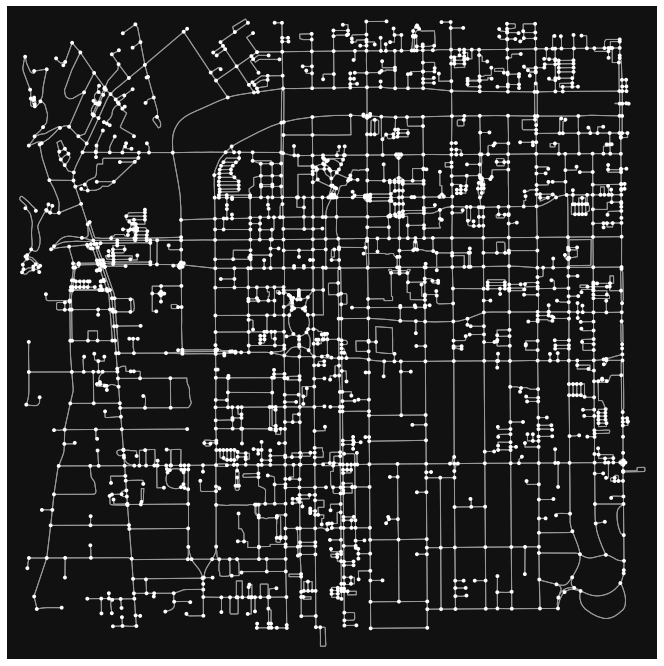

In [419]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [420]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [421]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [422]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14963716,4.049279e+06,-1.315043e+07,traffic_signals,4,-118.132316,34.152361,POINT (-13150429.308 4049278.739)
6784510760,4.049278e+06,-1.315040e+07,NaN,3,-118.132087,34.152358,POINT (-13150403.793 4049278.403)
3892769467,4.049279e+06,-1.315045e+07,traffic_signals,4,-118.132468,34.152362,POINT (-13150446.139 4049278.941)
1995207967,4.049204e+06,-1.315043e+07,NaN,4,-118.132311,34.151805,POINT (-13150428.729 4049204.015)
6784510757,4.049306e+06,-1.315043e+07,NaN,3,-118.132316,34.152564,POINT (-13150429.308 4049306.141)


<AxesSubplot:>

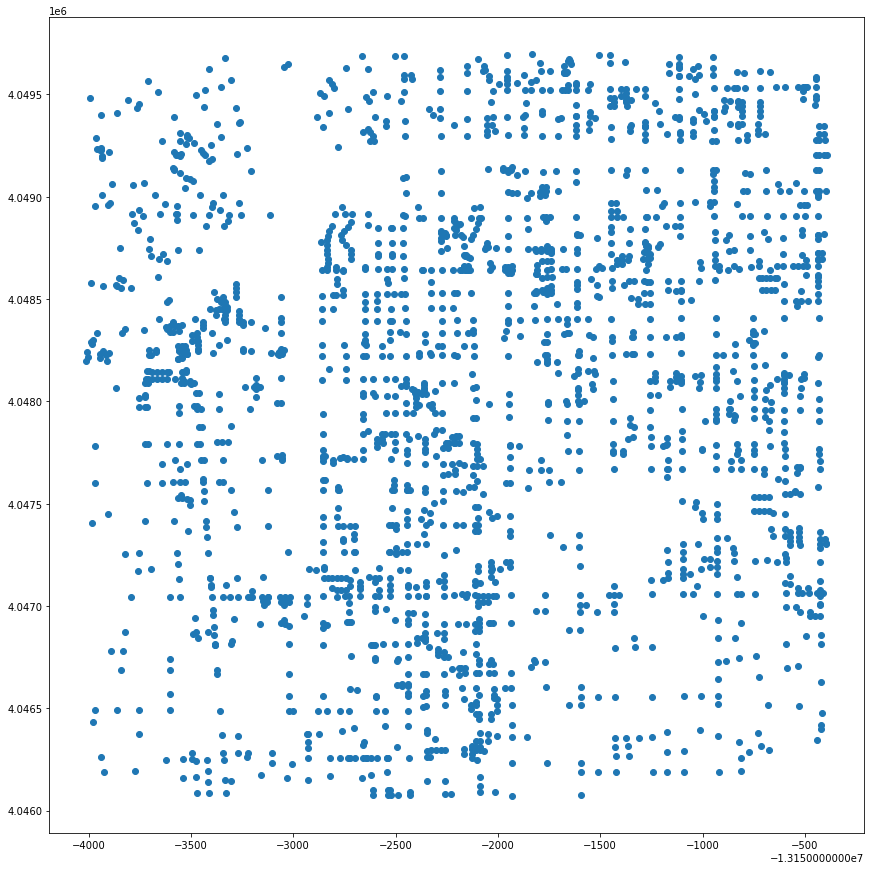

In [423]:
gdf_nodes.plot(figsize=(15,15))

In [424]:
gdf_edges.head()

osmid  oneway               name  \
u          v          key                                                      
14963716   6784510760 0                 405328940   False       Maple Street   
           3892769467 0                 607802969   False       Maple Street   
           1995207967 0    [173415946, 173415947]   False  North Lake Avenue   
           6784510757 0                 385937988   False  North Lake Avenue   
6784510760 14963716   0                 405328940   False       Maple Street   

                             highway  length  \
u          v          key                      
14963716   6784510760 0      primary  21.093   
           3892769467 0      primary  13.914   
           1995207967 0    secondary  61.772   
           6784510757 0    secondary  22.659   
6784510760 14963716   0      primary  21.093   

                                                                    geometry  \
u          v          key                                                      
14963716   6784510760 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           3892769467 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           1995207967 0    LINESTRING (-13150429.308 4049278.739, -131504...   
           6784510757 0    LINESTRING (-13150429.308 4049278.739, -131504...   
6784510760 14963716   0    LINESTRING (-13150403.793 4049278.403, -131504...   

                          maxspeed bridge lanes access service  ref tunnel  \
u          v          key                                                    
14963716   6784510760 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           3892769467 0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   
           1995207967 0     35 mph    yes   NaN    NaN     NaN  NaN    NaN   
           6784510757 0     35 mph    NaN     2    NaN     NaN  NaN    NaN   
6784510760 14963716   0        NaN    NaN   NaN    NaN     NaN  NaN    NaN   

                          width  
u          v          key        
14963716   6784510760 0     NaN  
           3892769467 0     NaN  
           1995207967 0     NaN  
           6784510757 0     NaN  
6784510760 14963716   0     NaN

<AxesSubplot:>

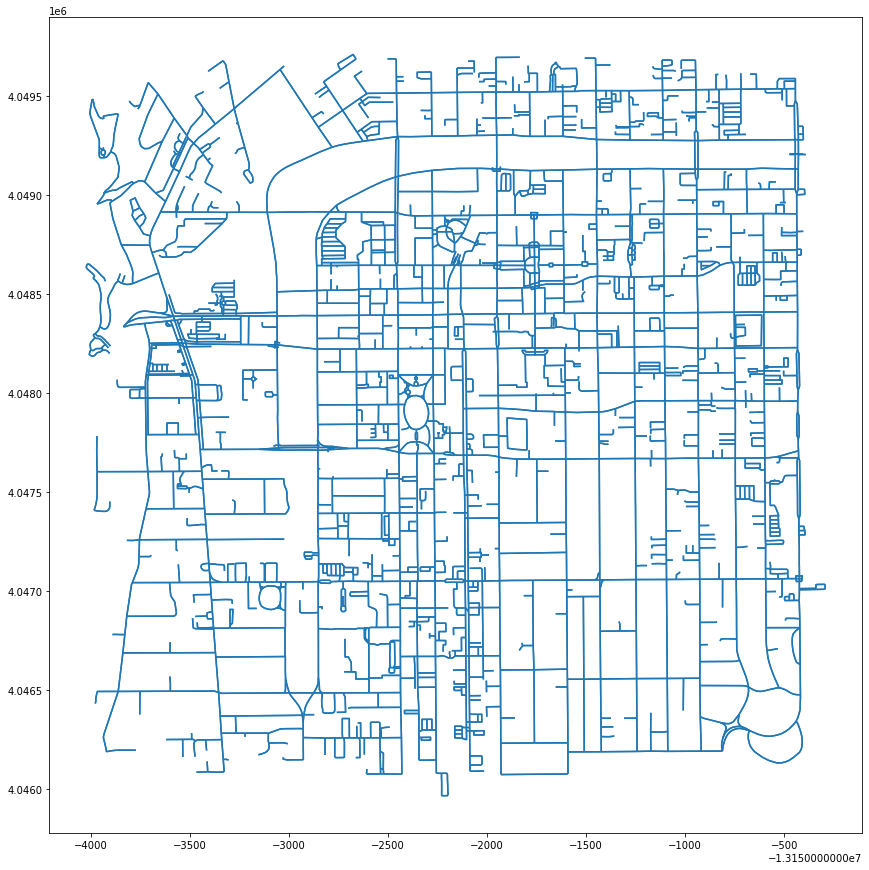

In [425]:
gdf_edges.plot(figsize=(15,15))

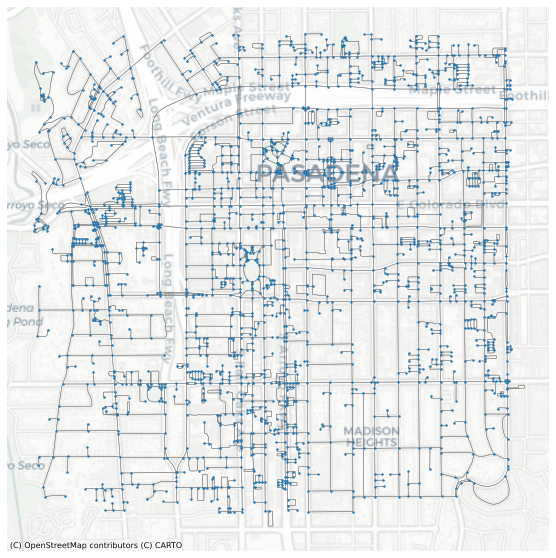

In [426]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [427]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13154010.901174664
4046072.998110596
-13150391.069632793
4049695.185661036


In [428]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13152200.985403728
4047884.0918858163


In [429]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node))

The id for the nearest node is 1995241213


In [430]:
# what is this record?
gdf_nodes.loc[[center_node]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995241213,4.047831e+06,-1.315221e+07,NaN,1,-118.148271,34.141596,POINT (-13152205.321 4047830.780)


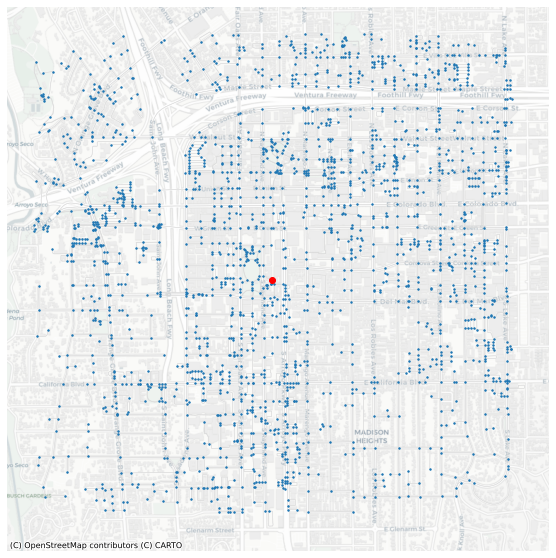

In [431]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [432]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width
u,v,key,,,,,,,,,,,,,,
4367237127,4367237096,0,439094746,False,NaN,service,30.870,"LINESTRING (-13152723.347 4046592.235, -131526...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6726060249,6726060252,0,715692067,False,NaN,service,42.218,"LINESTRING (-13151106.720 4048488.585, -131510...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4367176278,4367176269,0,439090750,False,NaN,footway,17.551,"LINESTRING (-13151663.229 4048401.505, -131516...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9000205688,9000205682,1,972443319,False,NaN,service,165.308,"LINESTRING (-13152600.071 4046975.498, -131526...",NaN,NaN,NaN,customers,NaN,NaN,building_passage,NaN
442803876,442804168,0,37751465,False,NaN,footway,46.279,"LINESTRING (-13151613.458 4048645.692, -131516...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [433]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [434]:
gdf_edges.sample(5)

,,,osmid,oneway,name,highway,length,geometry,maxspeed,bridge,lanes,access,service,ref,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,,
6731336052,6731336051,0,716602057,False,NaN,service,29.390,"LINESTRING (-13152423.385 4049596.877, -131524...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.367375
6458100490,20827771,0,167077296,False,Bellefontaine Street,residential,87.900,"LINESTRING (-13153969.802 4046492.595, -131538...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.098750
122899903,280557169,0,25729143,False,East Bellevue Drive,residential,47.361,"LINESTRING (-13152113.783 4047394.698, -131521...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.592012
4367197852,122596240,0,"[405328914, 561836203]",False,East Colorado Boulevard,primary,41.488,"LINESTRING (-13151708.603 4048401.128, -131517...",NaN,NaN,"[4, 5]",NaN,NaN,US 66 HISTORIC,NaN,NaN,0.518600
3769096082,4367236179,0,203028884,False,South Fair Oaks Avenue,primary,29.956,"LINESTRING (-13152438.346 4046609.947, -131524...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.374450


In [435]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [436]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [437]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 1995241213, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 179 nodes within 10 minutes 


In [438]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1687098872,4.049571e+06,-1.315330e+07,NaN,3,-118.158140,34.154536,POINT (-13153304.022 4049571.332),NaN,NaN
122897401,4.049303e+06,-1.315187e+07,NaN,3,-118.145272,34.152539,POINT (-13151871.463 4049302.737),NaN,NaN
6726656562,4.048332e+06,-1.315075e+07,NaN,3,-118.135217,34.145319,POINT (-13150752.190 4048331.615),NaN,NaN
122790546,4.048329e+06,-1.315265e+07,NaN,3,-118.152241,34.145303,POINT (-13152647.282 4048329.396),NaN,NaN
2028699256,4.047989e+06,-1.315232e+07,NaN,3,-118.149313,34.142772,POINT (-13152321.383 4047988.993),10 mins,#0d0887
8265630551,4.047842e+06,-1.315256e+07,NaN,3,-118.151501,34.141682,POINT (-13152564.883 4047842.306),NaN,NaN
3892769467,4.049279e+06,-1.315045e+07,traffic_signals,4,-118.132468,34.152362,POINT (-13150446.139 4049278.941),NaN,NaN
5547461843,4.049044e+06,-1.315353e+07,NaN,1,-118.160155,34.150613,POINT (-13153528.309 4049043.686),NaN,NaN
5549289856,4.047179e+06,-1.315285e+07,NaN,3,-118.154075,34.136748,POINT (-13152851.442 4047178.741),NaN,NaN


In [439]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [440]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
181296152,4.047708e+06,-1.315043e+07,traffic_signals,4,-118.132308,34.140682,POINT (-13150428.395 4047707.860),NaN,#cccccc
3627430150,4.047103e+06,-1.315253e+07,NaN,3,-118.151181,34.136181,POINT (-13152529.272 4047102.525),NaN,#cccccc
1841546113,4.046335e+06,-1.315082e+07,NaN,3,-118.135840,34.130477,POINT (-13150821.564 4046335.424),NaN,#cccccc
7958581366,4.048232e+06,-1.315394e+07,NaN,3,-118.163886,34.144577,POINT (-13153943.631 4048231.691),NaN,#cccccc
8265630556,4.047818e+06,-1.315259e+07,NaN,1,-118.151718,34.141503,POINT (-13152589.084 4047818.244),NaN,#cccccc


<AxesSubplot:>

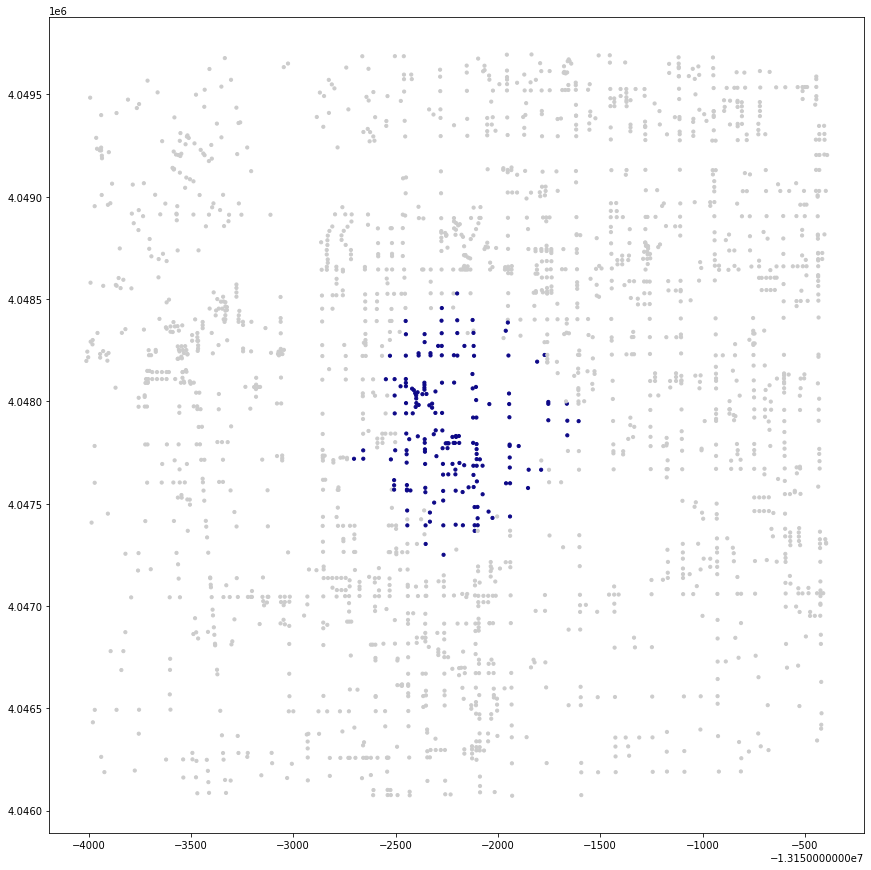

In [441]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

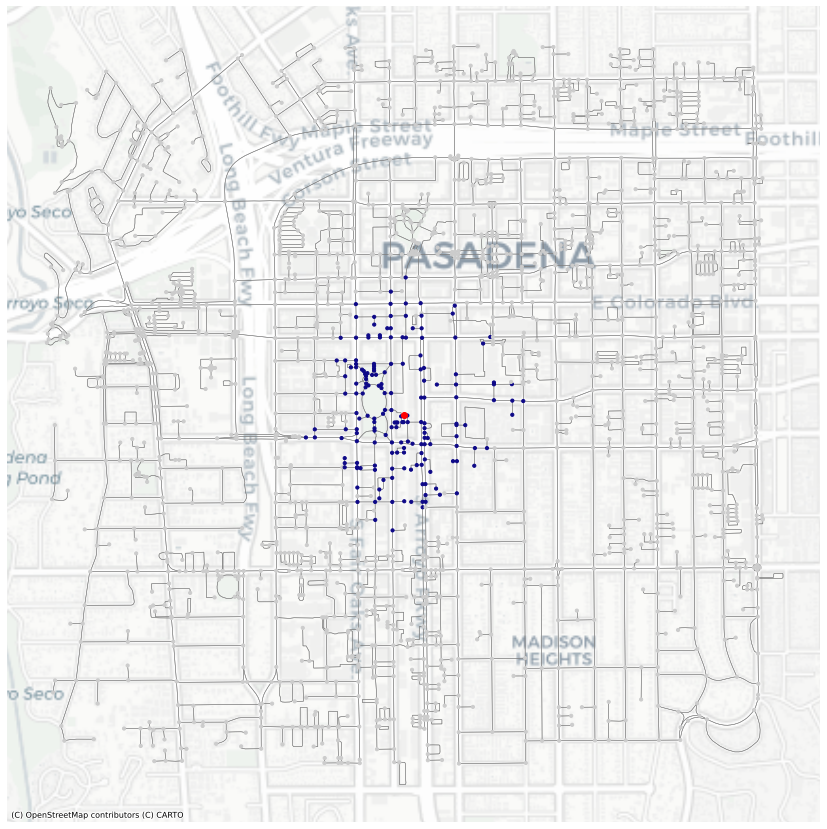

In [442]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[1995241213]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [443]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
16218739,4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,POINT (-13152450.736 4048392.897),10 mins,#0d0887
122575436,4.048394e+06,-1.315228e+07,traffic_signals,4,-118.148901,34.145787,POINT (-13152275.453 4048394.443),10 mins,#0d0887
122615775,4.048328e+06,-1.315245e+07,NaN,3,-118.150464,34.145293,POINT (-13152449.467 4048328.011),10 mins,#0d0887
29322322,4.047716e+06,-1.315252e+07,NaN,3,-118.151123,34.140746,POINT (-13152522.860 4047716.495),10 mins,#0d0887
725857496,4.047742e+06,-1.315245e+07,NaN,3,-118.150433,34.140933,POINT (-13152446.005 4047741.674),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8366502777,4.047717e+06,-1.315209e+07,NaN,3,-118.147218,34.140748,POINT (-13152088.124 4047716.737),10 mins,#0d0887
8366502785,4.047743e+06,-1.315210e+07,NaN,3,-118.147359,34.140944,POINT (-13152103.865 4047743.113),10 mins,#0d0887
8366502796,4.047767e+06,-1.315210e+07,NaN,3,-118.147361,34.141119,POINT (-13152104.009 4047766.677),10 mins,#0d0887


In [444]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

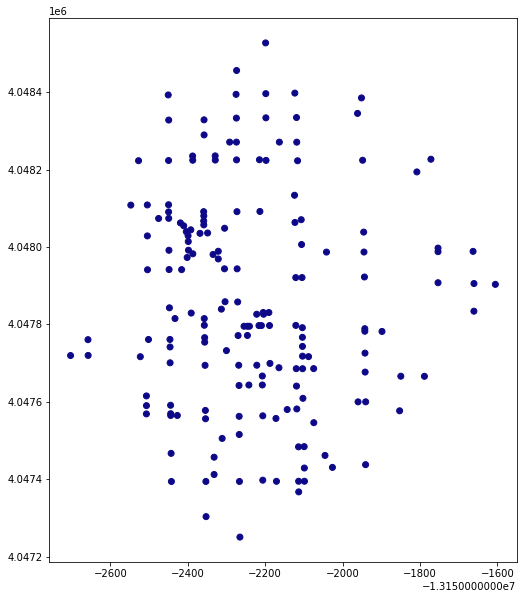

In [445]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

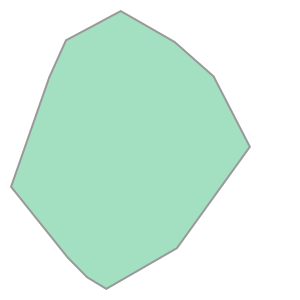

In [446]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [447]:
isochrones_del = gdf_nodes.dissolve("time")
isochrones_del

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13152703.098 4047719.535, -131526...",4.048393e+06,-1.315245e+07,traffic_signals,4,-118.150475,34.145775,#0d0887


In [448]:
isochrones_del = isochrones_del.convex_hull.reset_index()
isochrones_del

,time,0
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


In [449]:
isochrones_del.columns=['time','geometry']
isochrones_del

,time,geometry
0,10 mins,"POLYGON ((-13152265.489 4047250.399, -13152352..."


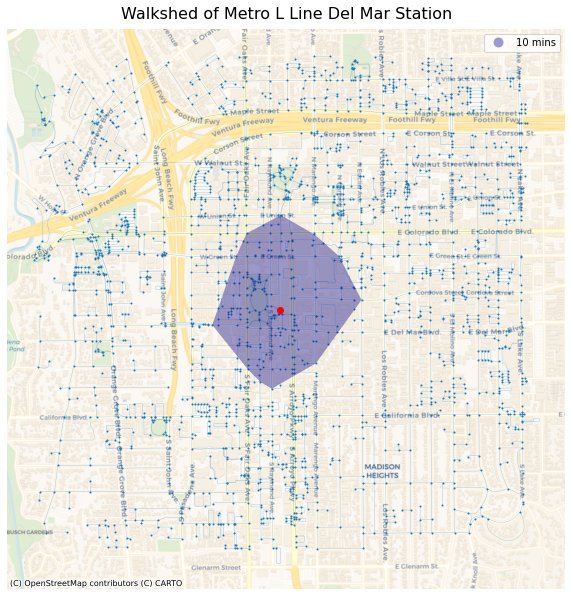

In [450]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_del.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Del Mar Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

And there we have it! The convex hull of the 10 minute walkshed from Del Mar Station. Time to move on to the ACS data.

<AxesSubplot:>

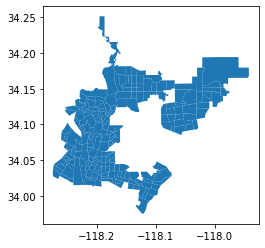

In [451]:
#Double checking our spatial data

gdf.plot()

In [452]:
# Quick peek at our data types, making sure our numbers a float types

gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 214 entries, 0 to 213
Data columns (total 44 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            214 non-null    object  
 1   Census Tract                                    214 non-null    object  
 2   11 Total Population                             214 non-null    float64 
 3   11 Total Foreign Born                           214 non-null    float64 
 4   11 Total Entered 2000 or later                  214 non-null    float64 
 5   11 Europe                                       214 non-null    float64 
 6   11 Europe Entered 2000 or later                 214 non-null    float64 
 7   11 Asia                                         214 non-null    float64 
 8   11 Asia Entered 2000 or later                   214 non-null    float64 
 9   11 Latin America        

In [453]:
# And another peek at our data set again before moving on to mapping

gdf.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
0,06037181000,"Census Tract 1810, Los Angeles, CA",6574.0,2172.0,161.0,88.0,0.0,1039.0,137.0,941.0,...,99.0,0.0,113.0,0.0,15.0,0.0,-5.569441,NELA,None,"MULTIPOLYGON (((-118.22860 34.14689, -118.2285..."
1,06037181300,"Census Tract 1813, Los Angeles, CA",3860.0,1428.0,188.0,77.0,8.0,845.0,144.0,491.0,...,77.0,0.0,43.0,0.0,57.0,0.0,-4.277401,NELA,None,"MULTIPOLYGON (((-118.22942 34.13411, -118.2294..."
2,06037181400,"Census Tract 1814, Los Angeles, CA",4832.0,2026.0,625.0,89.0,9.0,1160.0,303.0,775.0,...,66.0,0.0,150.0,40.0,46.0,25.0,-0.880861,NELA,None,"MULTIPOLYGON (((-118.21897 34.14000, -118.2173..."
3,06037181500,"Census Tract 1815, Los Angeles, CA",4035.0,1683.0,183.0,113.0,30.0,806.0,101.0,762.0,...,277.0,0.0,122.0,0.0,19.0,0.0,-10.516913,NELA,None,"MULTIPOLYGON (((-118.20153 34.13351, -118.2015..."
4,06037181600,"Census Tract 1816, Los Angeles, CA",4425.0,1125.0,278.0,49.0,27.0,369.0,154.0,675.0,...,126.0,0.0,44.0,11.0,64.0,17.0,2.453619,NELA,None,"MULTIPOLYGON (((-118.21828 34.13188, -118.2181..."


### Starting to Build Our Foreign Born Percent by Census Tract Map Layer

Our data is nice and neat, so let's move on to creating our final maps with overlays.

<AxesSubplot:>

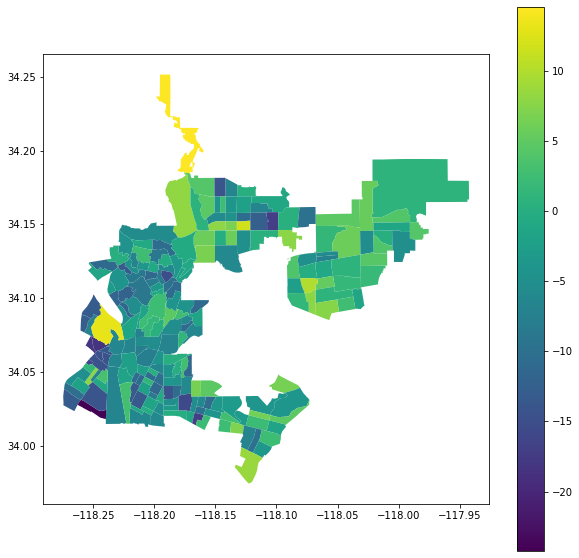

In [454]:
#Looking at our data as a choropleth for all of LA County

gdf.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

This shows a plot of our clean dataset which is the regions around our seven L Line stations. These are the regions of North San Gabriel Valley, Pasadena, Northeast LA, Downtown Los Angeles, and East LA. 

In [455]:
#Isolating our Del Mar Station walkshed census tracts

delmar = gdf[gdf["FIPS"].isin(['06037461902',  
                                '06037463602', 
                                '06037463700']
)
            ]

In [456]:
delmar.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
140,06037461902,"Census Tract 4619.02, Los Angeles, CA",1306.0,321.0,2.0,39.0,2.0,141.0,0.0,113.0,...,0.0,0.0,16.0,0.0,28.0,0.0,7.958612,Pasadena,Del Mar,"MULTIPOLYGON (((-118.15570 34.14973, -118.1554..."
159,06037463602,"Census Tract 4636.02, Los Angeles, CA",5047.0,1613.0,469.0,327.0,108.0,851.0,234.0,345.0,...,108.0,0.0,21.0,0.0,112.0,100.0,-0.161660,Pasadena,Del Mar,"MULTIPOLYGON (((-118.15046 34.14577, -118.1497..."
160,06037463700,"Census Tract 4637, Los Angeles, CA",2203.0,295.0,95.0,39.0,23.0,184.0,72.0,62.0,...,40.0,0.0,25.0,8.0,54.0,0.0,5.793363,Pasadena,Del Mar,"MULTIPOLYGON (((-118.16776 34.14147, -118.1676..."


<AxesSubplot:>

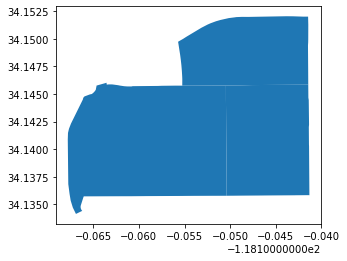

In [457]:
#Quick check to make sure it looks right

delmar.plot()

In [458]:
delmar.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 3 entries, 140 to 160
Data columns (total 44 columns):
 #   Column                                          Non-Null Count  Dtype   
---  ------                                          --------------  -----   
 0   FIPS                                            3 non-null      object  
 1   Census Tract                                    3 non-null      object  
 2   11 Total Population                             3 non-null      float64 
 3   11 Total Foreign Born                           3 non-null      float64 
 4   11 Total Entered 2000 or later                  3 non-null      float64 
 5   11 Europe                                       3 non-null      float64 
 6   11 Europe Entered 2000 or later                 3 non-null      float64 
 7   11 Asia                                         3 non-null      float64 
 8   11 Asia Entered 2000 or later                   3 non-null      float64 
 9   11 Latin America        

<AxesSubplot:>

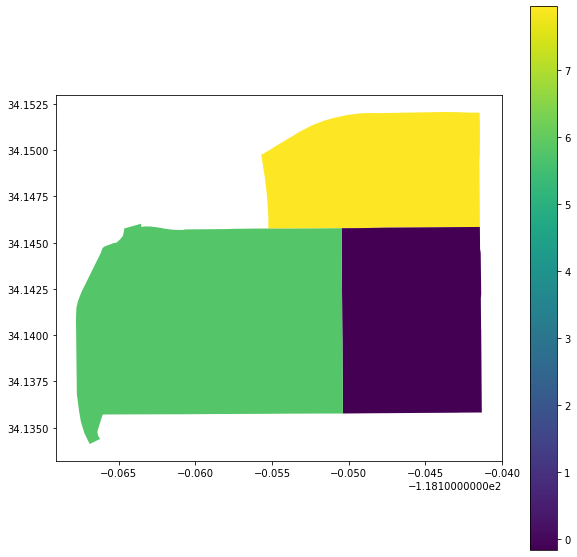

In [459]:
#Fairly narrow range of percentage foreign born here, with a noticeably higher percentage to the north

delmar.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

### Bringing it all together

First, let's project our map to web mercator

In [460]:
delmar_web_mercator = delmar.to_crs(epsg=3857)

Lets add a basemap and some details

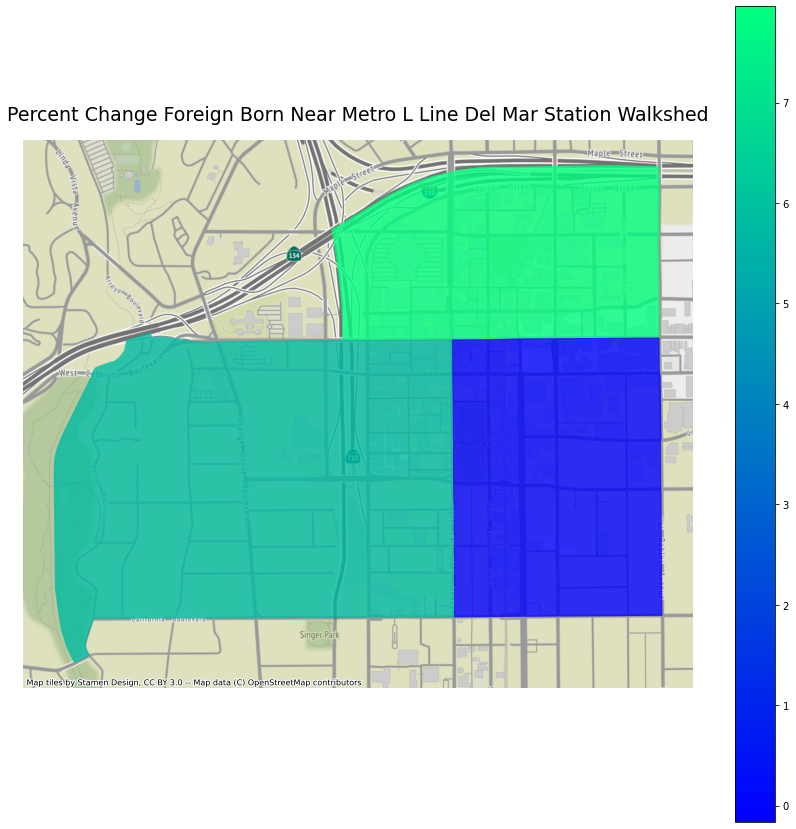

In [461]:
fig, ax = plt.subplots(figsize=(15, 15))
 
delmar_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

ax.axis('off')

ax.set_title('Percent Change Foreign Born Near Metro L Line Del Mar Station Walkshed',fontsize=19, pad=20)

ctx.add_basemap(ax,source=ctx.providers.Stamen.Terrain)
#how can we add a legend and bins to this?

Looking good! Let's layer the isochrone layer on top to show us the walkshed from Del Mar Station

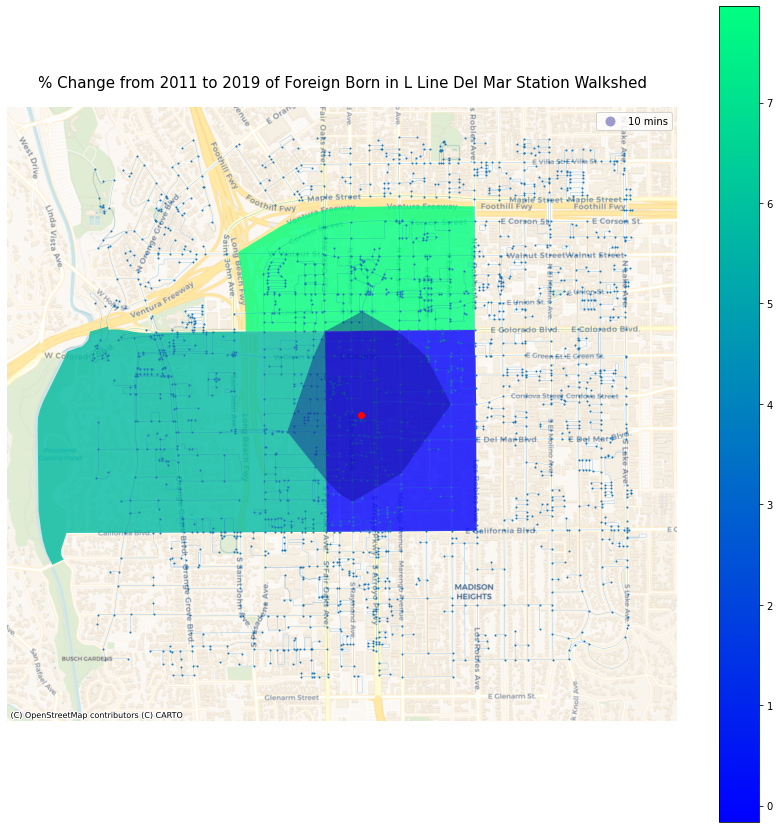

In [462]:
fig, ax = plt.subplots(figsize=(15, 15))
 
delmar_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

# add the isochrones
isochrones_del.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('% Change from 2011 to 2019 of Foreign Born in L Line Del Mar Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

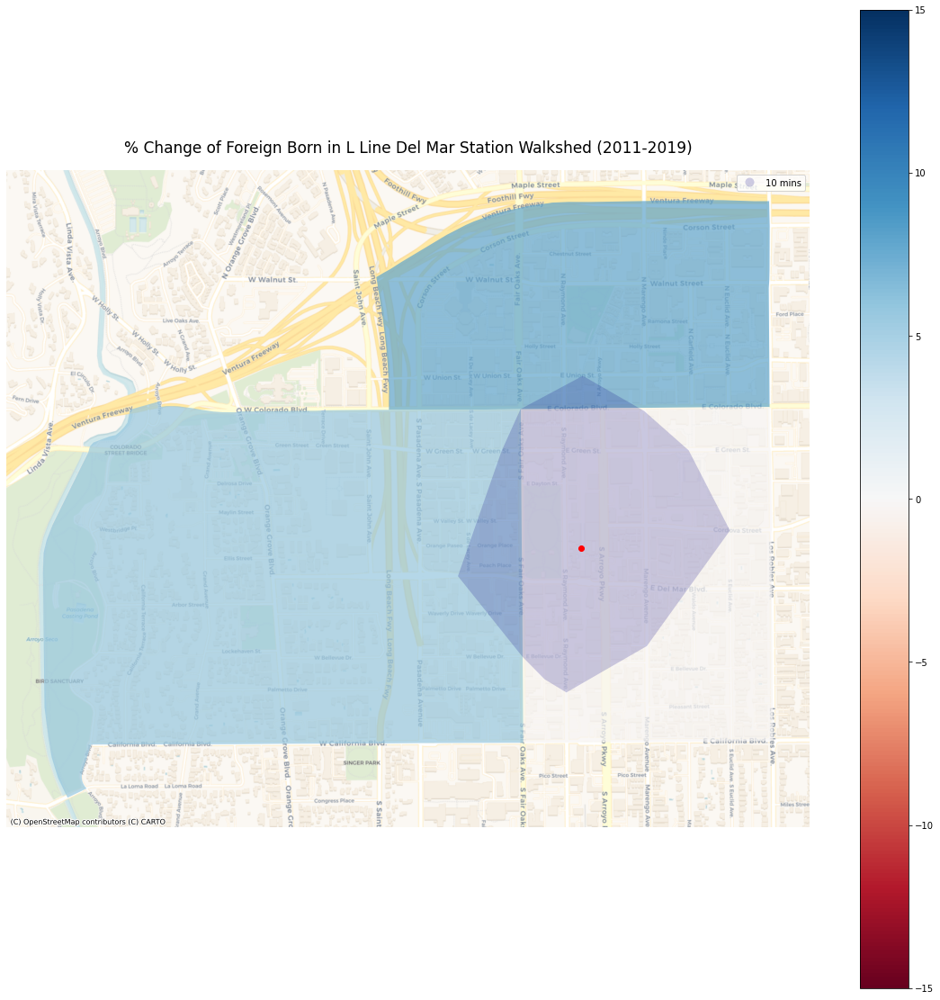

In [463]:
## cleaning up nodes, edges and adding new range and colors

fig, ax = plt.subplots(figsize=(20, 20))
 
delmar_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")

# add the isochrones
isochrones_del.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born in L Line Del Mar Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("DelMarStation_ForeignBorn.jpg")

We see an increase in foreign born population to the north of the station, and very little change immediately around the station. There is more multi-family housing in the dark blue census tract which typically is more affordable, yet we see very little foreign born populations entering this area. The tract to the east of the station saw a relatively moderate increase in foreign born population. This tract has more single family homes and considerably higher property values, along with an archery range, country club, and the Rose Bowl Parade headquarters. This implies that more affluent foreign born populations moved to this part of the walkshed. 

### Percentage of Foreign Born Population in Metro L Line Chinatown Station Walkshed

Let's create a choropleth map of the Chinatown Station showing the percent Foreign Born population within the station walkshed. Just as we did before, we begin by first creating an isochrone walkshed map. 

In [464]:
address = 'Chinatown Station, College Street, New Chinatown, Chinatown, Los Angeles, Los Angeles County, California, 90012, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [465]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 3.99 s, sys: 26.3 ms, total: 4.02 s
Wall time: 4.04 s


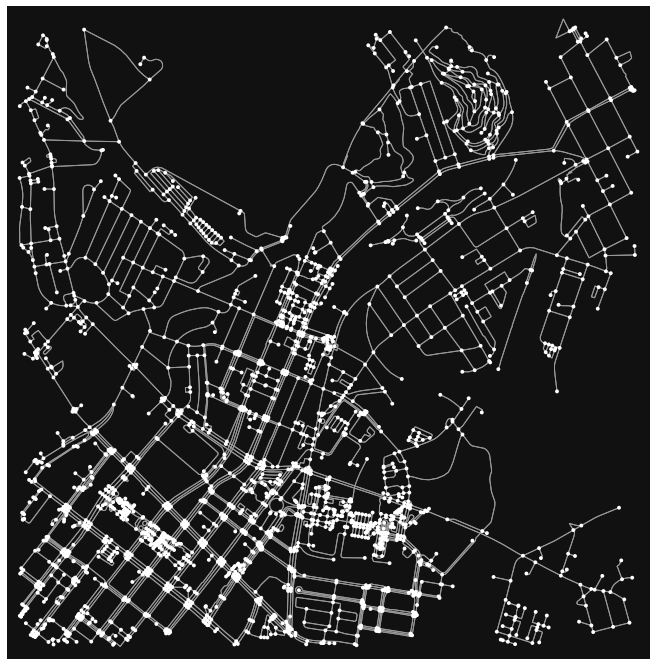

In [466]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [467]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [468]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [469]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
15027548,4.039027e+06,-1.316061e+07,3,-118.223785,34.076114,NaN,POINT (-13160611.557 4039026.875)
67619407,4.039118e+06,-1.316050e+07,4,-118.222746,34.076796,traffic_signals,POINT (-13160495.907 4039118.493)
123283621,4.038908e+06,-1.316055e+07,3,-118.223245,34.075226,NaN,POINT (-13160551.456 4038907.559)
15027549,4.038710e+06,-1.316045e+07,4,-118.222311,34.073758,traffic_signals,POINT (-13160447.416 4038710.296)
3723806094,4.038716e+06,-1.316045e+07,4,-118.222338,34.073802,NaN,POINT (-13160450.467 4038716.075)


### Plotting the station area

<AxesSubplot:>

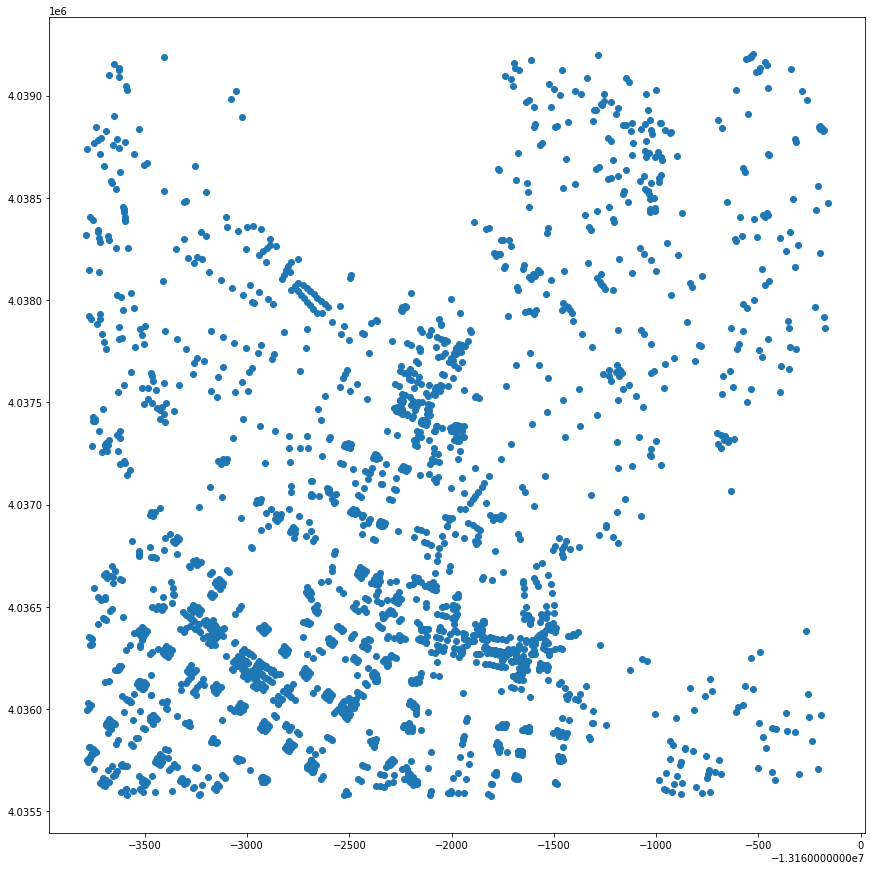

In [470]:
gdf_nodes.plot(figsize=(15,15))

In [471]:
gdf_edges.head()

osmid               name    highway  oneway  \
u        v          key                                                    
15027548 67619407   0      9126419    Humboldt Street   tertiary   False   
         123283621  0    358037415          Avenue 19   tertiary   False   
67619407 7871476832 0      9126419    Humboldt Street   tertiary   False   
         6787624912 0    398398790  San Fernando Road  secondary   False   
         15027548   0      9126419    Humboldt Street   tertiary   False   

                          length  \
u        v          key            
15027548 67619407   0    122.072   
         123283621  0    110.537   
67619407 7871476832 0     41.864   
         6787624912 0     67.319   
         15027548   0    122.072   

                                                                  geometry  \
u        v          key                                                      
15027548 67619407   0    LINESTRING (-13160611.557 4039026.875, -131605...   
         123283621  0    LINESTRING (-13160611.557 4039026.875, -131606...   
67619407 7871476832 0    LINESTRING (-13160495.907 4039118.493, -131604...   
         6787624912 0    LINESTRING (-13160495.907 4039118.493, -131605...   
         15027548   0    LINESTRING (-13160495.907 4039118.493, -131605...   

                        lanes maxspeed bridge service access tunnel width  
u        v          key                                                    
15027548 67619407   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         123283621  0       2      NaN    NaN     NaN    NaN    NaN   NaN  
67619407 7871476832 0     NaN      NaN    NaN     NaN    NaN    NaN   NaN  
         6787624912 0       4      NaN    NaN     NaN    NaN    NaN   NaN  
         15027548   0     NaN      NaN    NaN     NaN    NaN    NaN   NaN

<AxesSubplot:>

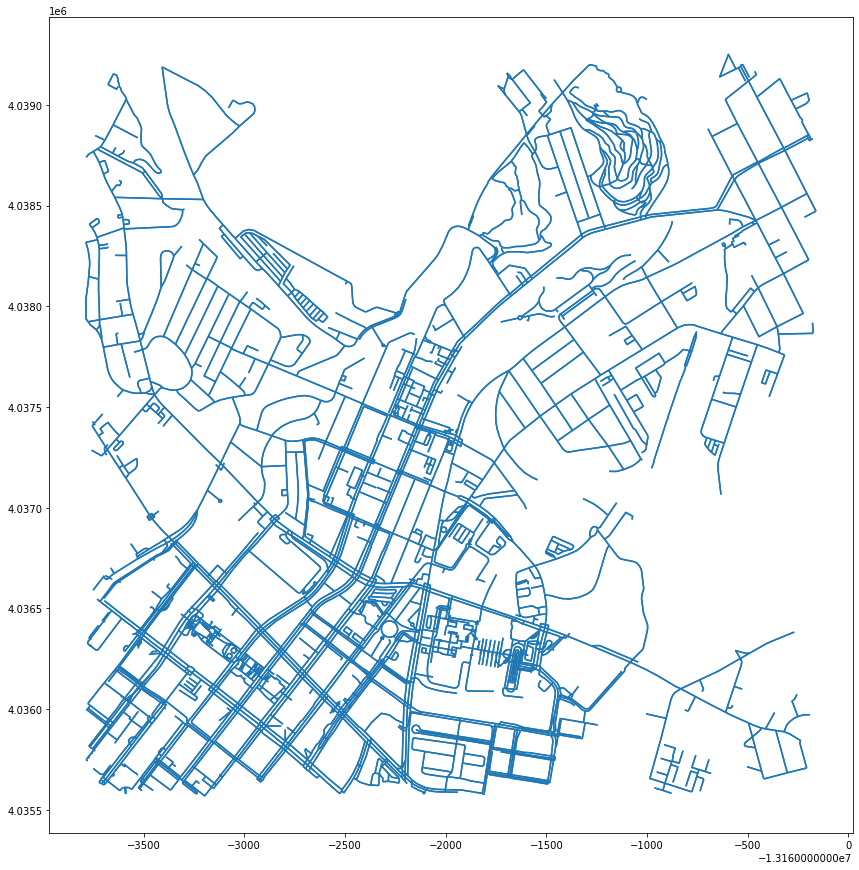

In [472]:
gdf_edges.plot(figsize=(15,15))

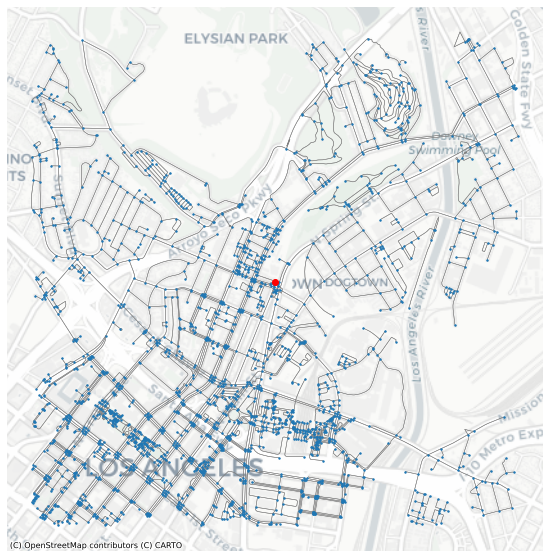

In [473]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [474]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width
u,v,key,,,,,,,,,,,,,
6696889055,6696889035,0,712252243,NaN,service,False,17.011,"LINESTRING (-13162310.537 4035735.587, -131623...",NaN,NaN,NaN,parking_aisle,NaN,NaN,NaN
6883792554,5322500506,0,54147832,NaN,service,False,10.711,"LINESTRING (-13162197.537 4037610.535, -131622...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
9430425850,7672088720,0,821669117,NaN,footway,False,36.643,"LINESTRING (-13162486.099 4036045.204, -131624...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
9464527557,9464527561,0,"[1026531897, 1026531901]",NaN,footway,False,141.296,"LINESTRING (-13161527.605 4036207.029, -131614...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
7672084072,3846749454,0,907992122,North Los Angeles Street,secondary,False,56.097,"LINESTRING (-13162601.449 4035859.827, -131626...",3,NaN,NaN,NaN,NaN,NaN,NaN


In [475]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [476]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,bridge,service,access,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
8881631470,268372658,0,405178814,North Alameda Street,primary,False,11.966,"LINESTRING (-13162089.034 4036619.396, -131620...",6,35 mph,NaN,NaN,NaN,NaN,NaN,0.149575
338941373,123146330,0,13424597,North Hill Place,residential,False,56.635,"LINESTRING (-13162699.165 4036912.429, -131627...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.707937
8406712256,8881484959,0,905250094,NaN,footway,False,9.702,"LINESTRING (-13162308.678 4036475.274, -131623...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.121275
5546898917,9466976721,0,"[579093555, 770526268]",NaN,service,False,175.132,"LINESTRING (-13161787.625 4036775.143, -131618...",NaN,NaN,NaN,parking_aisle,NaN,NaN,NaN,2.189150
9039134154,3698057810,0,959940680,NaN,footway,False,12.493,"LINESTRING (-13162514.486 4035595.802, -131625...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.156163


In [477]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [478]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [479]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 8290553634, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 174 nodes within 10 minutes 


In [480]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
2094664038,4.038493e+06,-1.316103e+07,3,-118.227562,34.072138,NaN,POINT (-13161032.044 4038492.515),NaN,NaN
2094664203,4.038497e+06,-1.316101e+07,3,-118.227350,34.072174,NaN,POINT (-13161008.389 4038497.380),NaN,NaN
2624887841,4.037740e+06,-1.316295e+07,3,-118.244755,34.066537,NaN,POINT (-13162945.916 4037739.782),NaN,NaN
1838396744,4.039174e+06,-1.316161e+07,4,-118.232785,34.077212,NaN,POINT (-13161613.421 4039174.429),NaN,NaN
1838389220,4.037585e+06,-1.316333e+07,3,-118.248244,34.065384,NaN,POINT (-13163334.309 4037584.856),NaN,NaN
123426792,4.035894e+06,-1.316036e+07,3,-118.221530,34.052800,NaN,POINT (-13160360.465 4035893.955),NaN,NaN
8873641175,4.036267e+06,-1.316298e+07,3,-118.245076,34.055577,NaN,POINT (-13162981.605 4036267.157),NaN,NaN
7863815762,4.037445e+06,-1.316222e+07,4,-118.238199,34.064342,NaN,POINT (-13162216.060 4037444.887),10 mins,#0d0887
6787543363,4.037163e+06,-1.316242e+07,3,-118.240050,34.062241,NaN,POINT (-13162422.169 4037162.523),NaN,NaN


In [481]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [482]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
7098361230,4.037936e+06,-1.316263e+07,3,-118.241945,34.067998,NaN,POINT (-13162633.097 4037936.101),NaN,#cccccc
8873888181,4.036957e+06,-1.316249e+07,3,-118.240617,34.060714,NaN,POINT (-13162485.220 4036957.322),NaN,#cccccc
6696889035,4.035718e+06,-1.316232e+07,4,-118.239126,34.051491,NaN,POINT (-13162319.332 4035718.147),NaN,#cccccc
7590207191,4.036125e+06,-1.316332e+07,3,-118.248154,34.054517,NaN,POINT (-13163324.257 4036124.665),NaN,#cccccc
605023218,4.035756e+06,-1.316093e+07,1,-118.226668,34.051772,NaN,POINT (-13160932.424 4035755.888),NaN,#cccccc


<AxesSubplot:>

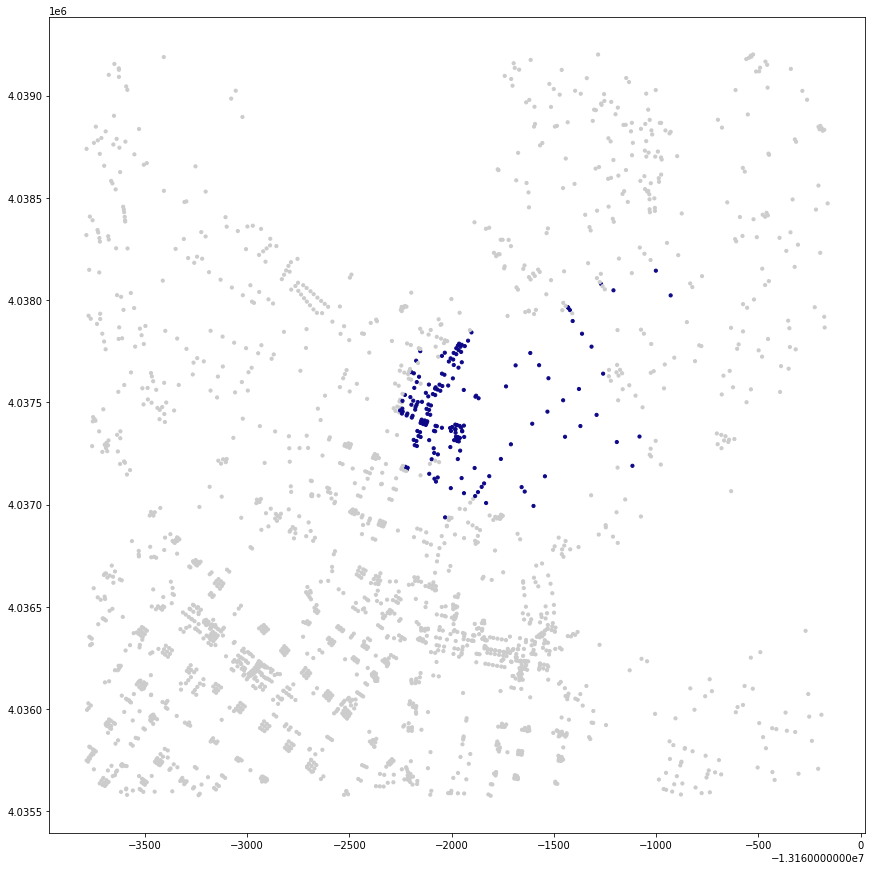

In [483]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

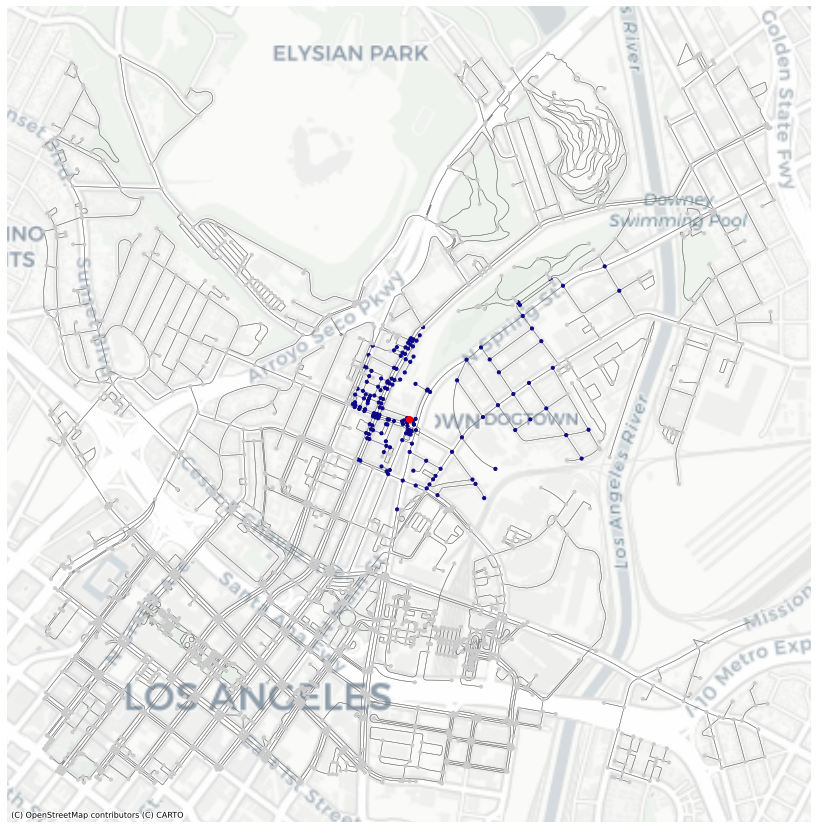

In [484]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[8290553634]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [485]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
15717265,4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,POINT (-13161001.164 4038143.644),10 mins,#0d0887
122656713,4.038023e+06,-1.316093e+07,4,-118.226635,34.068642,NaN,POINT (-13160928.751 4038022.752),10 mins,#0d0887
123037729,4.038048e+06,-1.316121e+07,4,-118.229147,34.068827,NaN,POINT (-13161208.430 4038047.599),10 mins,#0d0887
17677673,4.037351e+06,-1.316198e+07,3,-118.236082,34.063645,NaN,POINT (-13161980.397 4037351.213),10 mins,#0d0887
67619377,4.037281e+06,-1.316201e+07,3,-118.236313,34.063122,NaN,POINT (-13162006.145 4037280.975),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8409454505,4.037529e+06,-1.316211e+07,1,-118.237282,34.064967,NaN,POINT (-13162114.070 4037528.873),10 mins,#0d0887
8409457169,4.037488e+06,-1.316217e+07,3,-118.237797,34.064661,NaN,POINT (-13162171.299 4037487.673),10 mins,#0d0887
8409457171,4.037477e+06,-1.316218e+07,1,-118.237841,34.064580,NaN,POINT (-13162176.286 4037476.802),10 mins,#0d0887


In [486]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

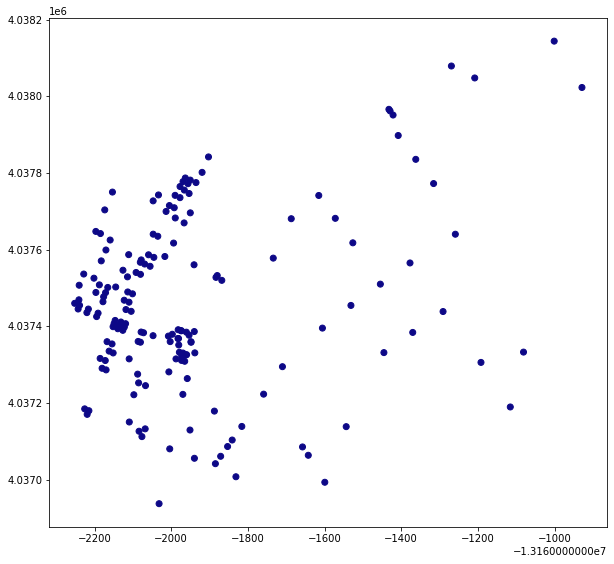

In [487]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

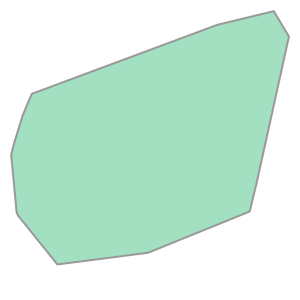

In [488]:
gdf_10.unary_union.convex_hull

In [489]:
# Getting a oblong asymmetrical shape here. Code seems right so there's something up here... Maybe it has to do with osmnx? Or maybe it's just the topology of the station area?

isochrones_chinatown = gdf_nodes.dissolve("time")
isochrones_chinatown

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13162251.772 4037459.803, -131622...",4.038144e+06,-1.316100e+07,4,-118.227285,34.069542,traffic_signals,#0d0887


In [490]:
isochrones_chinatown = isochrones_chinatown.convex_hull.reset_index()
isochrones_chinatown

,time,0
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


In [491]:
isochrones_chinatown.columns=['time','geometry']
isochrones_chinatown

,time,geometry
0,10 mins,"POLYGON ((-13162031.671 4036937.288, -13162219..."


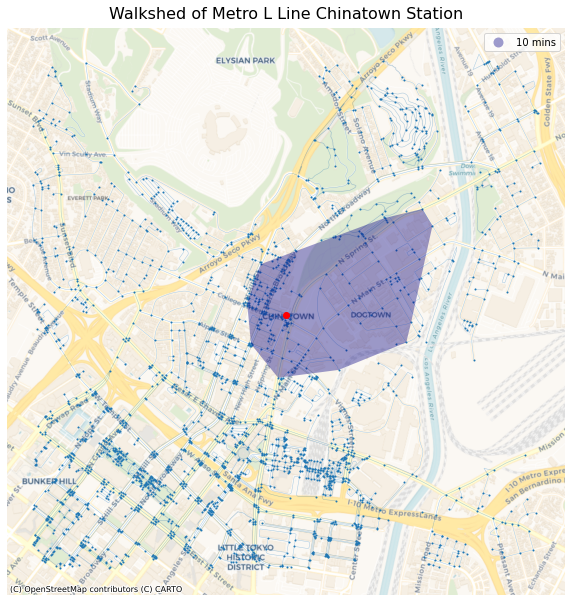

In [492]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_chinatown.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Chinatown Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

### Choropleth map of percent foreign born in the Chinatown Station walkshed

Now we pivot to create the choropleth map of the percent foreign born in the census tracts in our station walkshed.

### Isolating Our Chinatown Walkshed

Based on the walk shed map we created, we use its nodes to cross reference a census tract map and identify the tracts in our walkshed. We now isolate those tracts into its own variable.

In [493]:
Chinatown = gdf[gdf["FIPS"].isin(['06037206010', 
                                       '06037207103', 
                                       '06037207102',
                                       '06037206020']
                                      )
                     ]

In [494]:
Chinatown.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
86,06037206010,"Census Tract 2060.10, Los Angeles, CA",2947.0,1661.0,322.0,18.0,0.0,926.0,290.0,714.0,...,166.0,0.0,0.0,0.0,0.0,0.0,-6.398801,Central LA,Chinatown,"MULTIPOLYGON (((-118.23924 34.06726, -118.2380..."
87,06037206020,"Census Tract 2060.20, Los Angeles, CA",7677.0,1404.0,275.0,14.0,0.0,189.0,17.0,1187.0,...,232.0,23.0,9.0,0.0,20.0,0.0,-6.284370,Central LA,Chinatown,"MULTIPOLYGON (((-118.23787 34.05427, -118.2378..."
94,06037207102,"Census Tract 2071.02, Los Angeles, CA",2276.0,1753.0,799.0,1.0,0.0,1592.0,799.0,160.0,...,114.0,0.0,25.0,13.0,1.0,0.0,-14.239135,Central LA,Chinatown,"MULTIPOLYGON (((-118.24303 34.05735, -118.2429..."
95,06037207103,"Census Tract 2071.03, Los Angeles, CA",2098.0,1728.0,644.0,0.0,0.0,1688.0,626.0,22.0,...,18.0,0.0,40.0,11.0,6.0,0.0,-13.454837,Central LA,Chinatown,"MULTIPOLYGON (((-118.24557 34.06470, -118.2454..."


<AxesSubplot:>

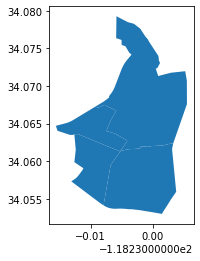

In [495]:
Chinatown.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

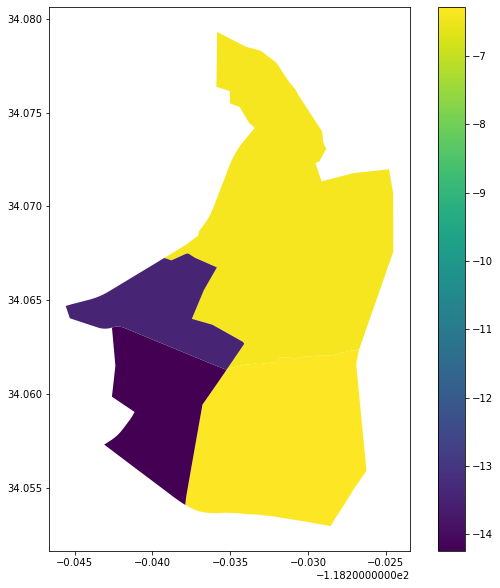

In [496]:
Chinatown.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

Wow, the darker blue census tracts saw a 12%-14% decrease in foreign born residents. It’s hard to tell, but the yellow polygon is actually two census tracts. Let's add some map details like titles and a basemap.

### Adding a base map and map details

We first have to project our data to web mercator.

In [497]:
Chinatown_web_mercator = Chinatown.to_crs(epsg=3857)

Now we can tap into adding map details and our basemap.

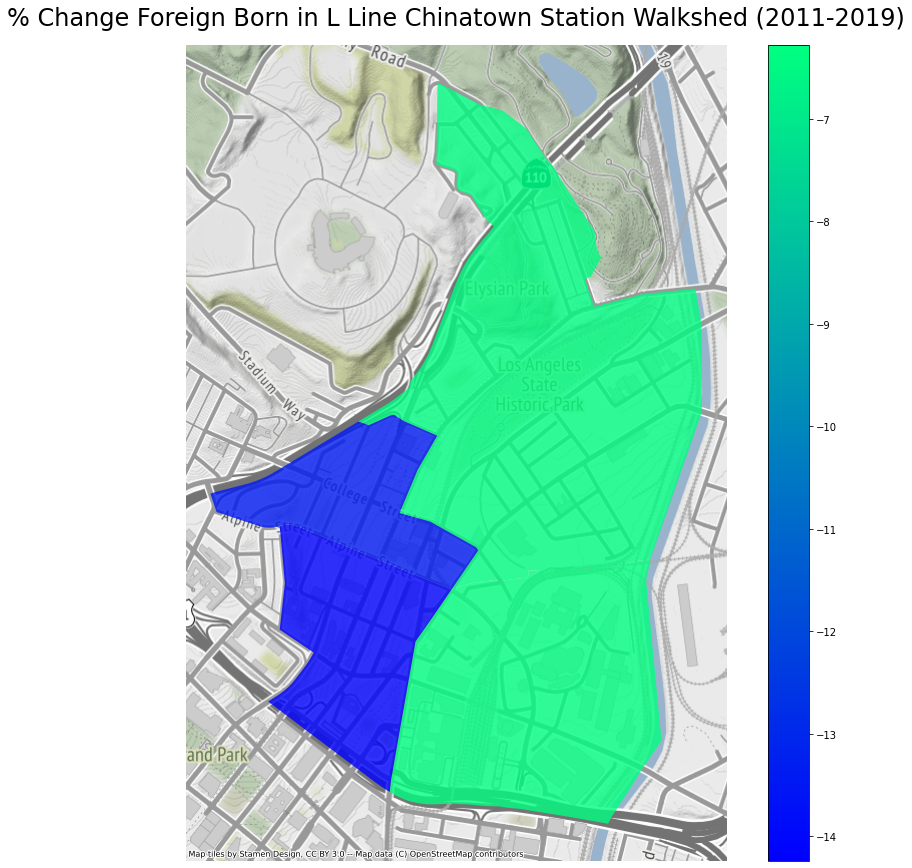

In [498]:
fig, ax = plt.subplots(figsize=(15, 15))
 
Chinatown_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8, 
                    cmap="winter")

ax.axis('off')

ax.set_title('% Change Foreign Born in L Line Chinatown Station Walkshed (2011-2019)',fontsize=24, pad=20)

ctx.add_basemap(ax,source=ctx.providers.Stamen.Terrain)

Nice! Let's layer our isochrone map with our choropleth map.

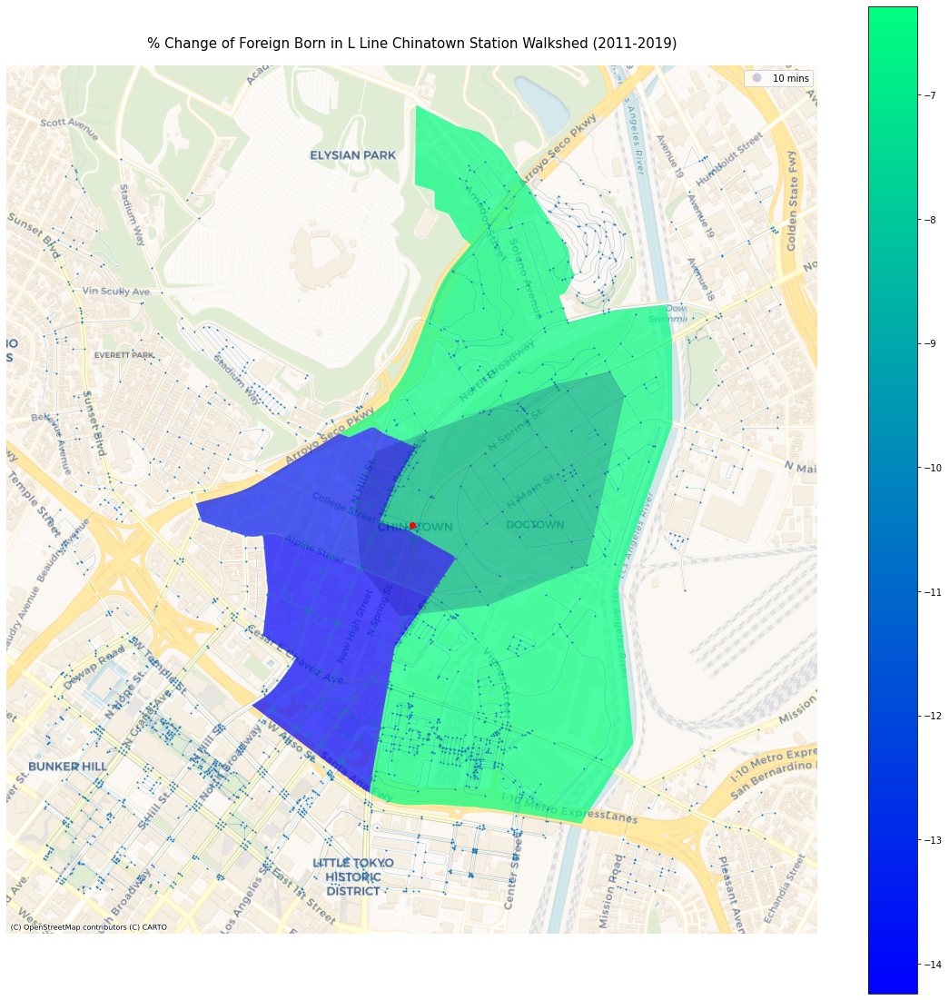

In [499]:
fig, ax = plt.subplots(figsize=(20, 20))
 
Chinatown_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.7, 
                    cmap="winter")

# add the isochrones
isochrones_chinatown.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('% Change of Foreign Born in L Line Chinatown Station Walkshed (2011-2019)',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

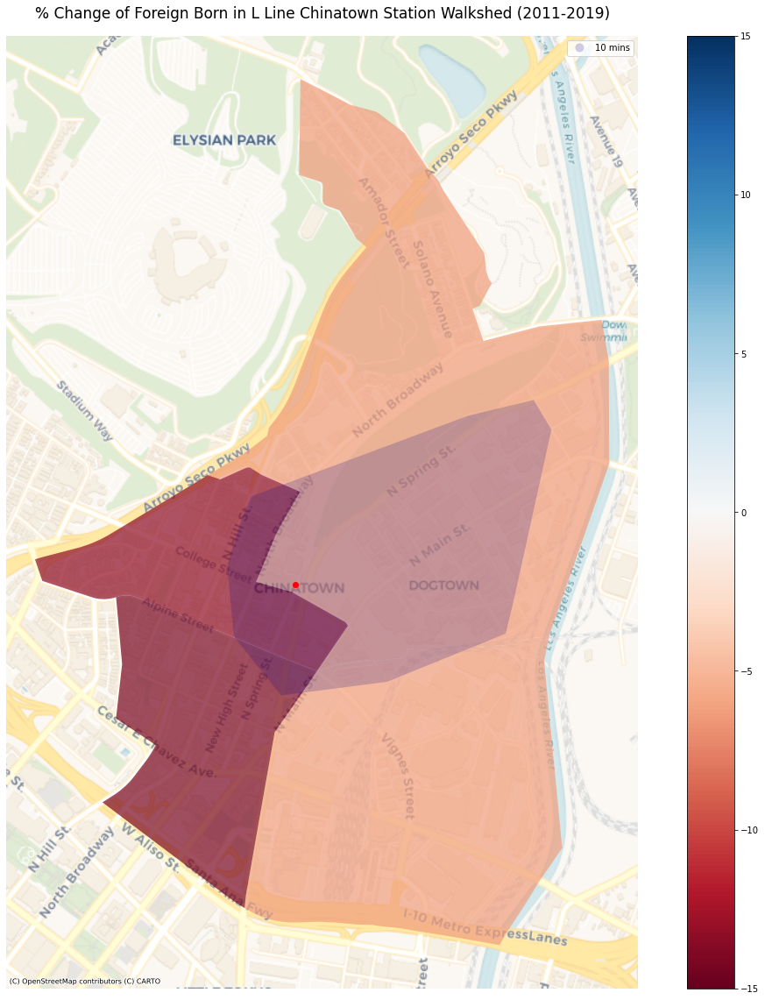

In [500]:
fig, ax = plt.subplots(figsize=(20, 20))
 
Chinatown_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax,
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")

# add the isochrones
isochrones_chinatown.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[8290553634]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born in L Line Chinatown Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("ChinatownStation_ForeignBorn.jpg")

This tells a different story than the Del Mar Station. Whereas Del Mar Station saw either no or up to a 7% increase in foreign born populations, Chinatown Station saw at least a 7% *decrease* in every census tract in its walkshed. The stations that saw the largest decrease are adjacent to the gentrifying neighborhoods of Angelino Heights, Echo Park, and Downtown LA. Their immediate proximity to these neighborhoods could have added additional pressures that made the decrease in foreign born residents larger than the other census tracts in the Chinatown Station walkshed.

### Percentage of Foreign Born Population in Metro L Line Arcadia Station Walkshed

In [501]:
address = 'Arcadia, East Saint Joseph Street, Arcadia, Los Angeles County, California, 91006, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [502]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G7 = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.53 s, sys: 20.3 ms, total: 2.55 s
Wall time: 2.57 s


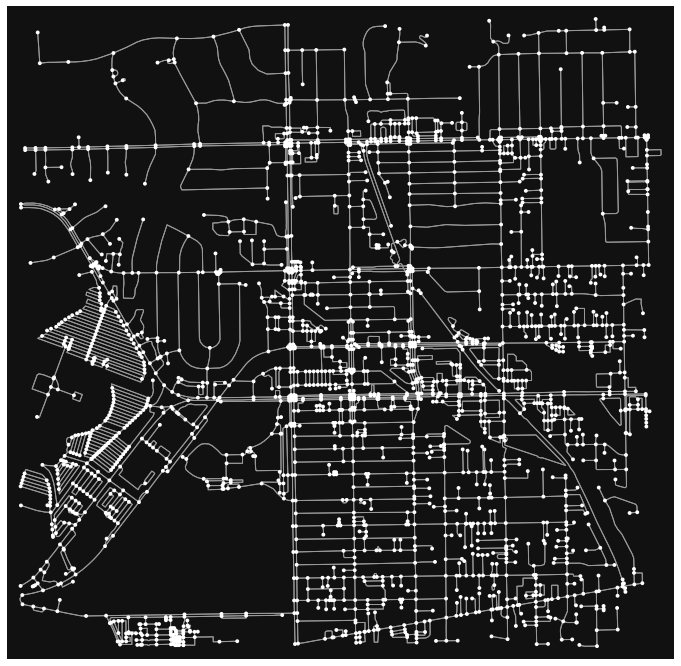

In [503]:
fig, ax = ox.plot_graph(G7,figsize=(12,12))

In [504]:
G7 = ox.project_graph(G7, to_crs='epsg:3857')

In [505]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G7)

In [506]:
gdf_nodes.head()

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
28947780,4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,NaN,POINT (-13139201.067 4048215.578)
7464757602,4.048249e+06,-1.313920e+07,3,-118.031456,34.144706,NaN,POINT (-13139201.568 4048249.096)
268161590,4.048088e+06,-1.313920e+07,3,-118.031432,34.143510,NaN,POINT (-13139198.930 4048088.256)
122699116,4.048217e+06,-1.313913e+07,3,-118.030834,34.144465,NaN,POINT (-13139132.372 4048216.627)
28947781,4.048357e+06,-1.313920e+07,4,-118.031471,34.145510,traffic_signals,POINT (-13139203.238 4048357.185)


### Plotting the station area

<AxesSubplot:>

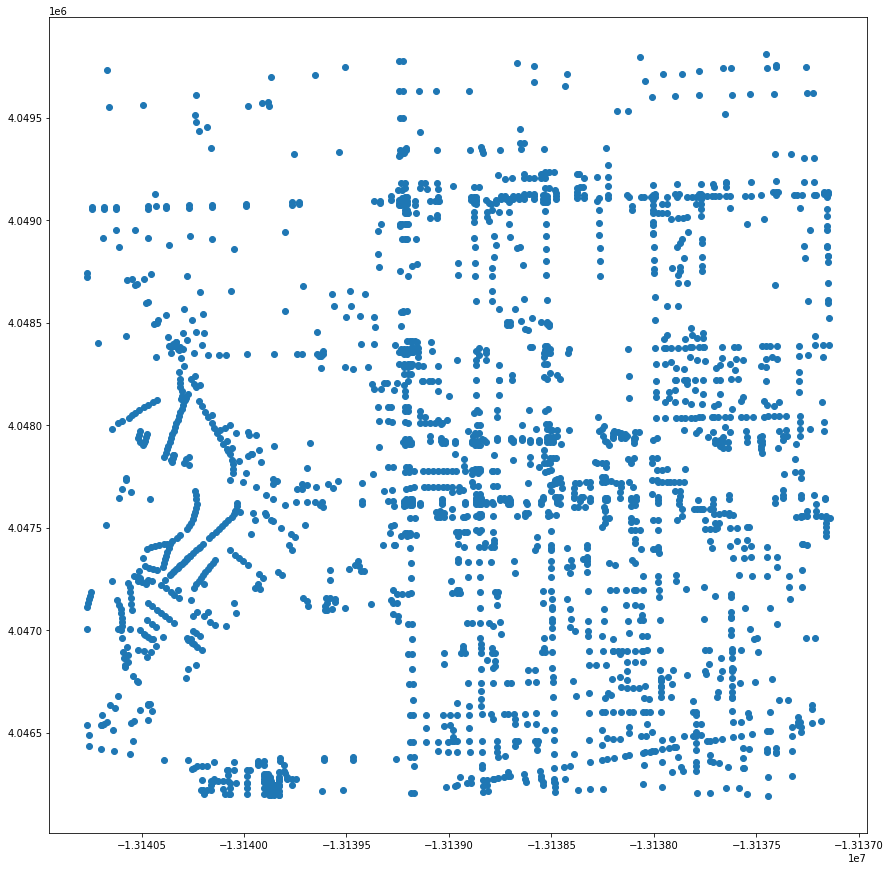

In [507]:
gdf_nodes.plot(figsize=(15,15))

In [508]:
gdf_edges.head()

osmid  oneway lanes                name  \
u          v          key                                                
28947780   7464757602 0    182043866   False     2  Santa Anita Avenue   
           268161590  0    182043866   False     2  Santa Anita Avenue   
           122699116  0    206911853   False   NaN     La Porte Street   
7464757602 939854546  0    182043866   False     2  Santa Anita Avenue   
           28947780   0    182043866   False     2  Santa Anita Avenue   

                               highway   length  \
u          v          key                         
28947780   7464757602 0        primary   27.713   
           268161590  0        primary  105.272   
           122699116  0    residential   56.797   
7464757602 939854546  0        primary   30.260   
           28947780   0        primary   27.713   

                                                                    geometry  \
u          v          key                                                      
28947780   7464757602 0    LINESTRING (-13139201.067 4048215.578, -131392...   
           268161590  0    LINESTRING (-13139201.067 4048215.578, -131391...   
           122699116  0    LINESTRING (-13139201.067 4048215.578, -131391...   
7464757602 939854546  0    LINESTRING (-13139201.568 4048249.096, -131392...   
           28947780   0    LINESTRING (-13139201.568 4048249.096, -131392...   

                          service maxspeed access width bridge tunnel  
u          v          key                                              
28947780   7464757602 0       NaN      NaN    NaN   NaN    NaN    NaN  
           268161590  0       NaN      NaN    NaN   NaN    NaN    NaN  
           122699116  0       NaN      NaN    NaN   NaN    NaN    NaN  
7464757602 939854546  0       NaN      NaN    NaN   NaN    NaN    NaN  
           28947780   0       NaN      NaN    NaN   NaN    NaN    NaN

<AxesSubplot:>

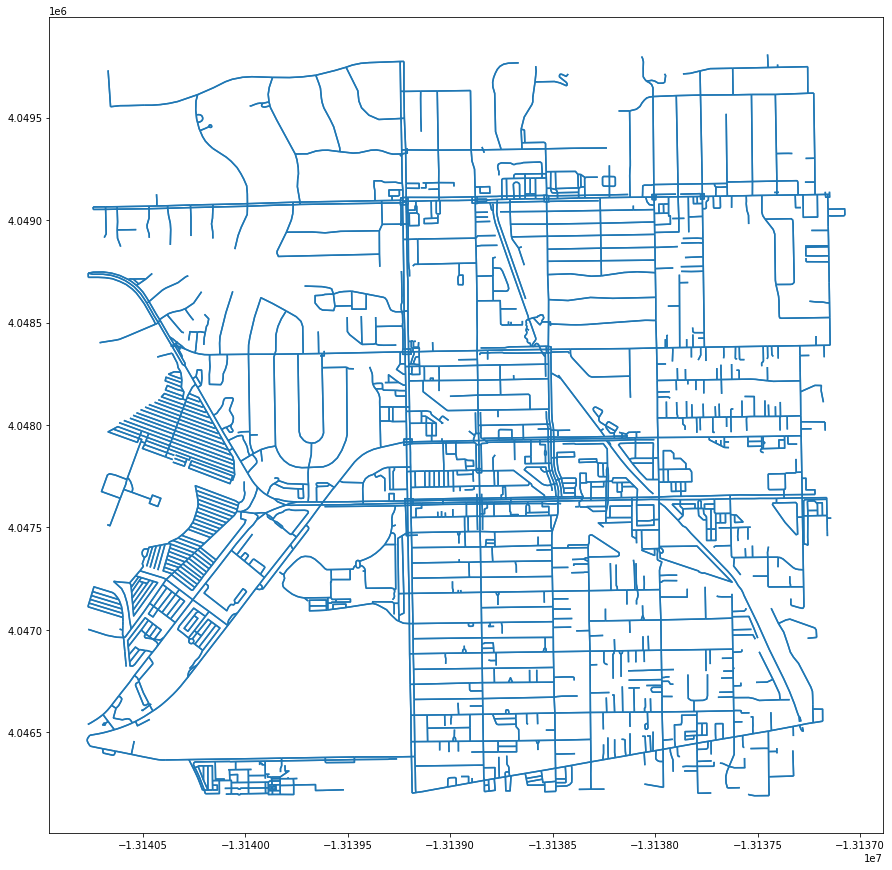

In [509]:
gdf_edges.plot(figsize=(15,15))

In [510]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13140768.523793029
4046191.6095434465
-13137140.766303413
4049808.4405088546


In [511]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13138954.64504822
4048000.0250261505


In [512]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node7 = ox.distance.nearest_nodes(G7,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node7))

The id for the nearest node is 5599455859


In [513]:
# what is this record?
gdf_nodes.loc[[center_node7]]

,y,x,street_count,lon,lat,highway,geometry
osmid,,,,,,,
5599455859,4.047971e+06,-1.313891e+07,1,-118.028828,34.142635,NaN,POINT (-13138909.043 4047970.553)


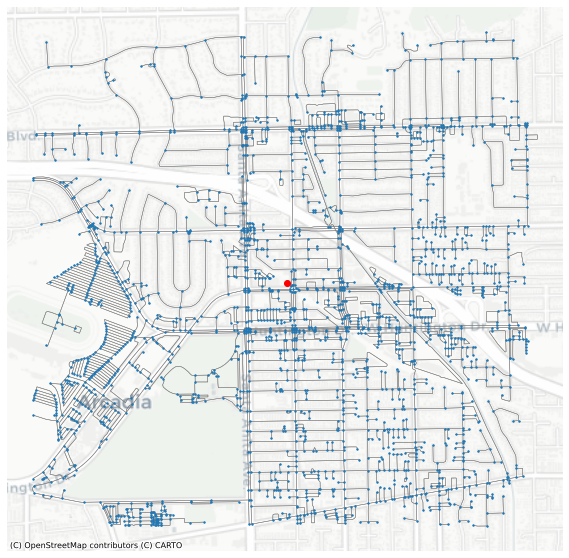

In [514]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node7]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [515]:
gdf_edges.sample(5)

,,,osmid,oneway,lanes,name,highway,length,geometry,service,maxspeed,access,width,bridge,tunnel
u,v,key,,,,,,,,,,,,,
6790199467,3342789870,0,13392227,False,NaN,Oakhurst Lane,residential,35.967,"LINESTRING (-13140382.323 4048538.797, -131404...",NaN,NaN,NaN,NaN,NaN,NaN
123091339,122793617,0,13368724,False,NaN,Laurel Avenue,residential,217.776,"LINESTRING (-13138266.485 4048984.769, -131380...",NaN,NaN,NaN,NaN,NaN,NaN
7128948139,7128948137,0,762921812,False,NaN,NaN,service,25.069,"LINESTRING (-13140547.332 4047096.688, -131405...",parking_aisle,NaN,NaN,NaN,NaN,NaN
123060802,123060803,0,13363485,False,NaN,Tindalo Road,residential,50.870,"LINESTRING (-13139343.757 4048772.239, -131393...",NaN,25 mph,NaN,NaN,NaN,NaN
6731995039,6731995044,0,206911853,False,NaN,La Porte Street,residential,54.261,"LINESTRING (-13138690.000 4048222.330, -131387...",NaN,NaN,NaN,NaN,NaN,NaN


In [516]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [517]:
gdf_edges.sample(5)

,,,osmid,oneway,lanes,name,highway,length,geometry,service,maxspeed,access,width,bridge,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,
939788176,7870832495,0,80560569,False,NaN,NaN,service,33.079,"LINESTRING (-13138497.016 4046963.784, -131385...",alley,NaN,NaN,NaN,NaN,NaN,0.413488
6442577879,6094647103,0,13448799,False,NaN,North 5th Avenue,residential,10.944,"LINESTRING (-13137982.520 4047734.128, -131379...",NaN,NaN,NaN,NaN,NaN,NaN,0.136800
6787671661,6799541782,0,725094477,False,NaN,NaN,service,12.765,"LINESTRING (-13138518.968 4047574.223, -131385...",NaN,NaN,NaN,NaN,NaN,NaN,0.159562
123042493,7874695888,0,13360316,False,NaN,South 3rd Avenue,residential,74.484,"LINESTRING (-13138322.656 4047191.639, -131383...",NaN,NaN,NaN,NaN,NaN,NaN,0.931050
7215957528,7215957533,0,772867488,False,NaN,NaN,service,16.940,"LINESTRING (-13140505.743 4047971.252, -131405...",parking_aisle,NaN,NaN,NaN,NaN,NaN,0.211750


In [518]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [519]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [520]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G7, 5599455859, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 165 nodes within 10 minutes 


In [521]:
gdf_nodes.sample(30)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
7246983756,4.047561e+06,-1.313761e+07,3,-118.017179,34.139591,NaN,POINT (-13137612.282 4047561.177),NaN,NaN
2169769022,4.048068e+06,-1.313914e+07,3,-118.030907,34.143361,NaN,POINT (-13139140.487 4048068.202),10 mins,#0d0887
7792593935,4.046432e+06,-1.313877e+07,3,-118.027548,34.131193,NaN,POINT (-13138766.587 4046431.728),NaN,NaN
7128948129,4.047227e+06,-1.314048e+07,3,-118.042929,34.137105,NaN,POINT (-13140478.692 4047226.769),NaN,NaN
6442577879,4.047734e+06,-1.313798e+07,3,-118.020505,34.140877,NaN,POINT (-13137982.520 4047734.128),NaN,NaN
3126572412,4.047982e+06,-1.313851e+07,3,-118.025238,34.142717,NaN,POINT (-13138509.373 4047981.515),10 mins,#0d0887
123079917,4.049005e+06,-1.313746e+07,3,-118.015843,34.150324,NaN,POINT (-13137463.537 4049004.758),NaN,NaN
6822387901,4.046587e+06,-1.313896e+07,3,-118.029276,34.132346,NaN,POINT (-13138958.858 4046586.734),NaN,NaN
7874695899,4.047151e+06,-1.313850e+07,3,-118.025151,34.136544,NaN,POINT (-13138499.666 4047151.305),NaN,NaN


In [522]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [523]:
gdf_nodes.sample(5)

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
7464545054,4.048384e+06,-1.314036e+07,1,-118.041900,34.145706,NaN,POINT (-13140364.200 4048383.562),NaN,#cccccc
2761920396,4.047043e+06,-1.313925e+07,3,-118.031891,34.135736,NaN,POINT (-13139249.992 4047042.690),NaN,#cccccc
7072155546,4.048371e+06,-1.314032e+07,4,-118.041523,34.145615,NaN,POINT (-13140322.211 4048371.308),NaN,#cccccc
3952846252,4.049148e+06,-1.313925e+07,3,-118.031877,34.151388,NaN,POINT (-13139248.490 4049147.868),NaN,#cccccc
123091337,4.048980e+06,-1.313853e+07,4,-118.025400,34.150143,NaN,POINT (-13138527.462 4048980.478),NaN,#cccccc


<AxesSubplot:>

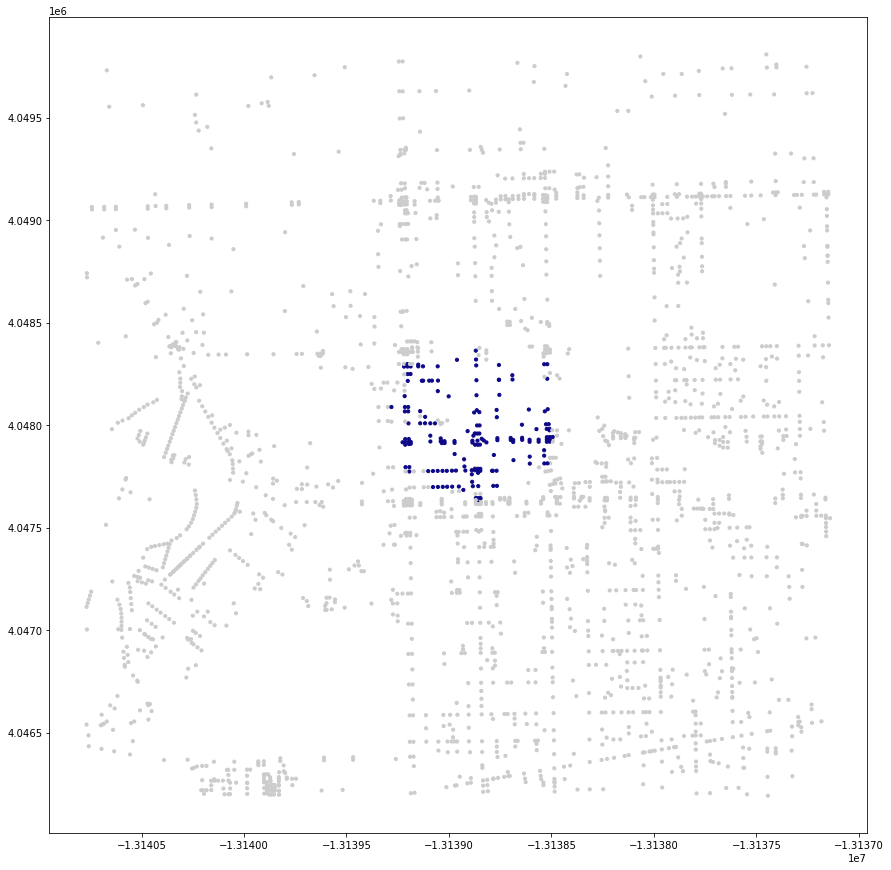

In [524]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

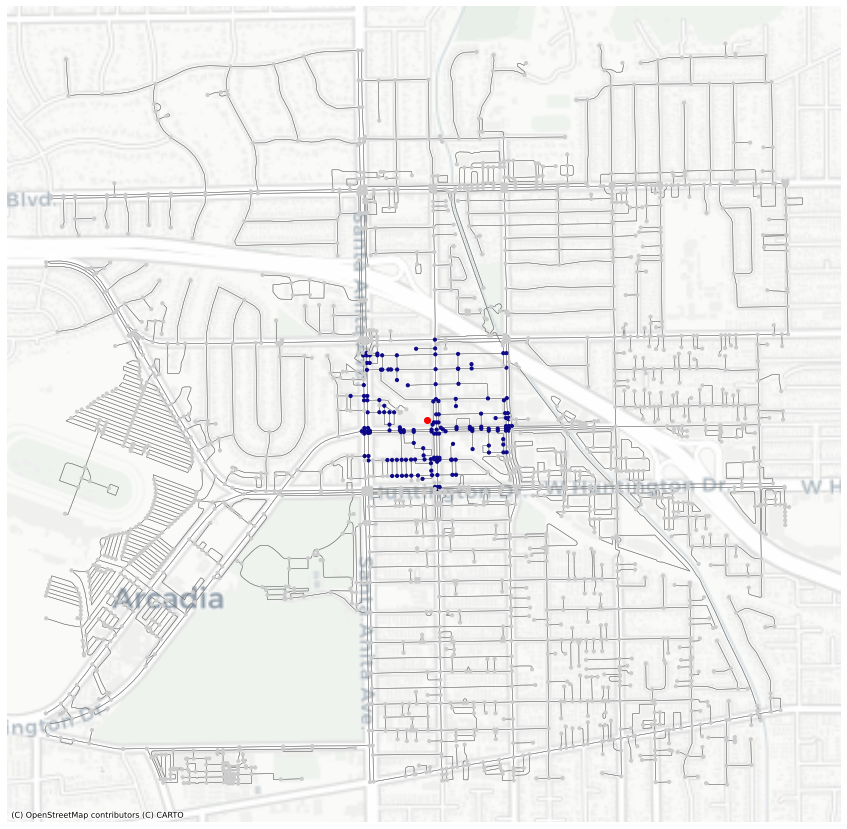

In [525]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node7]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [526]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,street_count,lon,lat,highway,geometry,time,color
osmid,,,,,,,,,
28947780,4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,NaN,POINT (-13139201.067 4048215.578),10 mins,#0d0887
7464757602,4.048249e+06,-1.313920e+07,3,-118.031456,34.144706,NaN,POINT (-13139201.568 4048249.096),10 mins,#0d0887
268161590,4.048088e+06,-1.313920e+07,3,-118.031432,34.143510,NaN,POINT (-13139198.930 4048088.256),10 mins,#0d0887
122699116,4.048217e+06,-1.313913e+07,3,-118.030834,34.144465,NaN,POINT (-13139132.372 4048216.627),10 mins,#0d0887
7883463556,4.048217e+06,-1.313913e+07,3,-118.030777,34.144465,NaN,POINT (-13139126.005 4048216.681),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7464904760,4.048067e+06,-1.313853e+07,1,-118.025445,34.143353,NaN,POINT (-13138532.405 4048067.126),10 mins,#0d0887
7464904766,4.048063e+06,-1.313885e+07,1,-118.028313,34.143324,NaN,POINT (-13138851.758 4048063.158),10 mins,#0d0887
7874784811,4.048319e+06,-1.313896e+07,1,-118.029295,34.145223,NaN,POINT (-13138961.029 4048318.595),10 mins,#0d0887


In [527]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

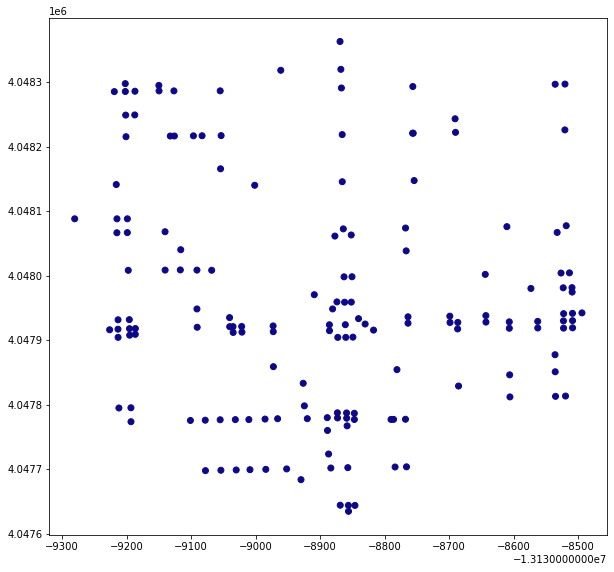

In [528]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

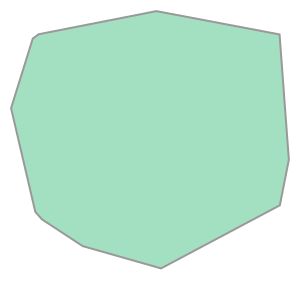

In [529]:
gdf_10.unary_union.convex_hull

In [530]:
# There's our polygon!
isochrones_arcadia = gdf_nodes.dissolve("time")
isochrones_arcadia

,geometry,y,x,street_count,lon,lat,highway,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13139280.639 4048088.229, -131392...",4.048216e+06,-1.313920e+07,3,-118.031451,34.144457,traffic_signals,#0d0887


In [531]:
isochrones_arcadia = isochrones_arcadia.convex_hull.reset_index()
isochrones_arcadia

,time,0
0,10 mins,"POLYGON ((-13138855.977 4047634.613, -13139077..."


In [532]:
isochrones_arcadia.columns=['time','geometry']
isochrones_arcadia

,time,geometry
0,10 mins,"POLYGON ((-13138855.977 4047634.613, -13139077..."


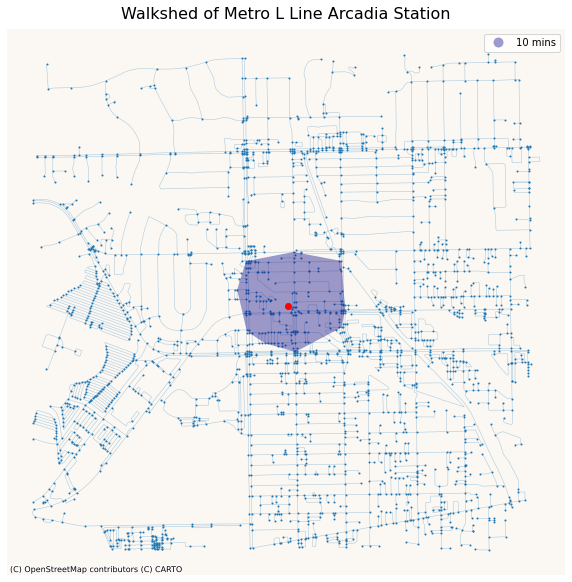

In [533]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_arcadia.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Arcadia Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

### Isolating Our Aracadia Walkshed

Based on the walk shed map we created, we use its nodes to cross reference a census tract map and identify the tracts in our walkshed. We now isolate those tracts into its own variable.

In [534]:
arcadia = gdf[gdf["FIPS"].isin(['06037430801', 
                                '06037430721', 
                                '06037430400',]
                                      )
                     ]

In [535]:
arcadia.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
109,06037430400,"Census Tract 4304, Los Angeles, CA",4877.0,2002.0,295.0,79.0,59.0,1683.0,222.0,206.0,...,0.0,0.0,24.0,0.0,17.0,7.0,5.632639,San Gabriel Valley,Arcadia,"MULTIPOLYGON (((-118.03194 34.16693, -118.0318..."
112,06037430721,"Census Tract 4307.21, Los Angeles, CA",2973.0,1287.0,274.0,81.0,13.0,1134.0,245.0,51.0,...,7.0,0.0,52.0,32.0,1.0,0.0,5.814608,San Gabriel Valley,Arcadia,"MULTIPOLYGON (((-118.05451 34.13186, -118.0543..."
115,06037430801,"Census Tract 4308.01, Los Angeles, CA",6719.0,4035.0,1441.0,37.0,0.0,3448.0,1290.0,482.0,...,0.0,0.0,31.0,0.0,121.0,48.0,-5.138131,San Gabriel Valley,Arcadia,"MULTIPOLYGON (((-118.03153 34.14550, -118.0284..."


<AxesSubplot:>

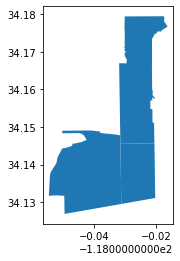

In [536]:
arcadia.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

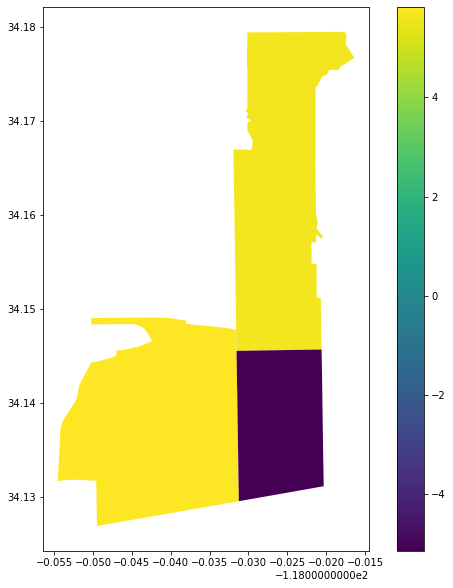

In [537]:
arcadia.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [538]:
arcadia_web_mercator = arcadia.to_crs(epsg=3857)

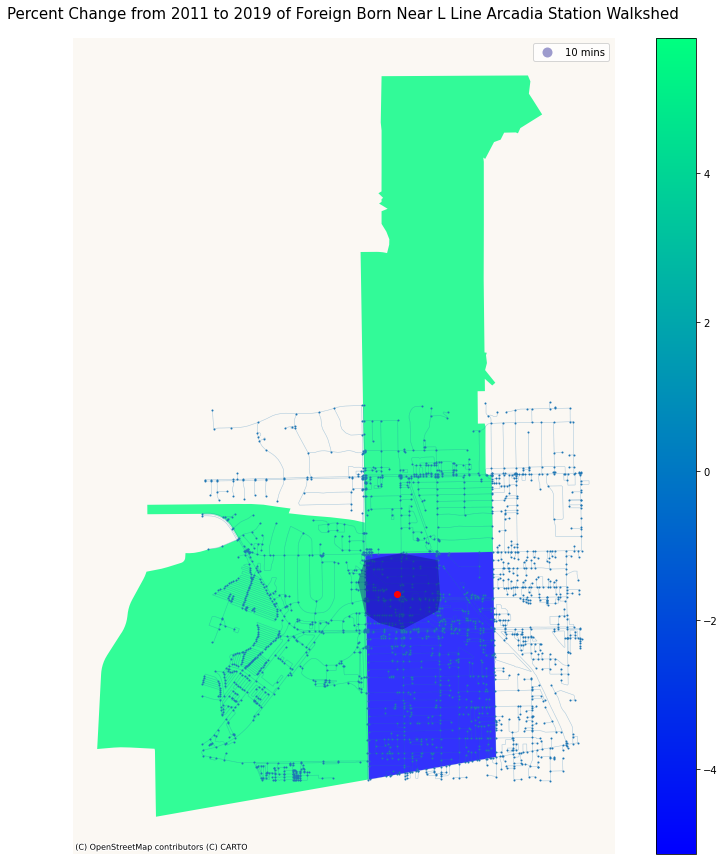

In [539]:
fig, ax = plt.subplots(figsize=(15, 15))
 
arcadia_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones_arcadia.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Arcadia Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

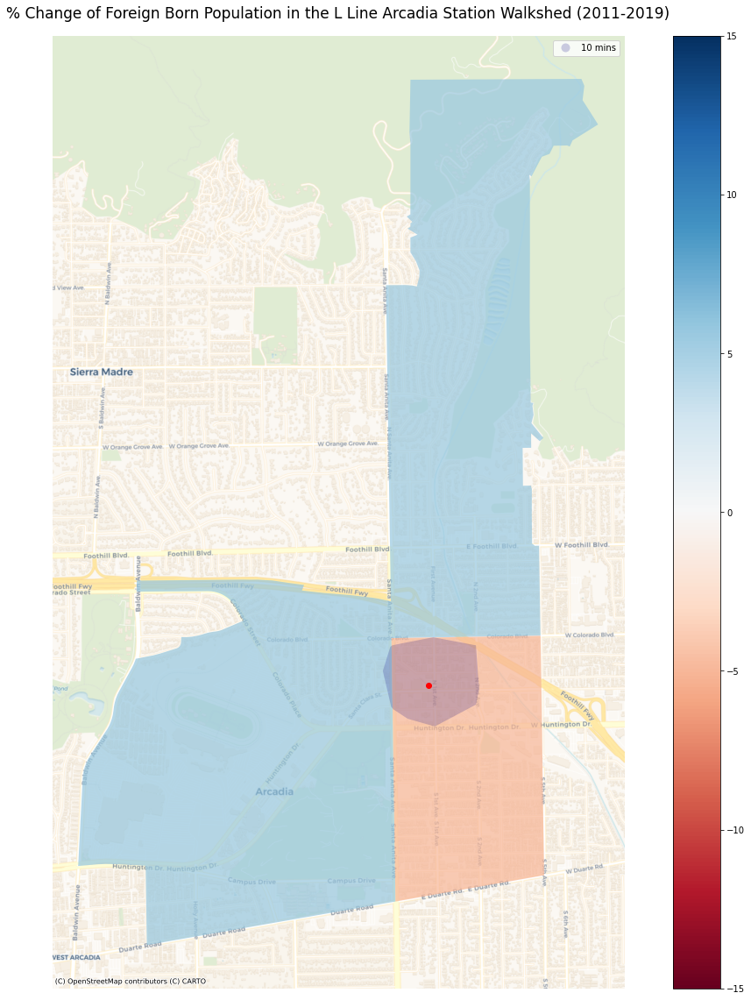

In [540]:
## clean with no nodes or edges

fig, ax = plt.subplots(figsize=(20, 20))
 
arcadia_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")

# add the isochrones
isochrones_arcadia.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node7]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born Population in the L Line Arcadia Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("ArcadiaStation_ForeignBorn5.jpg")

### Percentage of Foreign Born Population in Metro L Line Highland Park Station Walkshed

In [541]:
address = 'Highland Park, Marmion Way, Highland Park, Los Angeles, Los Angeles County, California, 90042, United States'
network_type = 'walk'
trip_times = [10] # in minutes
meters_per_minute = 80 # travel distance per minute

In [542]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.71 s, sys: 24.6 ms, total: 2.74 s
Wall time: 2.75 s


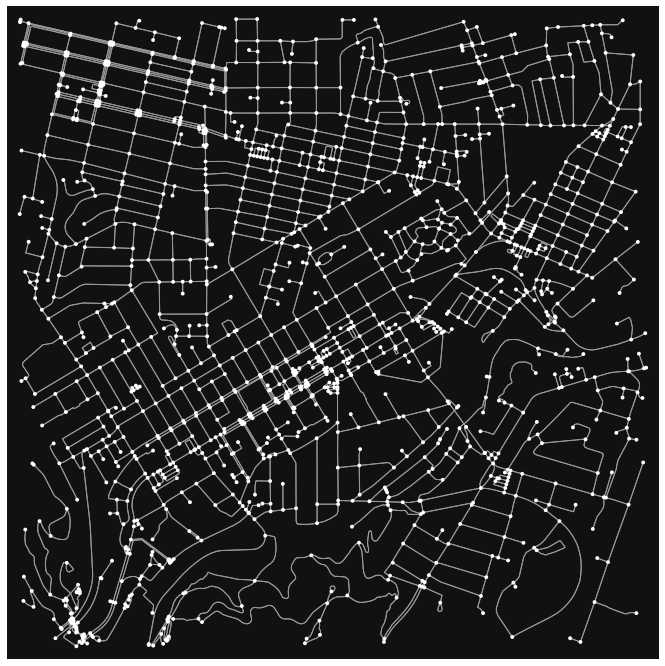

In [543]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [544]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [545]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [546]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10552905,4.045125e+06,-1.315873e+07,traffic_signals,4,-118.206904,34.121476,POINT (-13158732.406 4045124.904)
14956558,4.045007e+06,-1.315876e+07,stop,4,-118.207144,34.120598,POINT (-13158759.123 4045006.963)
6787557826,4.045178e+06,-1.315872e+07,NaN,3,-118.206794,34.121869,POINT (-13158720.061 4045177.844)
3644839500,4.045123e+06,-1.315872e+07,NaN,4,-118.206818,34.121461,POINT (-13158722.799 4045123.008)
10552907,4.044845e+06,-1.315760e+07,traffic_signals,4,-118.196712,34.119394,POINT (-13157597.793 4044844.985)


### Plotting the station area

<AxesSubplot:>

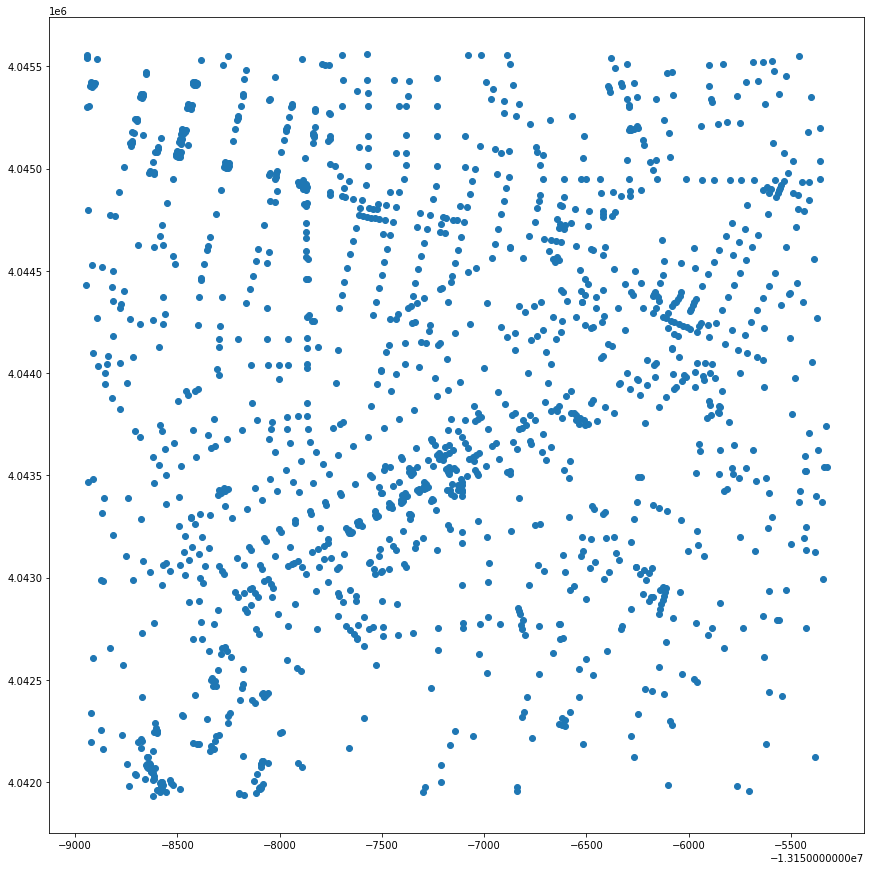

In [547]:
gdf_nodes.plot(figsize=(15,15))

In [548]:
gdf_edges.head()

osmid lanes            name    highway  oneway  \
u        v          key                                                       
10552905 14956558   0     54674043     2       Avenue 50   tertiary   False   
         6787557826 0     54674043     2       Avenue 50   tertiary   False   
         3644839500 0    398616334     5  York Boulevard  secondary   False   
14956558 10553872   0     54674043     2       Avenue 50   tertiary   False   
         10552905   0     54674043     2       Avenue 50   tertiary   False   

                          length  \
u        v          key            
10552905 14956558   0    100.000   
         6787557826 0     44.952   
         3644839500 0      8.097   
14956558 10553872   0    101.501   
         10552905   0    100.000   

                                                                  geometry  \
u        v          key                                                      
10552905 14956558   0    LINESTRING (-13158732.406 4045124.904, -131587...   
         6787557826 0    LINESTRING (-13158732.406 4045124.904, -131587...   
         3644839500 0    LINESTRING (-13158732.406 4045124.904, -131587...   
14956558 10553872   0    LINESTRING (-13158759.123 4045006.963, -131587...   
         10552905   0    LINESTRING (-13158759.123 4045006.963, -131587...   

                        service access bridge maxspeed junction width tunnel  
u        v          key                                                       
10552905 14956558   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         6787557826 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         3644839500 0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
14956558 10553872   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN  
         10552905   0       NaN    NaN    NaN      NaN      NaN   NaN    NaN

<AxesSubplot:>

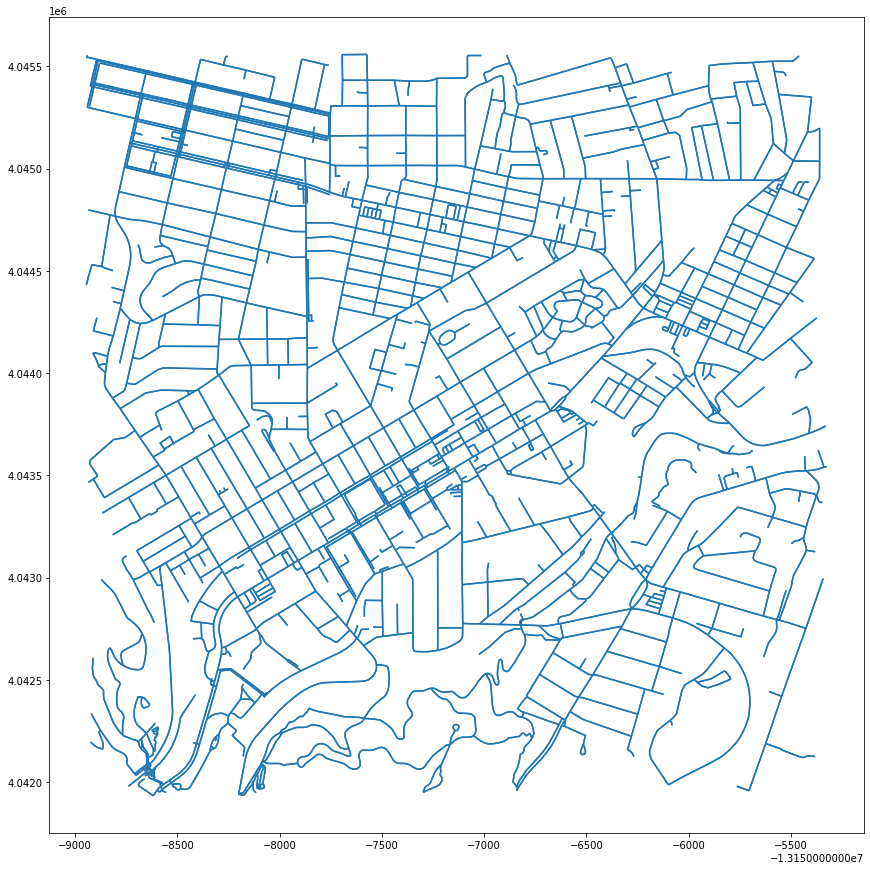

In [549]:
gdf_edges.plot(figsize=(15,15))

In [550]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13158945.382506957
4041933.3467410295
-13155325.361721948
4045557.8058276335


In [551]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13157135.372114453
4043745.5762843313


In [552]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node4 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node4))

The id for the nearest node is 111964509


In [553]:
# what is this record?
gdf_nodes.loc[[center_node4]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
111964509,4.043716e+06,-1.315713e+07,NaN,3,-118.192502,34.110999,POINT (-13157129.183 4043716.222)


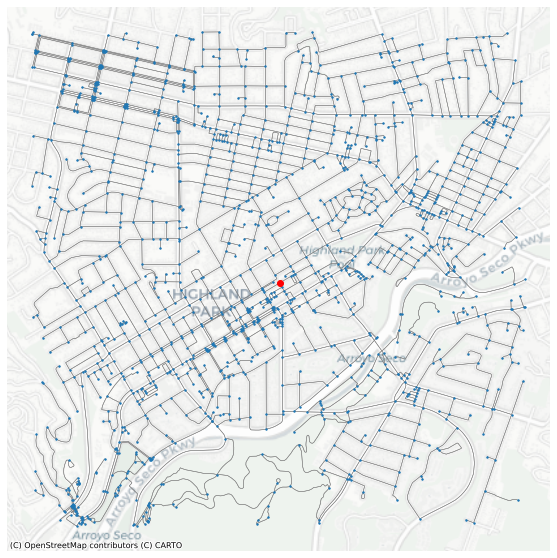

In [554]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node4]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [555]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel
u,v,key,,,,,,,,,,,,,,
16696234,19809029,0,167015959,NaN,Monte Vista Drive,tertiary,False,142.081,"LINESTRING (-13157789.574 4043556.105, -131579...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
123412778,19808998,0,167015950,NaN,Outlook Avenue,residential,False,34.793,"LINESTRING (-13156720.963 4044349.063, -131567...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
18364115,6725970685,0,173226987,NaN,Marmion Way,residential,False,15.149,"LINESTRING (-13157015.448 4043782.897, -131570...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
8462937520,1839531054,0,167276503,NaN,Phillips Way,residential,False,91.311,"LINESTRING (-13158049.027 4045338.764, -131580...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
8458827770,8458827769,0,910967535,NaN,NaN,footway,False,40.553,"LINESTRING (-13158894.498 4045533.856, -131589...",NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [556]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [557]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,service,access,bridge,maxspeed,junction,width,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,,
6822547828,1839531023,0,167273406,NaN,Stratford Road,residential,False,109.140,"LINESTRING (-13157838.800 4045165.097, -131579...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.364250
8395869942,8395869945,1,"[904016388, 904016389, 904016390]",NaN,NaN,service,False,93.264,"LINESTRING (-13157385.084 4043413.320, -131574...",NaN,customers,NaN,NaN,NaN,NaN,NaN,1.165800
19809040,8462937519,0,167015948,NaN,Avenue 53,residential,False,6.306,"LINESTRING (-13157941.403 4045307.648, -131579...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.078825
18364102,8793329993,0,167015945,NaN,Avenue 53,residential,False,58.281,"LINESTRING (-13157784.754 4043156.407, -131577...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.728513
123561080,8461167224,0,13432609,NaN,Lewis Street,residential,False,231.457,"LINESTRING (-13155745.804 4044943.401, -131557...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.893212


In [558]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [559]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [560]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 111964509, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 240 nodes within 10 minutes 


In [561]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
9114818702,4.043130e+06,-1.315652e+07,NaN,3,-118.186999,34.106640,POINT (-13156516.491 4043130.230),NaN,NaN
6820187777,4.042766e+06,-1.315796e+07,NaN,1,-118.199980,34.103929,POINT (-13157961.563 4042765.636),NaN,NaN
1839530941,4.044317e+06,-1.315737e+07,NaN,3,-118.194704,34.115465,POINT (-13157374.208 4044316.779),10 mins,#0d0887
8462927212,4.045296e+06,-1.315845e+07,NaN,4,-118.204393,34.122747,POINT (-13158452.872 4045295.841),NaN,NaN
1674218176,4.042995e+06,-1.315641e+07,NaN,3,-118.186080,34.105638,POINT (-13156414.289 4042995.410),NaN,NaN
21507184,4.043645e+06,-1.315696e+07,traffic_signals,3,-118.190994,34.110470,POINT (-13156961.246 4043645.138),10 mins,#0d0887
2317833925,4.043088e+06,-1.315844e+07,NaN,4,-118.204306,34.106329,POINT (-13158443.131 4043088.311),NaN,NaN
17737759,4.043380e+06,-1.315809e+07,NaN,4,-118.201097,34.108495,POINT (-13158085.918 4043379.641),NaN,NaN
5572567748,4.043971e+06,-1.315800e+07,NaN,1,-118.200357,34.112894,POINT (-13158003.575 4043970.984),NaN,NaN


In [562]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [563]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1840845410,4.044424e+06,-1.315594e+07,NaN,3,-118.181780,34.116265,POINT (-13155935.560 4044424.320),NaN,#cccccc
1842153464,4.043031e+06,-1.315671e+07,NaN,3,-118.188720,34.105901,POINT (-13156708.106 4043030.809),NaN,#cccccc
7148517781,4.043788e+06,-1.315786e+07,NaN,3,-118.199104,34.111534,POINT (-13157864.036 4043788.221),10 mins,#0d0887
6787989255,4.043430e+06,-1.315711e+07,NaN,3,-118.192322,34.108874,POINT (-13157109.090 4043430.490),NaN,#cccccc
6792106543,4.044202e+06,-1.315596e+07,NaN,3,-118.182011,34.114613,POINT (-13155961.285 4044202.208),NaN,#cccccc


<AxesSubplot:>

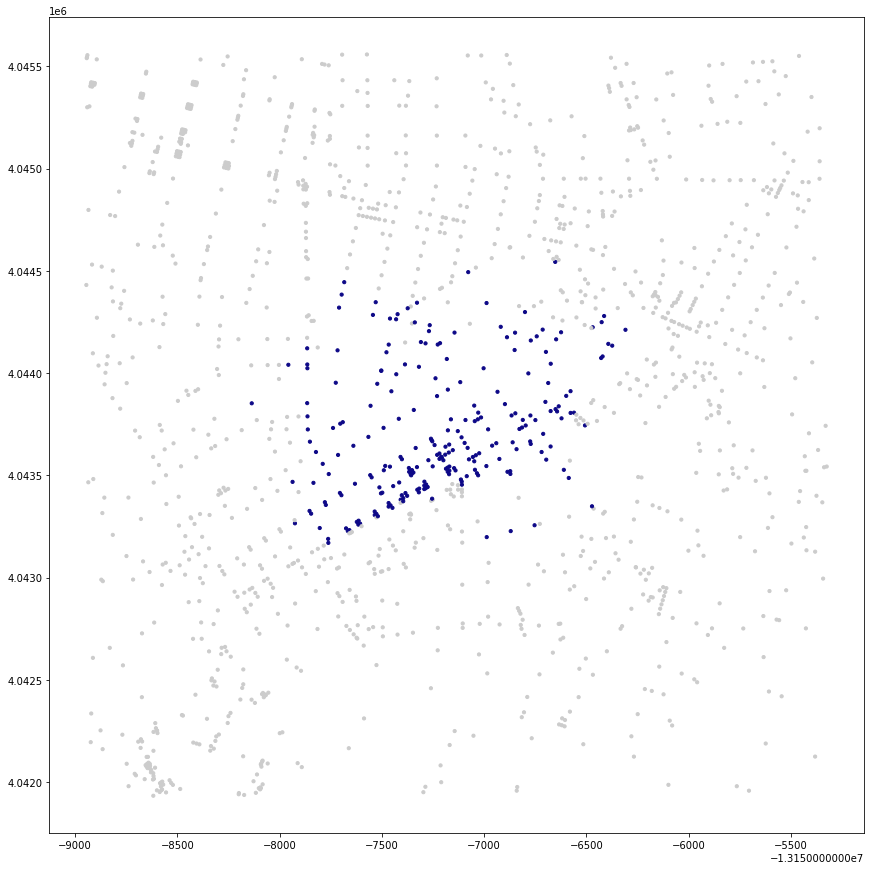

In [564]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

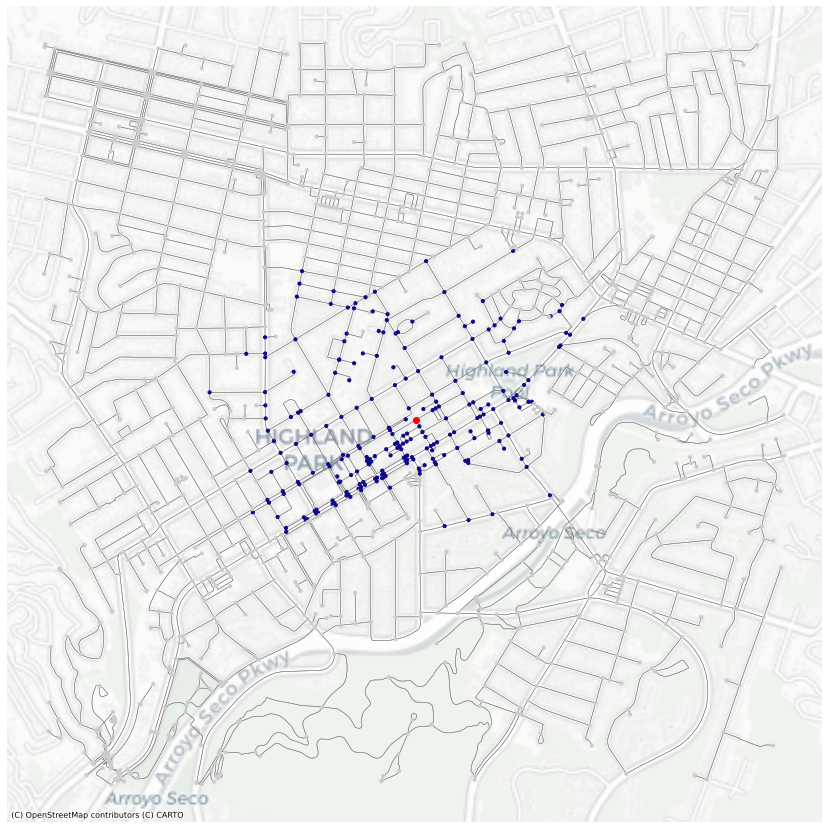

In [565]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node4]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [566]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
18364121,4.044212e+06,-1.315631e+07,NaN,3,-118.185137,34.114683,POINT (-13156309.315 4044211.620),10 mins,#0d0887
19809027,4.043265e+06,-1.315793e+07,NaN,3,-118.199655,34.107645,POINT (-13157925.418 4043265.308),10 mins,#0d0887
14760044,4.043814e+06,-1.315668e+07,traffic_signals,4,-118.188425,34.111728,POINT (-13156675.244 4043814.184),10 mins,#0d0887
702230871,4.043859e+06,-1.315670e+07,NaN,3,-118.188654,34.112062,POINT (-13156700.792 4043859.091),10 mins,#0d0887
6787726293,4.043824e+06,-1.315665e+07,NaN,3,-118.188208,34.111798,POINT (-13156651.143 4043823.650),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8410872932,4.043640e+06,-1.315719e+07,NaN,3,-118.193044,34.110432,POINT (-13157189.440 4043640.029),10 mins,#0d0887
8410872935,4.043651e+06,-1.315717e+07,NaN,3,-118.192880,34.110511,POINT (-13157171.228 4043650.597),10 mins,#0d0887
8459928442,4.043544e+06,-1.315725e+07,NaN,1,-118.193605,34.109716,POINT (-13157251.935 4043543.776),10 mins,#0d0887


In [567]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

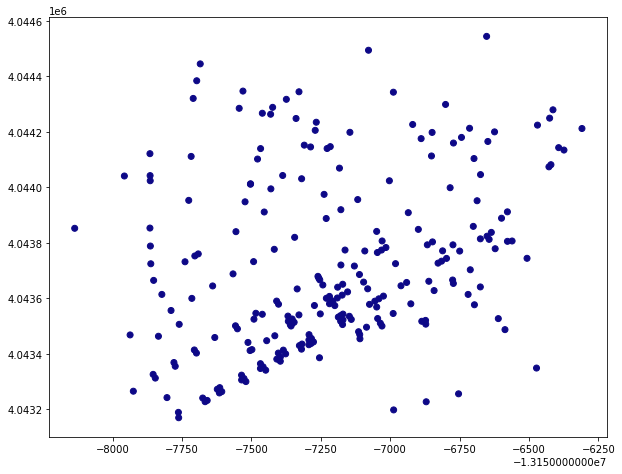

In [568]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

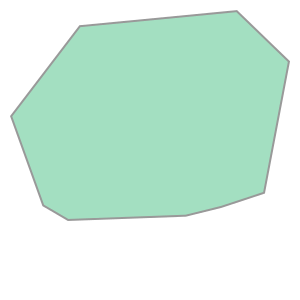

In [569]:
gdf_10.unary_union.convex_hull

In [570]:
# There's our polygon!
isochrones_hlp = gdf_nodes.dissolve("time")
isochrones_hlp

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13158136.669 4043852.127, -131579...",4.044212e+06,-1.315631e+07,traffic_signals,3,-118.185137,34.114683,#0d0887


In [571]:
isochrones_hlp = isochrones_hlp.convex_hull.reset_index()
isochrones_hlp

,time,0
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


In [572]:
isochrones_hlp.columns=['time','geometry']
isochrones_hlp

,time,geometry
0,10 mins,"POLYGON ((-13157762.101 4043169.744, -13157925..."


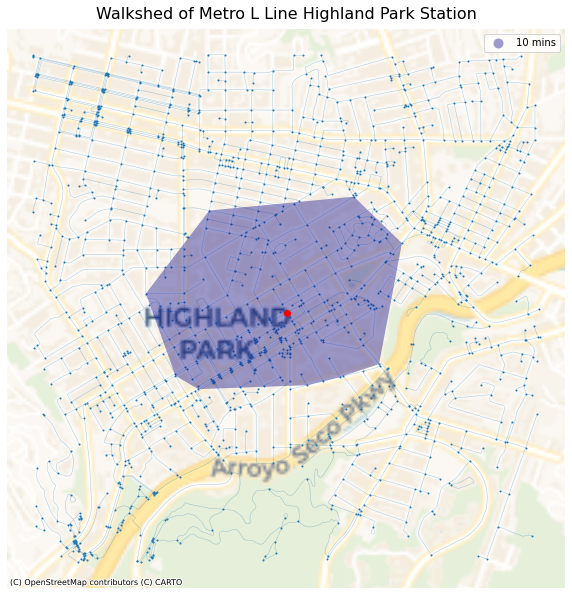

In [573]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_hlp.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Highland Park Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

In [574]:
highlandpark = gdf[gdf["FIPS"].isin(['06037183610', 
                                     '06037183510', 
                                     '06037183520',
                                     '06037183810',
                                     '06037183820',
                                     '06037183701',
                                     '06037183101',
                                     '06037183620']
                                      )
                     ]

In [575]:
highlandpark.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
5,06037183101,"Census Tract 1831.01, Los Angeles, CA",4231.0,1536.0,112.0,27.0,0.0,114.0,0.0,1353.0,...,202.0,0.0,35.0,8.0,34.0,34.0,-3.622162,NELA,Highland Park,"MULTIPOLYGON (((-118.18743 34.12817, -118.1855..."
14,06037183510,"Census Tract 1835.10, Los Angeles, CA",2982.0,1203.0,222.0,14.0,14.0,196.0,82.0,993.0,...,178.0,22.0,28.0,9.0,11.0,5.0,-11.238443,NELA,Highland Park,"MULTIPOLYGON (((-118.20800 34.11272, -118.2080..."
15,06037183520,"Census Tract 1835.20, Los Angeles, CA",3990.0,1714.0,345.0,22.0,0.0,11.0,0.0,1681.0,...,324.0,16.0,38.0,14.0,0.0,0.0,-8.071816,NELA,Highland Park,"MULTIPOLYGON (((-118.20733 34.11181, -118.2062..."
16,06037183610,"Census Tract 1836.10, Los Angeles, CA",3436.0,1597.0,291.0,3.0,0.0,171.0,12.0,1423.0,...,308.0,0.0,35.0,7.0,17.0,5.0,-8.189194,NELA,Highland Park,"MULTIPOLYGON (((-118.19796 34.11446, -118.1977..."
17,06037183620,"Census Tract 1836.20, Los Angeles, CA",3337.0,1779.0,469.0,0.0,0.0,314.0,0.0,1456.0,...,263.0,5.0,0.0,0.0,5.0,0.0,-15.220711,NELA,Highland Park,"MULTIPOLYGON (((-118.19448 34.11592, -118.1942..."


<AxesSubplot:>

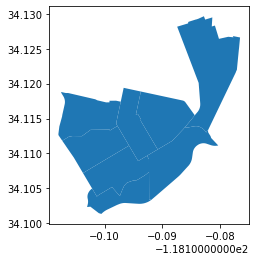

In [576]:
highlandpark.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

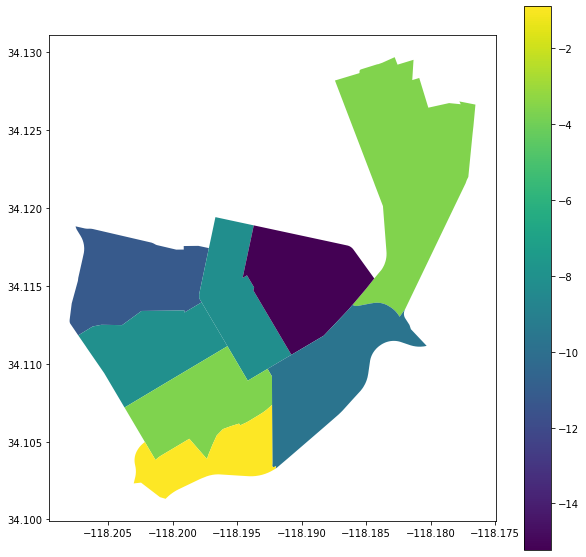

In [577]:
highlandpark.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [578]:
highlandpark_web_mercator = highlandpark.to_crs(epsg=3857)

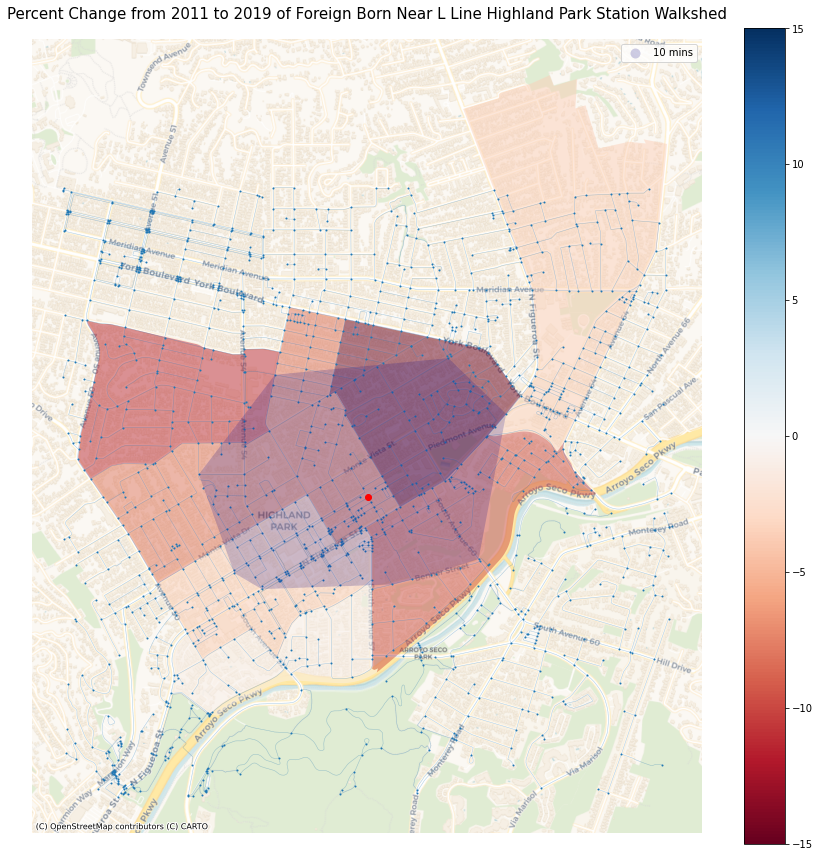

In [579]:
fig, ax = plt.subplots(figsize=(15, 15))
 
highlandpark_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.5,
                    cmap="RdBu")

# add the isochrones
isochrones_hlp.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)


# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Highland Park Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

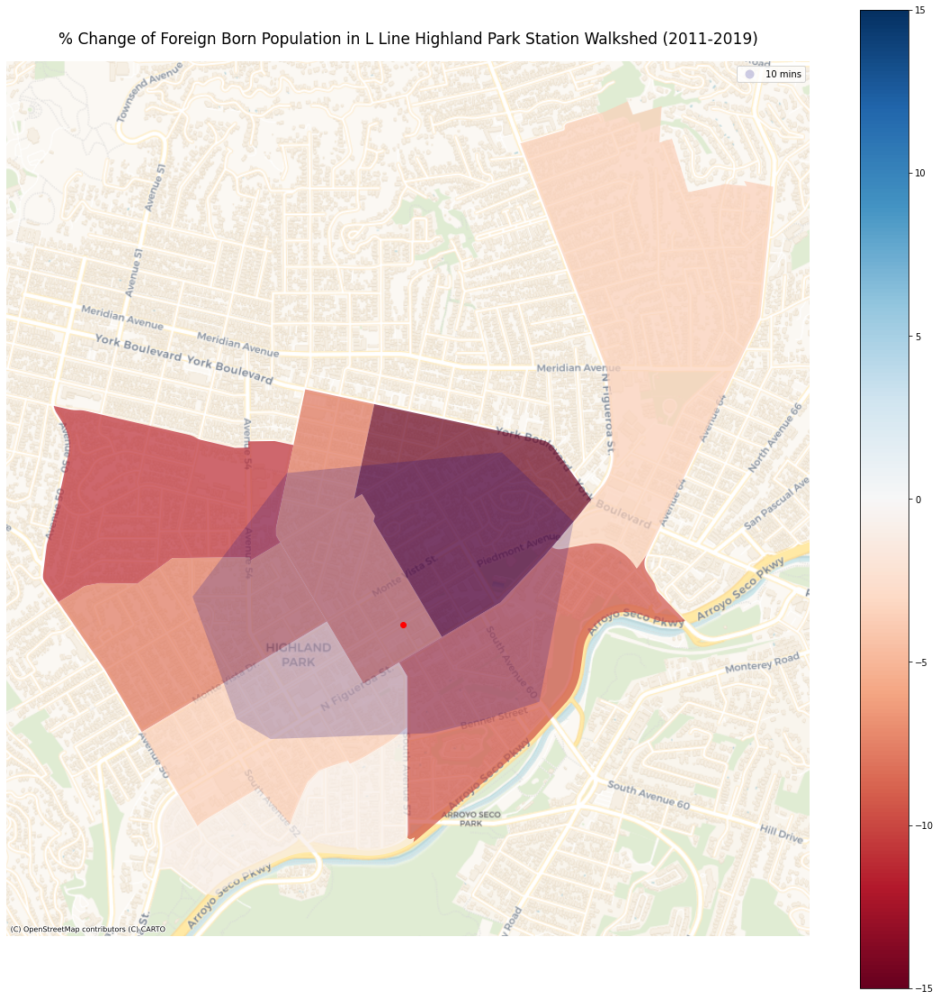

In [580]:
## clean with no nodes or edges

fig, ax = plt.subplots(figsize=(20, 20))
 
highlandpark_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")

# add the isochrones
isochrones_hlp.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node4]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born Population in L Line Highland Park Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("HLPStation_ForeignBorn.jpg")

### Percentage of Foreign Born Population in Metro L Line Heritage Square Station Walkshed

In [581]:
address = 'Heritage Square, Marmion Way, Dayton Avenue, Los Angeles, Los Angeles County, California, 90031-2212, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [582]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.75 s, sys: 21.5 ms, total: 2.77 s
Wall time: 2.79 s


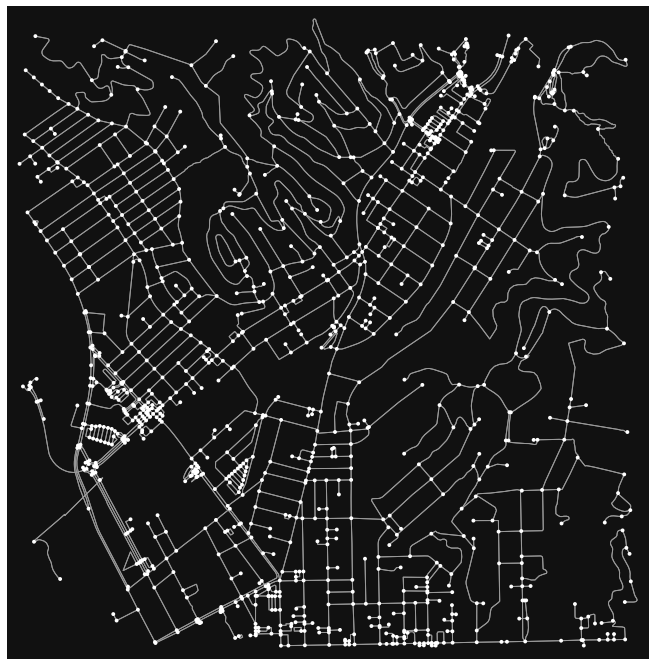

In [583]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [584]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [585]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [586]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
10559930,4.040461e+06,-1.316083e+07,traffic_signals,3,-118.225778,34.086785,POINT (-13160833.383 4040461.066)
6872663520,4.040451e+06,-1.316082e+07,NaN,4,-118.225648,34.086711,POINT (-13160818.979 4040451.213)
2156883458,4.040355e+06,-1.316083e+07,NaN,3,-118.225738,34.085997,POINT (-13160828.975 4040355.176)
18660349,4.040552e+06,-1.316084e+07,NaN,3,-118.225864,34.087459,POINT (-13160843.001 4040551.674)
14695503,4.040667e+06,-1.316087e+07,NaN,3,-118.226097,34.088318,POINT (-13160868.883 4040667.177)


### Plotting the station area

<AxesSubplot:>

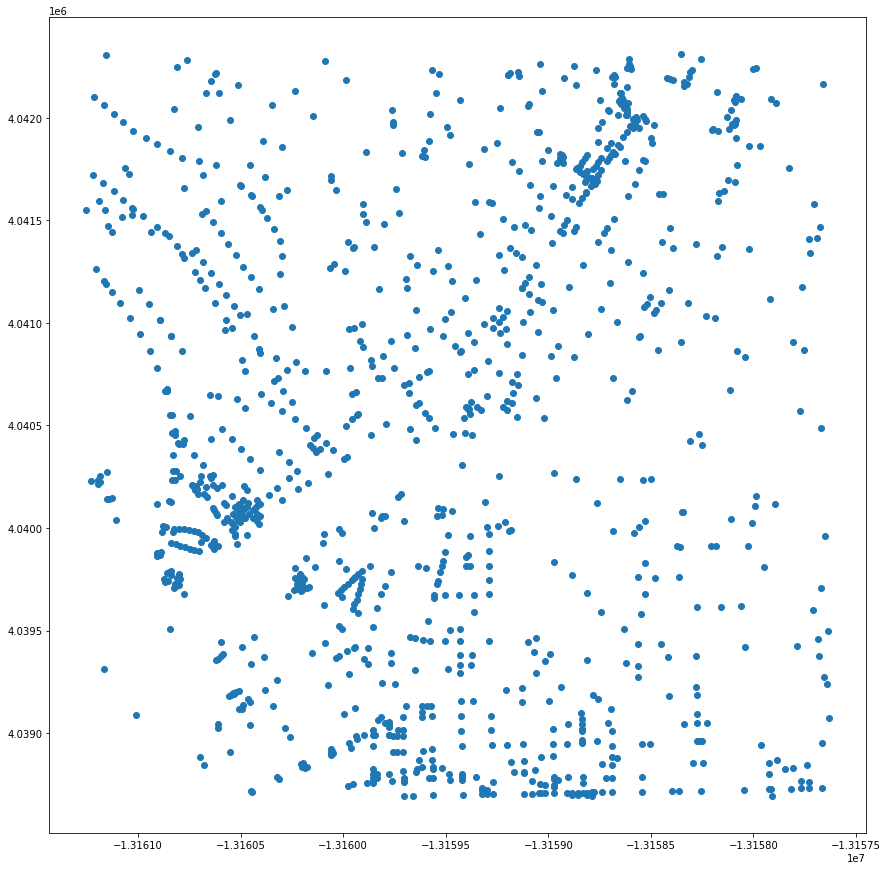

In [587]:
gdf_nodes.plot(figsize=(15,15))

In [588]:
gdf_edges.head()

osmid lanes               name    highway  \
u          v          key                                                  
10559930   6872663520 0    398375445     5     West Avenue 26    primary   
           2156883458 0    104359364   NaN  San Fernando Road  secondary   
           18660349   0    398374225     5  San Fernando Road    primary   
6872663520 10559930   0    398375445     5     West Avenue 26    primary   
           2156883447 0    398375445     5     West Avenue 26    primary   

                           oneway  length  \
u          v          key                   
10559930   6872663520 0     False  14.437   
           2156883458 0     False  87.691   
           18660349   0     False  75.390   
6872663520 10559930   0     False  14.437   
           2156883447 0     False  46.393   

                                                                    geometry  \
u          v          key                                                      
10559930   6872663520 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           2156883458 0    LINESTRING (-13160833.383 4040461.066, -131608...   
           18660349   0    LINESTRING (-13160833.383 4040461.066, -131608...   
6872663520 10559930   0    LINESTRING (-13160818.979 4040451.213, -131608...   
           2156883447 0    LINESTRING (-13160818.979 4040451.213, -131607...   

                          access service maxspeed bridge width tunnel junction  
u          v          key                                                       
10559930   6872663520 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883458 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           18660349   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
6872663520 10559930   0      NaN     NaN      NaN    NaN   NaN    NaN      NaN  
           2156883447 0      NaN     NaN      NaN    NaN   NaN    NaN      NaN

<AxesSubplot:>

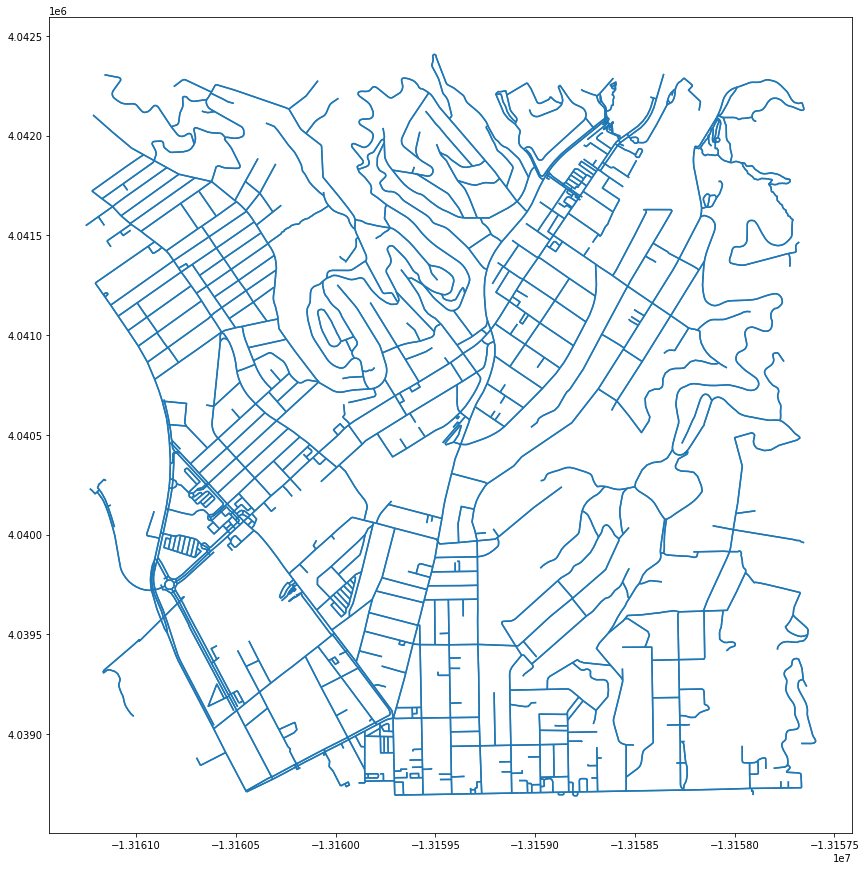

In [589]:
gdf_edges.plot(figsize=(15,15))

In [590]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161252.734988471
4038694.329905593
-13157631.255918141
4042309.5162158757


In [591]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13159441.995453306
4040501.9230607343


In [592]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node3 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node3))

The id for the nearest node is 1995905139


In [593]:
# what is this record?
gdf_nodes.loc[[center_node3]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
1995905139,4.040537e+06,-1.315941e+07,NaN,1,-118.213003,34.087353,POINT (-13159411.288 4040537.413)


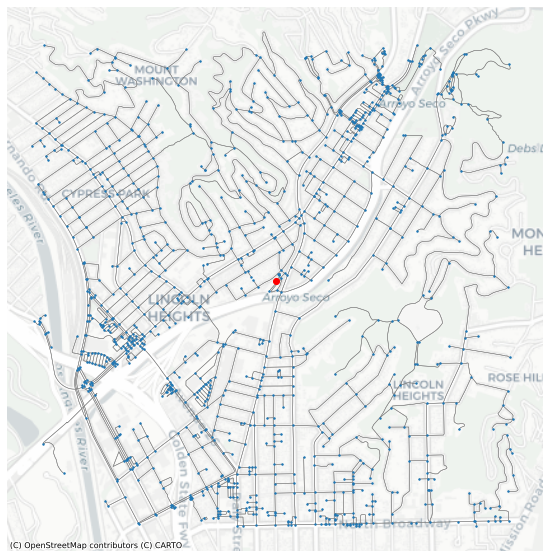

In [594]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node3]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [595]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction
u,v,key,,,,,,,,,,,,,,
6872663710,3645297881,0,733806859,NaN,NaN,footway,False,7.087,"LINESTRING (-13160057.108 4038896.296, -131600...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
8410662441,8410662436,0,3784012,NaN,Gates Street,residential,False,32.096,"LINESTRING (-13158689.993 4038881.271, -131586...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1613060117,7322050059,0,404036049,7,Cypress Avenue,tertiary,False,19.017,"LINESTRING (-13160774.852 4041316.435, -131607...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1995874967,1995874973,0,188954828,NaN,NaN,steps,False,21.733,"LINESTRING (-13160199.898 4039697.222, -131601...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
1853279703,1853279708,0,174674860,NaN,NaN,service,False,134.800,"LINESTRING (-13158905.118 4038785.408, -131589...",NaN,alley,NaN,NaN,NaN,NaN,NaN


In [596]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [597]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,oneway,length,geometry,access,service,maxspeed,bridge,width,tunnel,junction,walk_time
u,v,key,,,,,,,,,,,,,,,
6927746483,6927746484,0,739869851,NaN,NaN,service,False,60.066,"LINESTRING (-13159977.971 4039728.269, -131599...",no,parking_aisle,NaN,NaN,NaN,NaN,NaN,0.750825
5555657507,5555657497,0,580317755,NaN,NaN,service,False,16.457,"LINESTRING (-13158756.663 4041783.444, -131587...",NaN,parking_aisle,NaN,NaN,NaN,NaN,NaN,0.205713
1669488566,1669488632,0,154410745,NaN,Cedar Street,residential,False,95.800,"LINESTRING (-13159576.943 4040969.992, -131596...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.197500
18453047,18453049,0,173389829,NaN,Humboldt Street,residential,False,90.990,"LINESTRING (-13159930.827 4039587.428, -131600...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.137375
602721536,16988500,0,10535462,NaN,Woodside Drive,service,False,12.035,"LINESTRING (-13158579.531 4041998.290, -131585...",NaN,alley,NaN,NaN,NaN,NaN,NaN,0.150438


In [598]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [599]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [600]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, center_node3, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 142 nodes within 10 minutes 


In [601]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
8603138164,4.042264e+06,-1.315861e+07,NaN,3,-118.205761,34.100195,POINT (-13158605.134 4042263.661),NaN,NaN
16743870,4.041027e+06,-1.315922e+07,traffic_signals,4,-118.211310,34.090997,POINT (-13159222.891 4041027.214),10 mins,#0d0887
1882943981,4.039358e+06,-1.315881e+07,NaN,3,-118.207631,34.078577,POINT (-13158813.269 4039357.911),NaN,NaN
1669445979,4.041979e+06,-1.315976e+07,NaN,3,-118.216119,34.098077,POINT (-13159758.204 4041978.959),NaN,NaN
5555657507,4.041783e+06,-1.315876e+07,NaN,3,-118.207122,34.096622,POINT (-13158756.663 4041783.444),NaN,NaN
1873968963,4.041354e+06,-1.316072e+07,NaN,3,-118.224754,34.093429,POINT (-13160719.359 4041354.208),NaN,NaN
7082081805,4.040050e+06,-1.316048e+07,NaN,3,-118.222598,34.083725,POINT (-13160479.398 4040049.863),NaN,NaN
8411396565,4.041688e+06,-1.315882e+07,NaN,3,-118.207710,34.095913,POINT (-13158822.074 4041688.135),NaN,NaN
1669446301,4.042215e+06,-1.315953e+07,NaN,3,-118.214100,34.099831,POINT (-13159533.361 4042214.780),NaN,NaN


In [602]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [603]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
8623228026,4.041950e+06,-1.315856e+07,NaN,1,-118.205317,34.097858,POINT (-13158555.720 4041949.505),NaN,#cccccc
1669488706,4.041163e+06,-1.315983e+07,NaN,1,-118.216734,34.092010,POINT (-13159826.654 4041163.382),NaN,#cccccc
122598373,4.040106e+06,-1.315799e+07,NaN,3,-118.200271,34.084144,POINT (-13157994.013 4040106.060),NaN,#cccccc
7383899312,4.038737e+06,-1.315897e+07,NaN,3,-118.209069,34.073960,POINT (-13158973.346 4038737.362),NaN,#cccccc
1669488629,4.041056e+06,-1.315947e+07,NaN,3,-118.213559,34.091210,POINT (-13159473.193 4041055.886),10 mins,#0d0887


<AxesSubplot:>

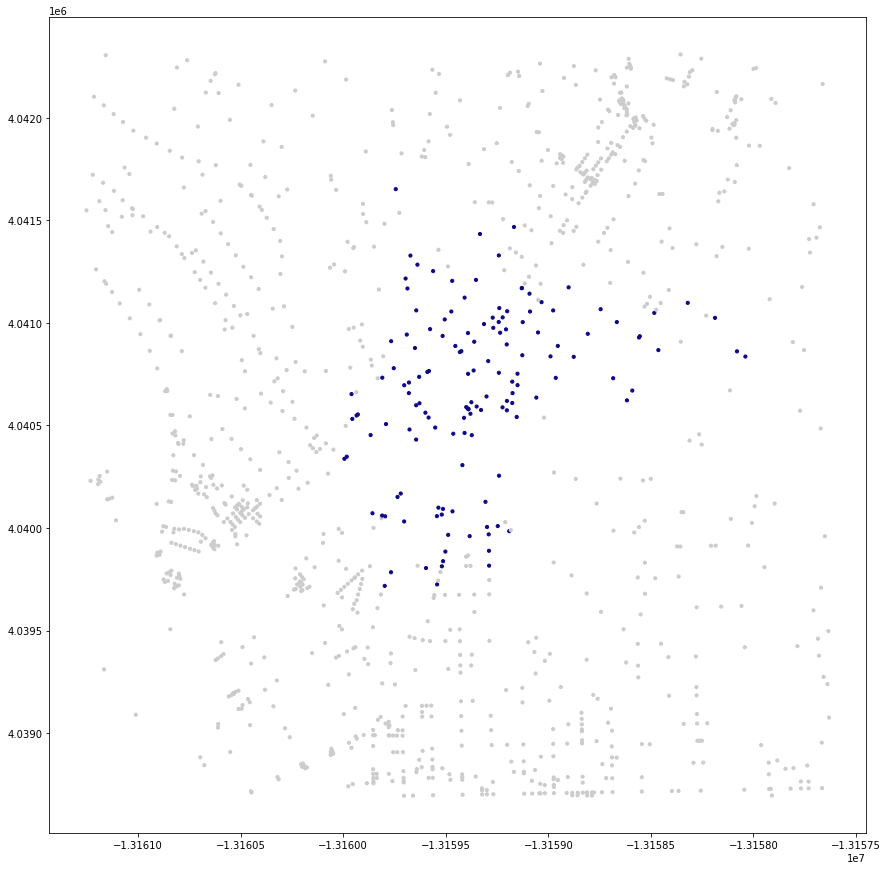

In [604]:
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

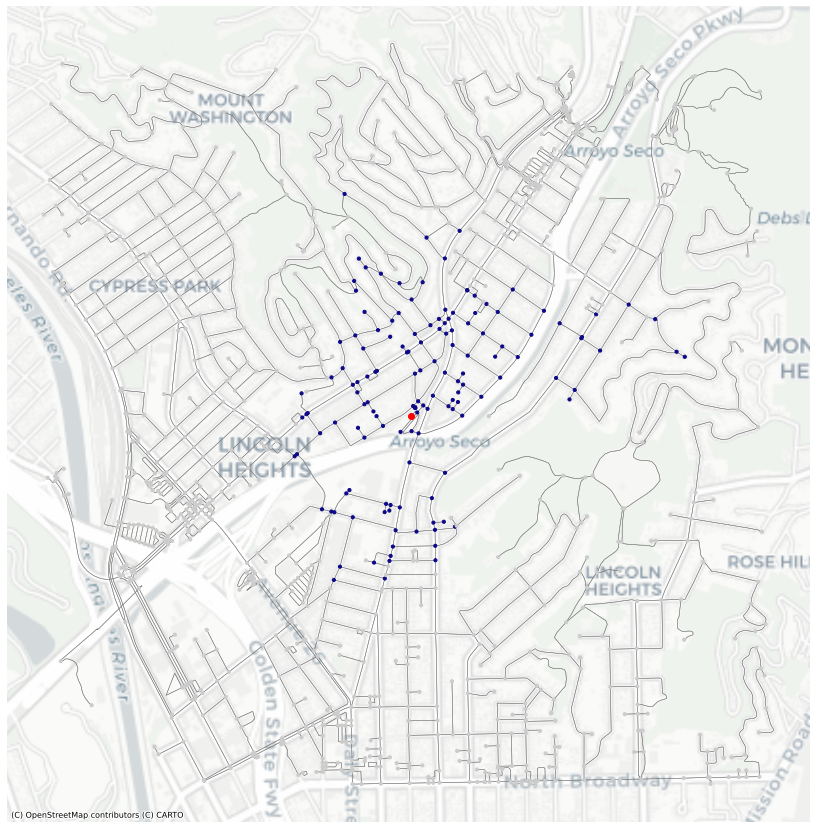

In [605]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[center_node3]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [606]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
14965940,4.040909e+06,-1.315936e+07,NaN,4,-118.212555,34.090114,POINT (-13159361.484 4040908.522),10 mins,#0d0887
1669488556,4.040951e+06,-1.315939e+07,NaN,3,-118.212831,34.090428,POINT (-13159392.130 4040950.824),10 mins,#0d0887
18361081,4.040814e+06,-1.315929e+07,NaN,4,-118.211944,34.089410,POINT (-13159293.389 4040813.959),10 mins,#0d0887
27292003,4.040862e+06,-1.315942e+07,NaN,3,-118.213120,34.089771,POINT (-13159424.323 4040862.484),10 mins,#0d0887
7497608094,4.040976e+06,-1.315927e+07,NaN,3,-118.211721,34.090619,POINT (-13159268.554 4040976.390),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7428386997,4.040562e+06,-1.315960e+07,NaN,1,-118.214695,34.087539,POINT (-13159599.618 4040562.454),10 mins,#0d0887
7874387046,4.040620e+06,-1.315920e+07,NaN,1,-118.211124,34.087967,POINT (-13159202.119 4040619.930),10 mins,#0d0887
8880638493,4.040737e+06,-1.315963e+07,NaN,3,-118.214969,34.088841,POINT (-13159630.198 4040737.422),10 mins,#0d0887


In [607]:
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

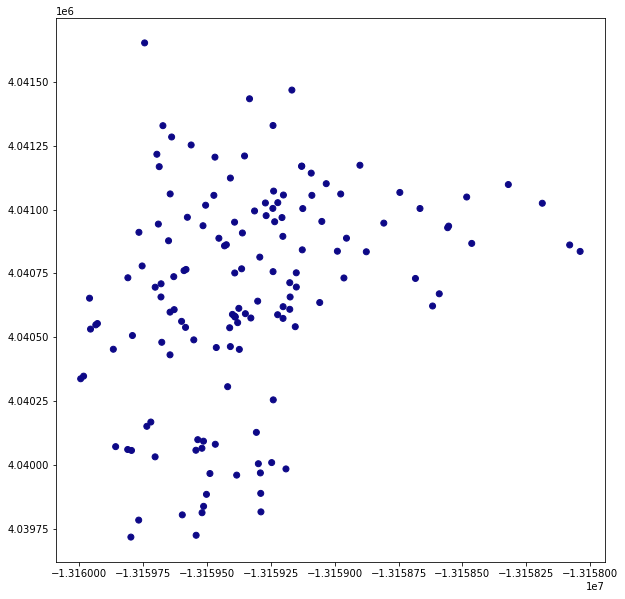

In [608]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

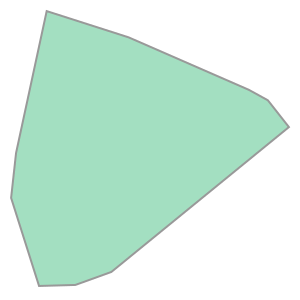

In [609]:
gdf_10.unary_union.convex_hull

In [610]:
# There's our polygon!
isochrones = gdf_nodes.dissolve("time")
isochrones

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13159994.736 4040337.648, -131599...",4.040909e+06,-1.315936e+07,traffic_signals,4,-118.212555,34.090114,#0d0887


In [611]:
isochrones = isochrones.convex_hull.reset_index()
isochrones

,time,0
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


In [612]:
isochrones.columns=['time','geometry']
isochrones

,time,geometry
0,10 mins,"POLYGON ((-13159798.112 4039717.732, -13159994..."


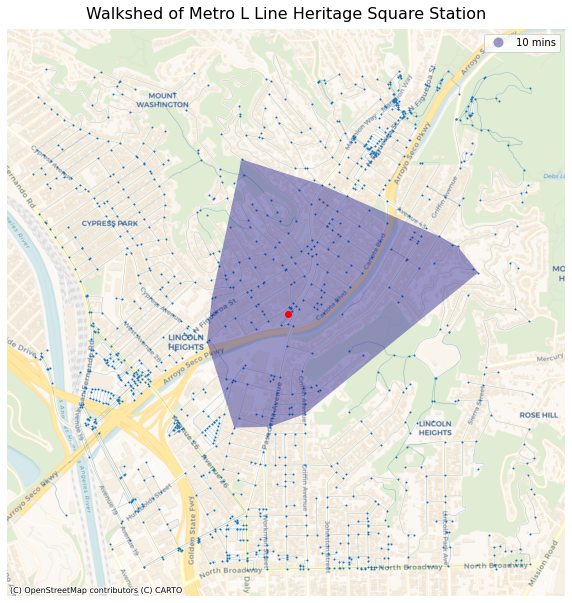

In [613]:
# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones.plot(alpha=0.4, 
                         ax=ax, 
                         column='time', 
                         cmap='plasma', 
                         legend=True,
                         zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Heritage Square Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

In [614]:
heritage = gdf[gdf["FIPS"].isin(['06037199000', 
                                     '06037185202', 
                                     '06037199400',
                                     '06037199300',
                                     '06037185310']
                                      )
                     ]

In [615]:
heritage.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
23,06037185202,"Census Tract 1852.02, Los Angeles, CA",3897.0,1312.0,315.0,68.0,58.0,194.0,37.0,1032.0,...,193.0,15.0,63.0,18.0,9.0,9.0,-5.323940,NELA,Heritage,"MULTIPOLYGON (((-118.22656 34.09795, -118.2265..."
26,06037185310,"Census Tract 1853.10, Los Angeles, CA",3398.0,1669.0,253.0,0.0,0.0,93.0,20.0,1563.0,...,214.0,62.0,33.0,0.0,8.0,8.0,-11.876629,NELA,Heritage,"MULTIPOLYGON (((-118.22881 34.09588, -118.2264..."
41,06037199000,"Census Tract 1990, Los Angeles, CA",4711.0,2501.0,555.0,6.0,0.0,1214.0,345.0,1281.0,...,607.0,126.0,19.0,0.0,46.0,0.0,-1.502540,NELA,Heritage,"MULTIPOLYGON (((-118.22723 34.08122, -118.2270..."
46,06037199300,"Census Tract 1993, Los Angeles, CA",4084.0,1331.0,151.0,50.0,10.0,278.0,84.0,984.0,...,239.0,0.0,52.0,15.0,63.0,30.0,2.392744,NELA,Heritage,"MULTIPOLYGON (((-118.21217 34.08388, -118.2120..."
47,06037199400,"Census Tract 1994, Los Angeles, CA",4822.0,2388.0,336.0,0.0,0.0,666.0,222.0,1722.0,...,401.0,98.0,0.0,0.0,19.0,0.0,-1.781897,NELA,Heritage,"MULTIPOLYGON (((-118.21481 34.07928, -118.2145..."


<AxesSubplot:>

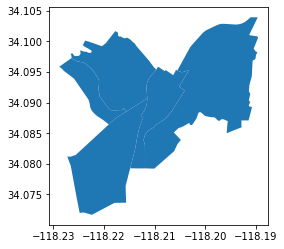

In [616]:
heritage.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

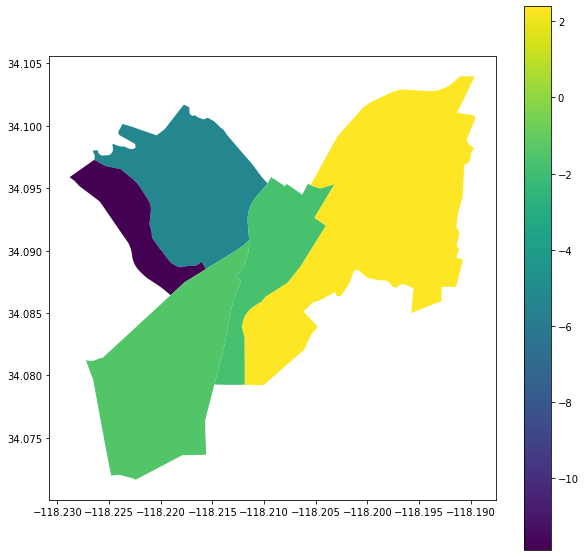

In [617]:
heritage.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [618]:
heritage_web_mercator = heritage.to_crs(epsg=3857)

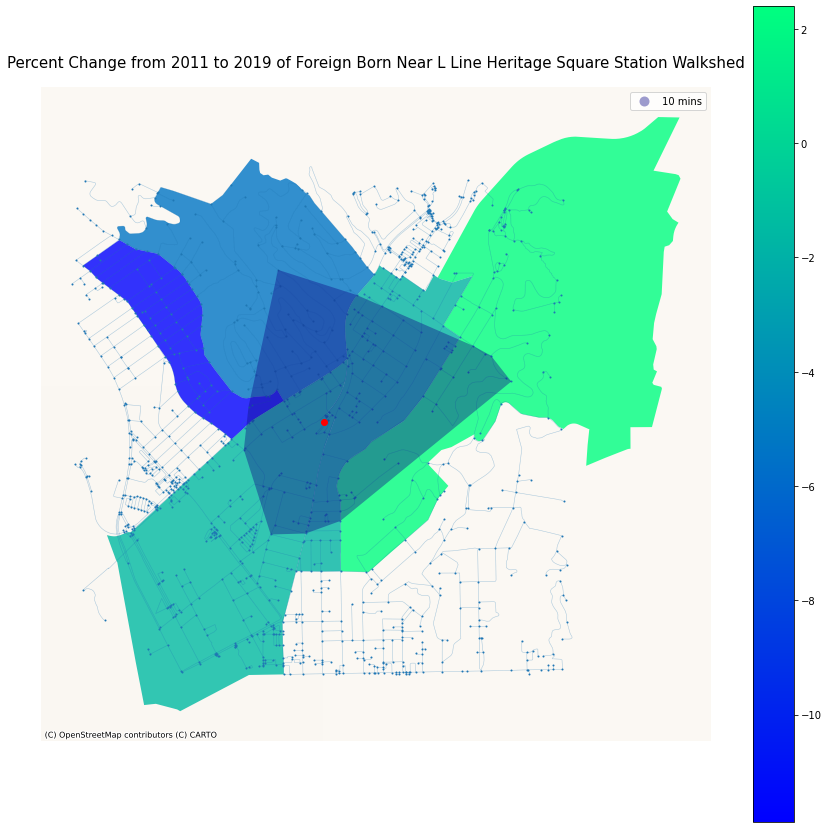

In [619]:
fig, ax = plt.subplots(figsize=(15, 15))
 
heritage_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Heritage Square Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

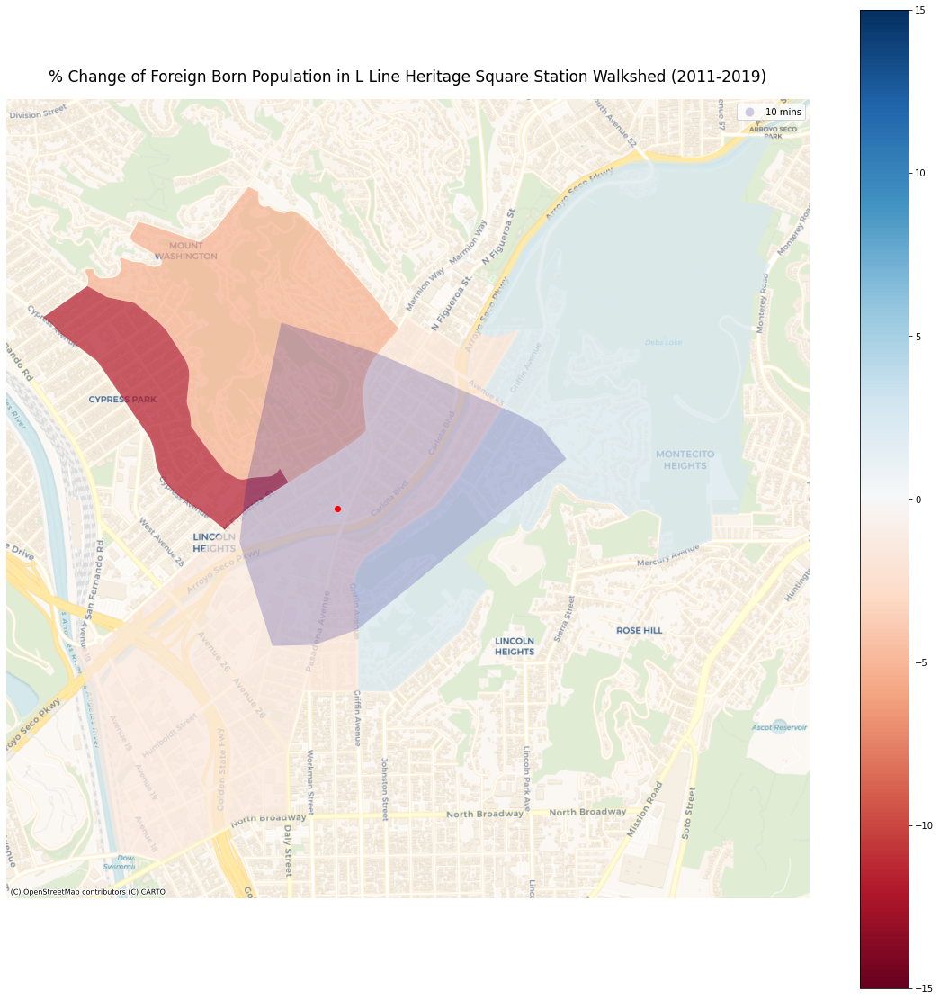

In [620]:
## running it again clean with no nodes or edges

fig, ax = plt.subplots(figsize=(20, 20))
 
heritage_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax,
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")

# add the isochrones
isochrones.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node3]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born Population in L Line Heritage Square Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("HeritageSquareStation_ForeignBorn.jpg")

### Percentage of Foreign Born Population in Metro L Line Mariachi Plaza Station Walkshed

In [621]:
# Let's start by orienting ourselves around the Mariachi Plaza Station by calling for it by address in osmnx

address = 'Mariachi Plaza, Metro Gold Line Entrance, Brooklyn Heights, Boyle Heights, Los Angeles, Los Angeles County, California, 90033, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [622]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.79 s, sys: 37.3 ms, total: 2.82 s
Wall time: 2.83 s


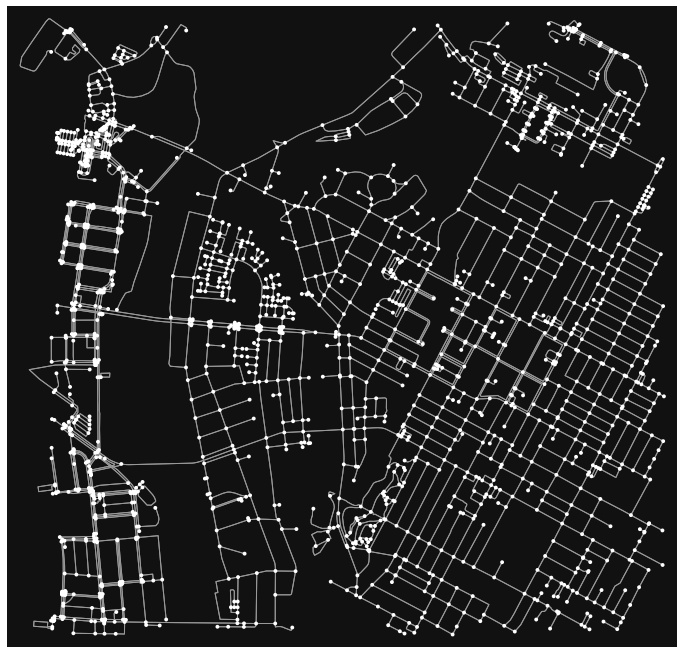

In [623]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [624]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [625]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [626]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
14941481,4.036783e+06,-1.315848e+07,stop,3,-118.204655,34.059417,POINT (-13158481.982 4036783.097)
8772109642,4.036793e+06,-1.315848e+07,crossing,4,-118.204605,34.059495,POINT (-13158476.416 4036793.498)
604238739,4.036724e+06,-1.315839e+07,NaN,4,-118.203870,34.058981,POINT (-13158394.652 4036724.445)
15373745,4.036812e+06,-1.315854e+07,NaN,3,-118.205136,34.059632,POINT (-13158535.560 4036812.014)
14941485,4.036619e+06,-1.315836e+07,NaN,3,-118.203524,34.058197,POINT (-13158356.146 4036619.141)


<AxesSubplot:>

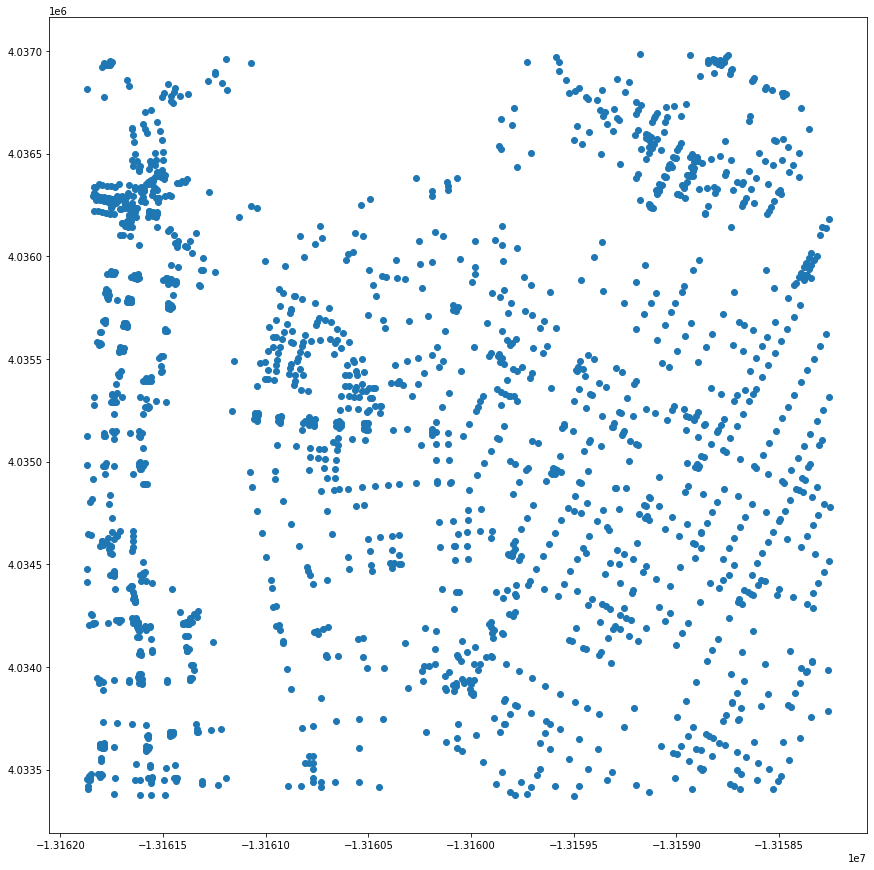

In [627]:
gdf_nodes.plot(figsize=(15,15))

In [628]:
gdf_edges.head()

osmid              name      highway  oneway  \
u          v          key                                                     
14941481   8772109642 0    161709222  San Pablo Street  residential   False   
           604238739  0    161709223      Zonal Avenue  residential   False   
           15373745   0    161709223      Zonal Avenue  residential   False   
8772109642 14941481   0    161709222  San Pablo Street  residential   False   
           8772216945 0    947706656               NaN      footway   False   

                           length  \
u          v          key           
14941481   8772109642 0     9.762   
           604238739  0    87.618   
           15373745   0    50.384   
8772109642 14941481   0     9.762   
           8772216945 0     9.079   

                                                                    geometry  \
u          v          key                                                      
14941481   8772109642 0    LINESTRING (-13158481.982 4036783.097, -131584...   
           604238739  0    LINESTRING (-13158481.982 4036783.097, -131584...   
           15373745   0    LINESTRING (-13158481.982 4036783.097, -131584...   
8772109642 14941481   0    LINESTRING (-13158476.416 4036793.498, -131584...   
           8772216945 0    LINESTRING (-13158476.416 4036793.498, -131584...   

                          lanes maxspeed access bridge service tunnel width  
u          v          key                                                    
14941481   8772109642 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           604238739  0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           15373745   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
8772109642 14941481   0     NaN      NaN    NaN    NaN     NaN    NaN   NaN  
           8772216945 0     NaN      NaN    NaN    NaN     NaN    NaN   NaN

<AxesSubplot:>

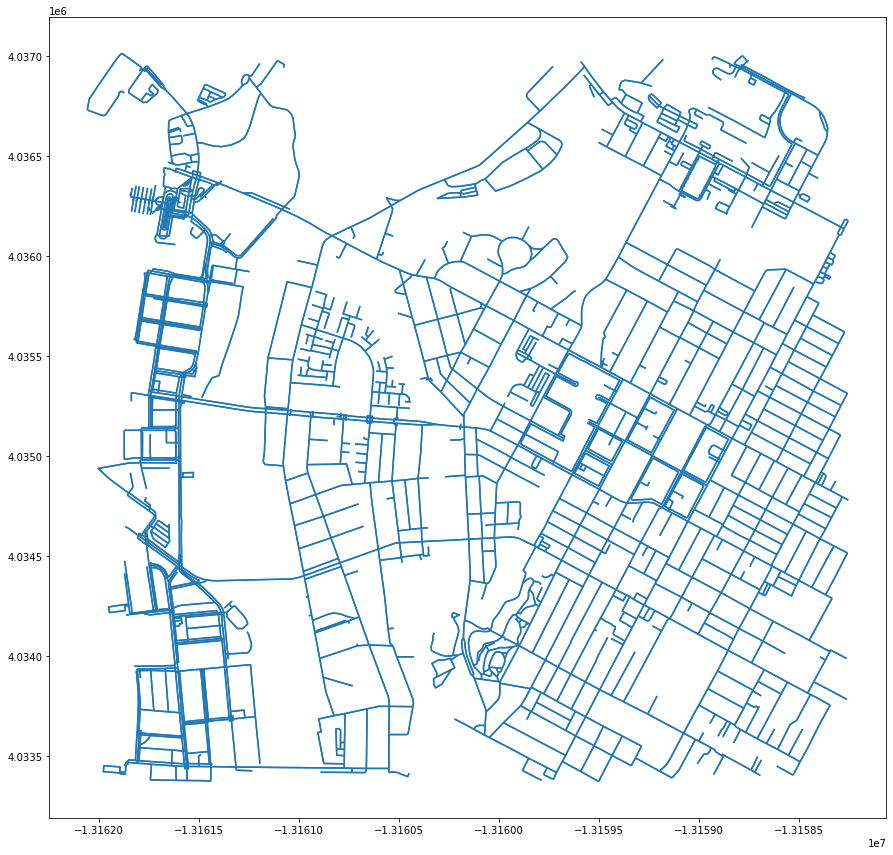

In [629]:
gdf_edges.plot(figsize=(15,15))

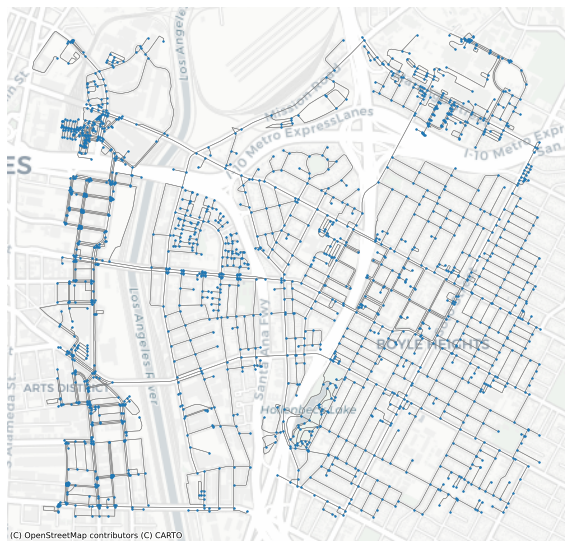

In [630]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [631]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13161872.984927278
4033373.0514499233
-13158251.594912536
4036983.296539621


In [632]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13160062.289919907
4035178.173994772


In [633]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node2 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node2))

The id for the nearest node is 2935903748


In [634]:
# what is this record?
gdf_nodes.loc[[center_node2]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
2935903748,4.035186e+06,-1.316001e+07,NaN,3,-118.218374,34.047528,POINT (-13160009.241 4035185.662)


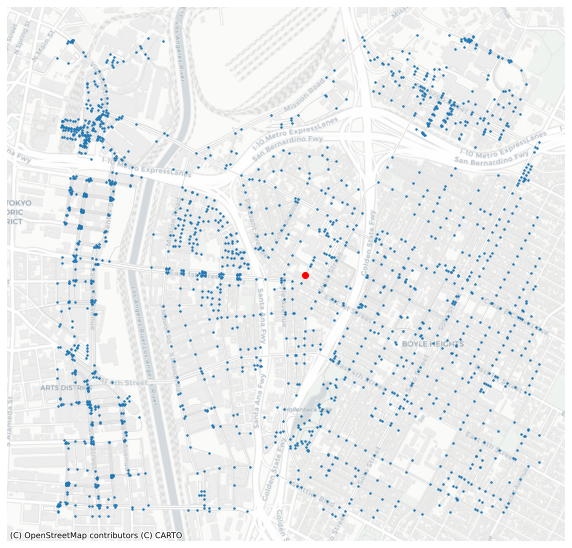

In [635]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node2]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron)

In [636]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width
u,v,key,,,,,,,,,,,,,
8566332175,2445074378,0,"[922789538, 236481971]",Bauchet Street,residential,False,569.083,"LINESTRING (-13161071.295 4036245.659, -131610...",NaN,NaN,no,NaN,NaN,NaN,NaN
7257171965,7257171964,0,777637060,NaN,service,False,17.060,"LINESTRING (-13159590.557 4034940.864, -131595...",NaN,NaN,customers,NaN,NaN,NaN,NaN
7704130773,4874875066,0,825090471,NaN,service,False,3.785,"LINESTRING (-13161723.516 4034644.241, -131617...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN
5765836480,8186467143,0,608632484,NaN,service,False,120.818,"LINESTRING (-13159305.590 4036715.886, -131592...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN
72744268,122620383,0,47798518,East 4th Street,primary,False,92.538,"LINESTRING (-13160382.907 4034571.655, -131604...",4,NaN,NaN,NaN,NaN,NaN,NaN


In [637]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [638]:
gdf_edges.sample(5)

,,,osmid,name,highway,oneway,length,geometry,lanes,maxspeed,access,bridge,service,tunnel,width,walk_time
u,v,key,,,,,,,,,,,,,,
3611041523,9071150193,0,161689966,Commercial Street,unclassified,False,6.113,"LINESTRING (-13161445.474 4035873.465, -131614...",2,NaN,NaN,NaN,NaN,NaN,NaN,0.076413
6208583548,8881865775,0,663272179,NaN,steps,False,10.529,"LINESTRING (-13161667.934 4036158.780, -131616...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.131612
5544253262,5544253263,0,578702714,NaN,service,False,17.278,"LINESTRING (-13159794.628 4035452.808, -131597...",NaN,NaN,NaN,NaN,parking_aisle,NaN,NaN,0.215975
9511214635,9511214632,0,1032086459,NaN,footway,False,124.840,"LINESTRING (-13161667.144 4034387.190, -131616...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.560500
2481931157,2481931420,0,240456445,NaN,footway,False,47.769,"LINESTRING (-13160072.147 4033909.629, -131600...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.597112


In [639]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [640]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [641]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 2935903748, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 287 nodes within 10 minutes 


In [642]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
4984174722,4.036563e+06,-1.315876e+07,NaN,1,-118.207161,34.057782,POINT (-13158761.015 4036563.325),NaN,NaN
605181894,4.034015e+06,-1.315983e+07,NaN,3,-118.216779,34.038817,POINT (-13159831.586 4034015.339),NaN,NaN
4749829559,4.035153e+06,-1.316050e+07,NaN,1,-118.222815,34.047287,POINT (-13160503.544 4035153.270),10 mins,#0d0887
7882619512,4.036822e+06,-1.316144e+07,NaN,3,-118.231250,34.059705,POINT (-13161442.590 4036821.836),NaN,NaN
9109609221,4.034191e+06,-1.316159e+07,NaN,3,-118.232540,34.040127,POINT (-13161586.159 4034191.389),NaN,NaN
604238485,4.033618e+06,-1.315876e+07,NaN,3,-118.207196,34.035862,POINT (-13158764.922 4033618.420),NaN,NaN
7179474991,4.036347e+06,-1.315897e+07,NaN,1,-118.209076,34.056174,POINT (-13158974.103 4036347.264),NaN,NaN
9511090811,4.035948e+06,-1.316143e+07,NaN,1,-118.231104,34.053201,POINT (-13161426.293 4035947.860),NaN,NaN
123304343,4.035652e+06,-1.315958e+07,NaN,3,-118.214558,34.050997,POINT (-13159584.412 4035651.694),10 mins,#0d0887


In [643]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [644]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
2481931087,4.034143e+06,-1.315989e+07,NaN,3,-118.217311,34.039766,POINT (-13159890.908 4034142.825),NaN,#cccccc
8461184772,4.034303e+06,-1.315943e+07,NaN,3,-118.213157,34.040954,POINT (-13159428.420 4034302.501),NaN,#cccccc
604238323,4.035116e+06,-1.316065e+07,NaN,3,-118.224107,34.047007,POINT (-13160647.368 4035115.598),NaN,#cccccc
3187992233,4.033981e+06,-1.316024e+07,NaN,3,-118.220422,34.038558,POINT (-13160237.212 4033980.653),NaN,#cccccc
279044123,4.036950e+06,-1.316176e+07,NaN,3,-118.234090,34.060662,POINT (-13161758.649 4036950.335),NaN,#cccccc


<AxesSubplot:>

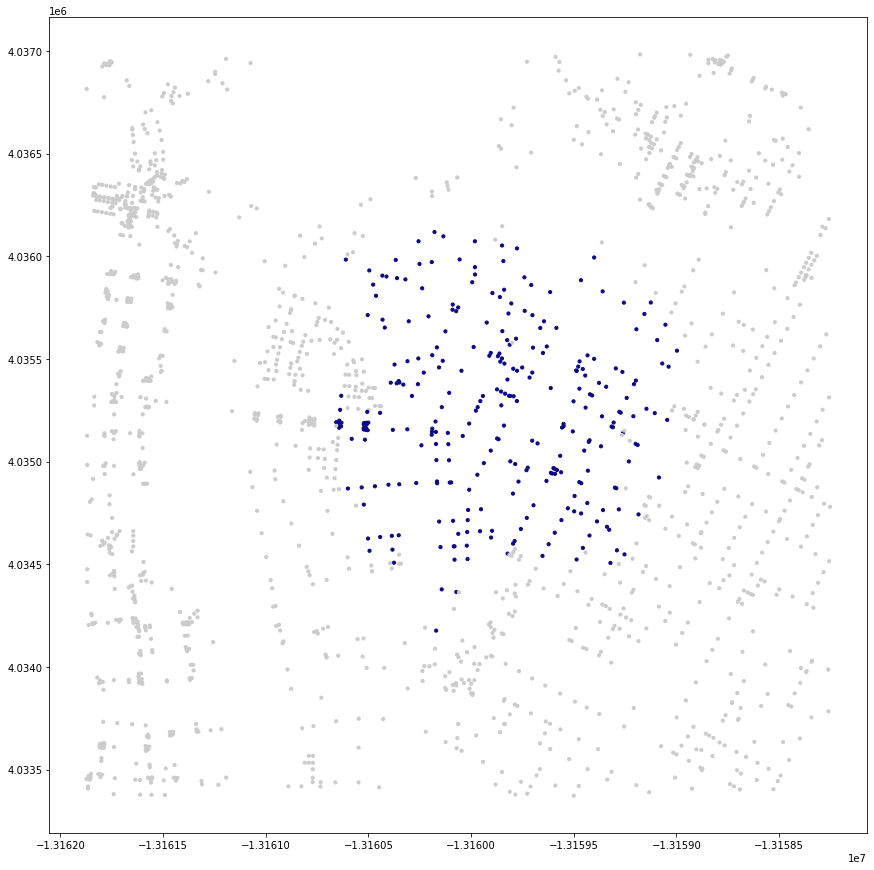

In [645]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

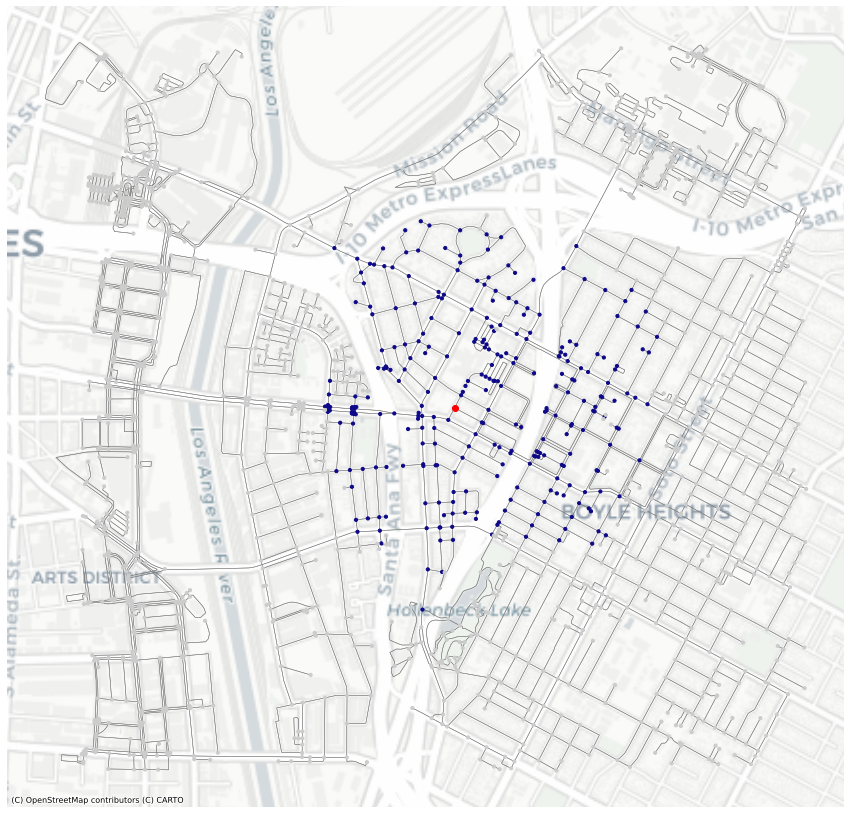

In [646]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[2935903748]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [647]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
15713713,4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,POINT (-13160148.902 4034583.948),10 mins,#0d0887
604238292,4.034588e+06,-1.316008e+07,NaN,3,-118.219048,34.043076,POINT (-13160084.214 4034587.562),10 mins,#0d0887
72744268,4.034572e+06,-1.316038e+07,NaN,4,-118.221731,34.042958,POINT (-13160382.907 4034571.655),10 mins,#0d0887
604238295,4.034708e+06,-1.316016e+07,NaN,3,-118.219688,34.043976,POINT (-13160155.503 4034708.498),10 mins,#0d0887
123413088,4.034378e+06,-1.316014e+07,NaN,3,-118.219576,34.041517,POINT (-13160143.013 4034378.068),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
7875081594,4.035722e+06,-1.315982e+07,NaN,1,-118.216658,34.051518,POINT (-13159818.138 4035721.748),10 mins,#0d0887
8395946642,4.034758e+06,-1.315950e+07,NaN,1,-118.213780,34.044345,POINT (-13159497.750 4034757.991),10 mins,#0d0887
8395946644,4.034748e+06,-1.315946e+07,NaN,1,-118.213476,34.044269,POINT (-13159463.975 4034747.888),10 mins,#0d0887


In [648]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

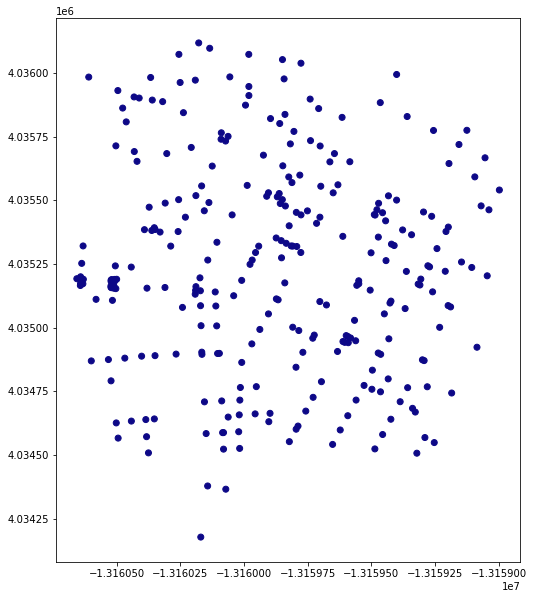

In [649]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

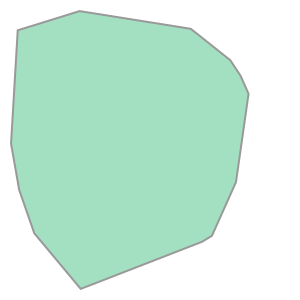

In [650]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [651]:
isochrones_mariachi = gdf_nodes.dissolve("time")
isochrones_mariachi

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13160656.853 4035192.232, -131606...",4.034584e+06,-1.316015e+07,traffic_signals,4,-118.219629,34.043049,#0d0887


In [652]:
isochrones_mariachi = isochrones_mariachi.convex_hull.reset_index()
isochrones_mariachi

,time,0
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


In [653]:
isochrones_mariachi.columns=['time','geometry']
isochrones_mariachi

,time,geometry
0,10 mins,"POLYGON ((-13160169.964 4034177.270, -13160494..."


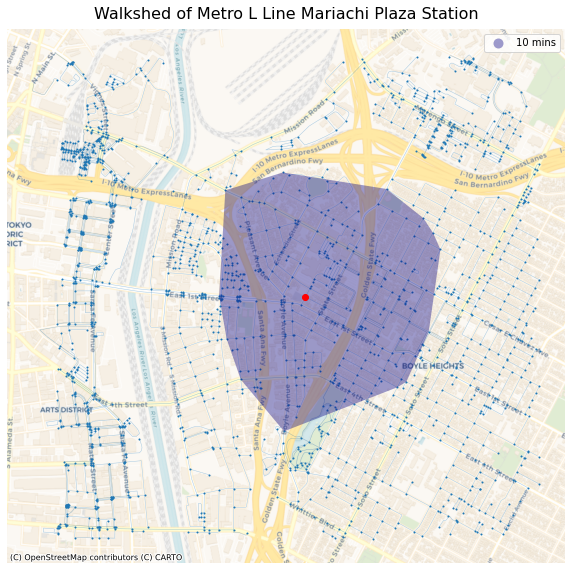

In [654]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_mariachi.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node2]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line Mariachi Plaza Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

In [655]:
mariachi = gdf[gdf["FIPS"].isin(['06037203500', 
                                 '06037203600', 
                                 '06037204410',
                                 '06037204420',
                                 '06037204600',
                                 '06037206050',
                                 '06037206032']
                                    )
                     ]

In [656]:
mariachi.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
66,06037203500,"Census Tract 2035, Los Angeles, CA",3339.0,1459.0,335.0,0.0,0.0,375.0,221.0,1075.0,...,151.0,0.0,0.0,0.0,0.0,0.0,-2.416048,Central LA,Mariachi,"MULTIPOLYGON (((-118.22845 34.05311, -118.2284..."
67,06037203600,"Census Tract 2036, Los Angeles, CA",4572.0,2072.0,512.0,0.0,0.0,0.0,0.0,2072.0,...,314.0,102.0,44.0,11.0,0.0,0.0,-2.559669,East LA,Mariachi,"MULTIPOLYGON (((-118.21404 34.05515, -118.2140..."
76,06037204410,"Census Tract 2044.10, Los Angeles, CA",2239.0,1264.0,370.0,2.0,0.0,0.0,0.0,1262.0,...,132.0,49.0,0.0,0.0,0.0,0.0,-10.473191,East LA,Mariachi,"MULTIPOLYGON (((-118.21841 34.04440, -118.2183..."
77,06037204420,"Census Tract 2044.20, Los Angeles, CA",3719.0,2077.0,522.0,0.0,0.0,39.0,0.0,2038.0,...,189.0,41.0,0.0,0.0,0.0,0.0,-10.857858,East LA,Mariachi,"MULTIPOLYGON (((-118.21489 34.04315, -118.2143..."
78,06037204600,"Census Tract 2046, Los Angeles, CA",4566.0,2412.0,690.0,0.0,0.0,0.0,0.0,2412.0,...,244.0,54.0,21.0,0.0,14.0,14.0,-13.315426,East LA,Mariachi,"MULTIPOLYGON (((-118.22040 34.02978, -118.2203..."


<AxesSubplot:>

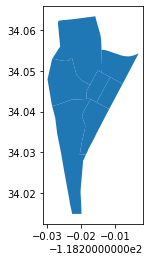

In [657]:
mariachi.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

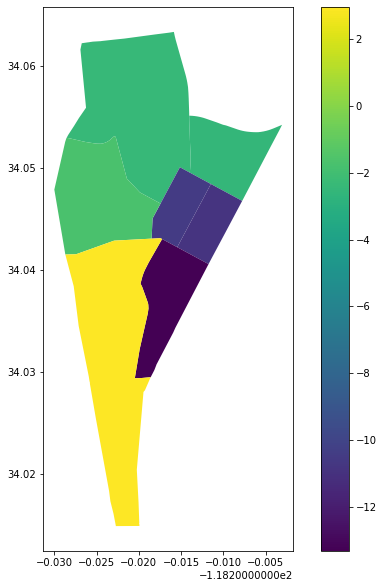

In [658]:
mariachi.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [659]:
mariachi_web_mercator = mariachi.to_crs(epsg=3857)

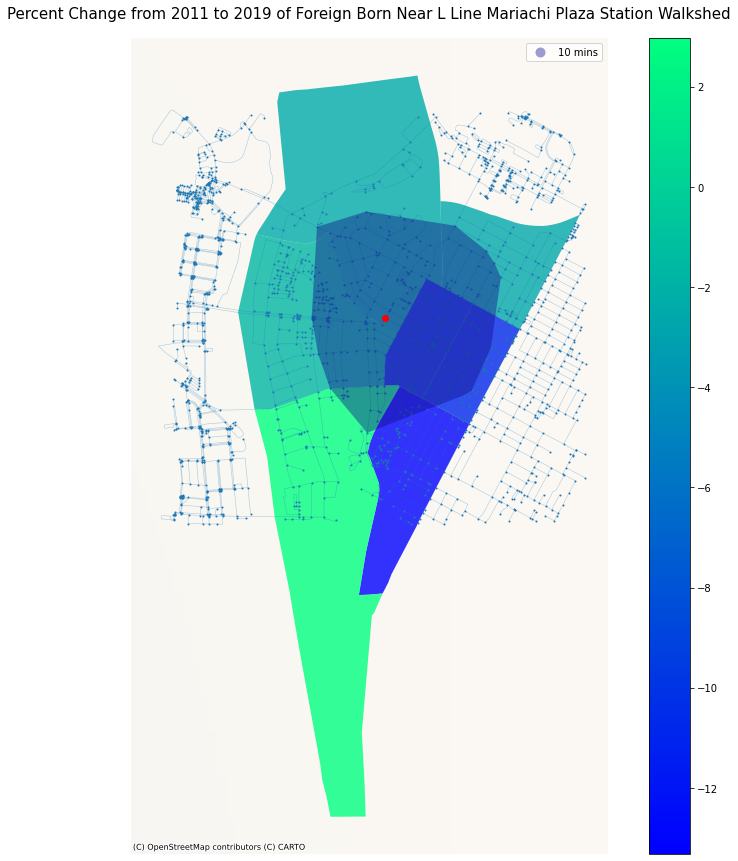

In [660]:
fig, ax = plt.subplots(figsize=(15, 15))
 
mariachi_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones_mariachi.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node2]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line Mariachi Plaza Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

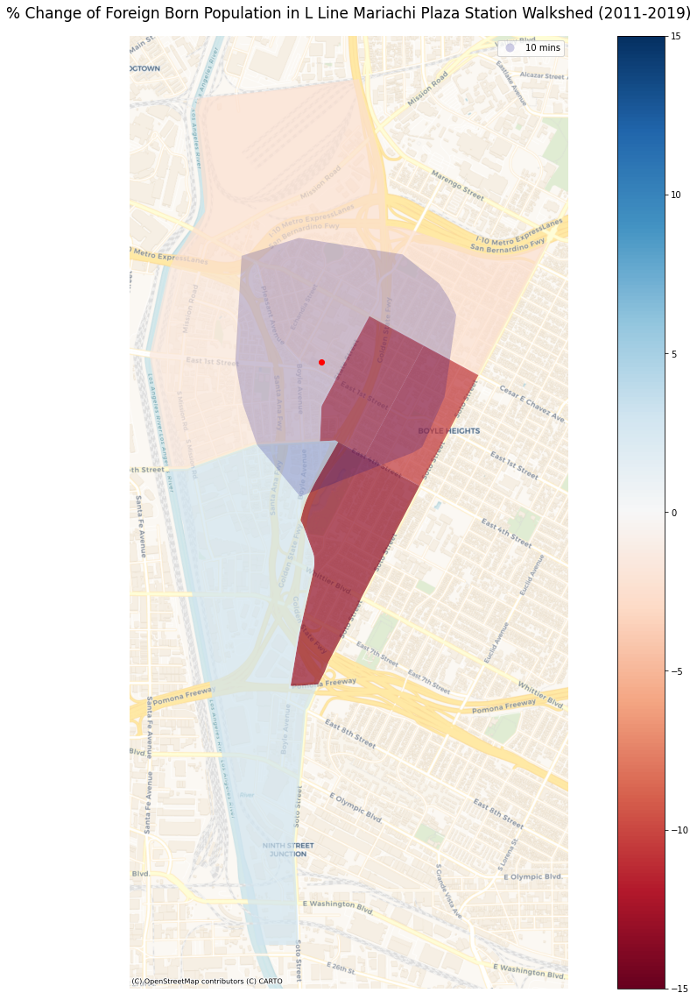

In [661]:
### updating it with our new cmap, max, min, and deleting the nodes and edges

fig, ax = plt.subplots(figsize=(20, 20))
 
mariachi_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")

# add the isochrones
isochrones_mariachi.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node2]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born Population in L Line Mariachi Plaza Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("MariachiPlazaStation_ForeignBorn.jpg")

### Percentage of Foreign Born Population in Metro L Line East LA Civic Center Station Walkshed

In [662]:
# Let's start by orienting ourselves around the East LA Civic Center Station by calling for it by address in osmnx

address = 'East Los Angeles Civic Center, East 3rd Street, Belvedere Gardens, East Los Angeles, Los Angeles County, California, 90022-1601, United States'
network_type = 'walk'
trip_times = [10] #in minutes
meters_per_minute = 80 # travel distance per minute

In [663]:
%%time
# %%time is a magic command to see how long it takes this cell to run 

# download the street network
G = ox.graph_from_address(address, network_type=network_type, dist = 1500)

CPU times: user 2.52 s, sys: 32.3 ms, total: 2.55 s
Wall time: 2.57 s


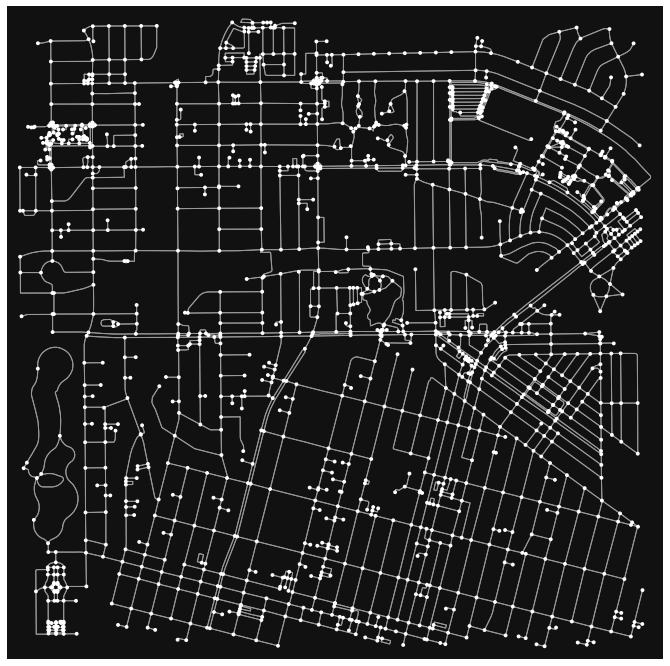

In [664]:
fig, ax = ox.plot_graph(G,figsize=(12,12))

In [665]:
G = ox.project_graph(G, to_crs='epsg:3857')

In [666]:
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

In [667]:
gdf_nodes.head()

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
17445327,4.033839e+06,-1.315200e+07,traffic_signals,4,-118.146421,34.037501,POINT (-13151999.403 4033838.580)
8414804812,4.033816e+06,-1.315203e+07,NaN,3,-118.146684,34.037336,POINT (-13152028.735 4033816.401)
8414804800,4.033858e+06,-1.315197e+07,NaN,3,-118.146197,34.037648,POINT (-13151974.467 4033858.327)
3643016816,4.033796e+06,-1.315196e+07,NaN,4,-118.146107,34.037181,POINT (-13151964.459 4033795.566)
8414804799,4.033863e+06,-1.315202e+07,NaN,3,-118.146602,34.037683,POINT (-13152019.540 4033863.055)


<AxesSubplot:>

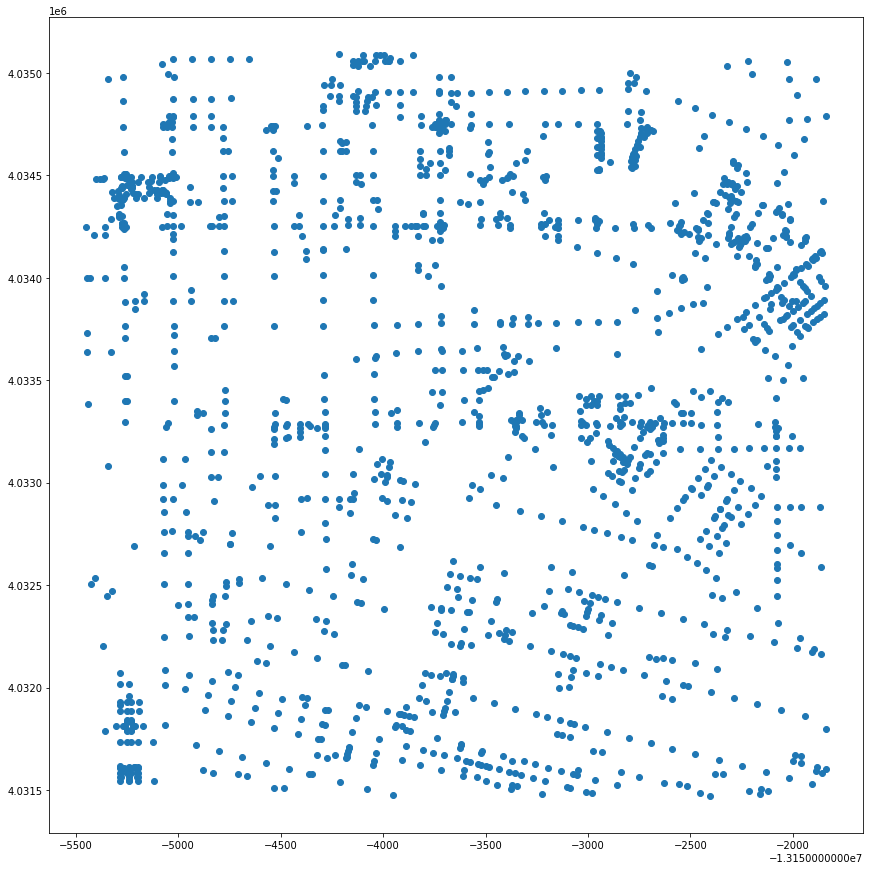

In [668]:
gdf_nodes.plot(figsize=(15,15))

In [669]:
gdf_edges.head()

osmid lanes                  name    highway  \
u          v          key                                                      
17445327   8414804812 0     397475166     7    Atlantic Boulevard    primary   
           8414804800 0     397479970     7    Atlantic Boulevard    primary   
           3643016816 0     397516716     5    West Reggin Street  secondary   
           8414804799 0    1036305858     5  Avenida Cesar Chavez  secondary   
8414804812 17445327   0     397475166     7    Atlantic Boulevard    primary   

                          maxspeed  oneway  length  \
u          v          key                            
17445327   8414804812 0     35 mph   False  30.439   
           8414804800 0     35 mph   False  26.329   
           3643016816 0        NaN   False  45.873   
           8414804799 0        NaN   False  26.236   
8414804812 17445327   0     35 mph   False  30.439   

                                                                    geometry  \
u          v          key                                                      
17445327   8414804812 0    LINESTRING (-13151999.403 4033838.580, -131520...   
           8414804800 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           3643016816 0    LINESTRING (-13151999.403 4033838.580, -131519...   
           8414804799 0    LINESTRING (-13151999.403 4033838.580, -131520...   
8414804812 17445327   0    LINESTRING (-13152028.735 4033816.401, -131519...   

                          access service  ref bridge tunnel  
u          v          key                                    
17445327   8414804812 0      NaN     NaN  NaN    NaN    NaN  
           8414804800 0      NaN     NaN  NaN    NaN    NaN  
           3643016816 0      NaN     NaN  NaN    NaN    NaN  
           8414804799 0      NaN     NaN  NaN    NaN    NaN  
8414804812 17445327   0      NaN     NaN  NaN    NaN    NaN

<AxesSubplot:>

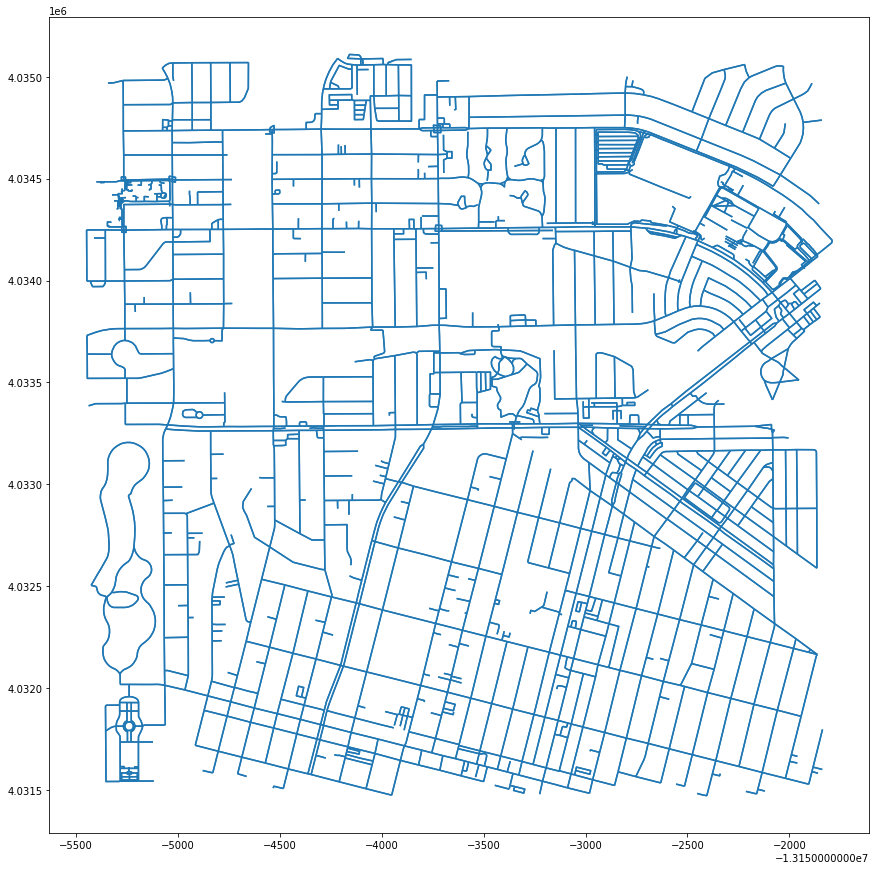

In [670]:
gdf_edges.plot(figsize=(15,15))

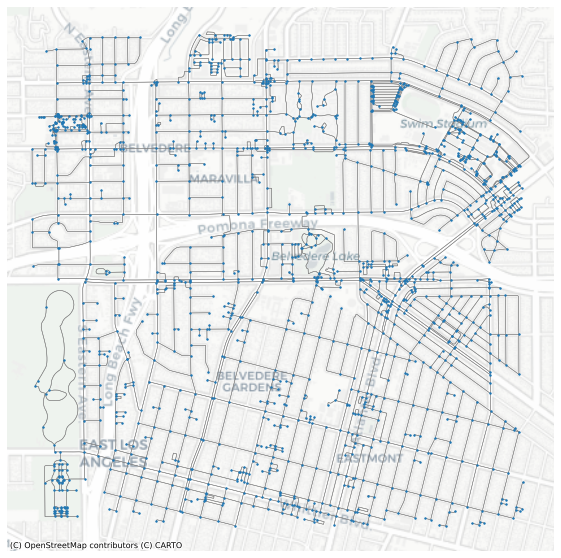

In [671]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)


# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [672]:
# get the bounding box coordinates
minx, miny, maxx, maxy = gdf_nodes.geometry.total_bounds
print(minx)
print(miny)
print(maxx)
print(maxy)

-13155448.347495379
4031471.857767747
-13151837.354721077
4035089.507649423


In [673]:
# calculate the centroid
centroid_x = (maxx-minx)/2 + minx
centroid_y = (maxy-miny)/2 + miny
print(centroid_x)
print(centroid_y)

-13153642.851108227
4033280.6827085847


In [674]:
# use osmnx's distance.nearest_nodes command to get the id for the nearest node
center_node1 = ox.distance.nearest_nodes(G,Y=centroid_y,X=centroid_x)
print('The id for the nearest node is ' + str(center_node1))

The id for the nearest node is 269612210


In [675]:
# what is this record?
gdf_nodes.loc[[center_node1]]

,y,x,highway,street_count,lon,lat,geometry
osmid,,,,,,,
269612210,4.033295e+06,-1.315361e+07,NaN,3,-118.160921,34.033453,POINT (-13153613.569 4033294.845)


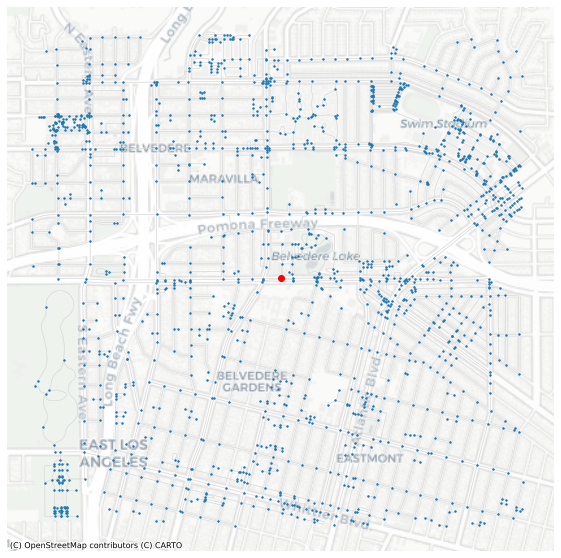

In [676]:
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(10,10))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gainsboro', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax, 
               markersize=2, 
               zorder=20)

# add the center node in red also to ax
gdf_nodes.loc[[center_node1]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron, zoom=14)

In [677]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel
u,v,key,,,,,,,,,,,,,
8777112349,8777112346,0,944024322,NaN,NaN,footway,NaN,False,2.903,"LINESTRING (-13155246.525 4034488.886, -131552...",NaN,NaN,NaN,NaN,NaN
122587747,3701838776,0,"[13330072, 13460074]",NaN,"[Sherbrook Avenue, Gladmar Street]",residential,NaN,False,278.930,"LINESTRING (-13152364.720 4033724.610, -131523...",NaN,NaN,NaN,NaN,NaN
122620567,122620564,0,162804731,NaN,East 4th Street,residential,NaN,False,88.506,"LINESTRING (-13153023.564 4032783.549, -131531...",NaN,NaN,NaN,NaN,NaN
8460924313,1746242082,0,911207070,NaN,NaN,service,NaN,False,22.782,"LINESTRING (-13153050.214 4032294.196, -131530...",customers,NaN,NaN,NaN,NaN
582842793,122797541,0,45766608,4,South Eastern Avenue,primary,40 mph,False,133.584,"LINESTRING (-13155065.843 4032086.114, -131550...",NaN,NaN,NaN,NaN,NaN


In [678]:
gdf_edges['walk_time'] = (gdf_edges['length']/meters_per_minute)

In [679]:
gdf_edges.sample(5)

,,,osmid,lanes,name,highway,maxspeed,oneway,length,geometry,access,service,ref,bridge,tunnel,walk_time
u,v,key,,,,,,,,,,,,,,
5544361540,5544361536,0,578719421,NaN,NaN,service,NaN,False,131.646,"LINESTRING (-13154211.410 4034940.367, -131541...",NaN,NaN,NaN,NaN,NaN,1.645575
1742549944,1742549948,0,"[397468216, 397468187]","[2, 3]",Arizona Avenue,secondary,NaN,False,192.727,"LINESTRING (-13154268.951 4031889.614, -131542...",NaN,NaN,NaN,NaN,NaN,2.409088
4872870980,4872870979,0,495547055,NaN,NaN,service,NaN,False,9.152,"LINESTRING (-13151950.233 4033958.017, -131519...",NaN,NaN,NaN,NaN,NaN,0.114400
3388016218,2032707326,0,13396698,NaN,Dorner Drive,residential,NaN,False,44.904,"LINESTRING (-13152540.927 4033996.572, -131525...",NaN,NaN,NaN,NaN,NaN,0.561300
269610961,2199149536,0,162804741,NaN,South McDonnell Avenue,residential,NaN,False,8.577,"LINESTRING (-13154285.482 4033285.738, -131542...",NaN,NaN,NaN,NaN,NaN,0.107213


In [680]:
# assign a color hex code for each trip time isochrone
iso_colors = ox.plot.get_colors(n=len(trip_times), 
                                cmap='plasma', 
                                start=0, 
                                return_hex=True)
print(trip_times)
print(iso_colors)

[10]
['#0d0887']


In [681]:
time_color = list(zip(trip_times, iso_colors))
time_color

[(10, '#0d0887')]

In [682]:
for time, color in list(time_color):

    # for each trip time, create an egograph of nodes that fall within that distance
    subgraph = nx.ego_graph(G, 269612210, radius=time)

    print('There are ' + str(len(subgraph.nodes())) + ' nodes within ' + str(time) + ' minutes ')
    
    # for each of those nodes, update the gdf_nodes dataframe and assign it with its associated distance color
    for node in subgraph.nodes():
        gdf_nodes.loc[node,'time'] = str(time) + ' mins'
        gdf_nodes.loc[node,'color'] = color

There are 271 nodes within 10 minutes 


In [683]:
gdf_nodes.sample(30)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1099754704,4.034560e+06,-1.315335e+07,NaN,1,-118.158545,34.042874,POINT (-13153349.107 4034560.438),NaN,NaN
1111294631,4.032918e+06,-1.315232e+07,NaN,4,-118.149307,34.030651,POINT (-13152320.648 4032918.409),NaN,NaN
6726320990,4.032025e+06,-1.315361e+07,NaN,1,-118.160876,34.024001,POINT (-13153608.581 4032025.230),NaN,NaN
123129289,4.032171e+06,-1.315444e+07,NaN,4,-118.168308,34.025086,POINT (-13154435.897 4032171.014),NaN,NaN
1743923280,4.031584e+06,-1.315528e+07,NaN,3,-118.175864,34.020713,POINT (-13155277.049 4031583.629),NaN,NaN
123232909,4.031601e+06,-1.315343e+07,NaN,3,-118.159295,34.020844,POINT (-13153432.596 4031601.210),NaN,NaN
6726347348,4.031529e+06,-1.315256e+07,NaN,1,-118.151420,34.020306,POINT (-13152555.933 4031528.898),NaN,NaN
8272139276,4.032842e+06,-1.315232e+07,NaN,4,-118.149261,34.030084,POINT (-13152315.550 4032842.301),NaN,NaN
122820039,4.033884e+06,-1.315502e+07,NaN,4,-118.173583,34.037842,POINT (-13155023.051 4033884.482),NaN,NaN


In [684]:
gdf_nodes['color'].fillna('#cccccc', inplace=True)

In [685]:
gdf_nodes.sample(5)

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
1746242091,4.032590e+06,-1.315318e+07,NaN,3,-118.157041,34.028203,POINT (-13153181.638 4032589.656),10 mins,#0d0887
589715452,4.031645e+06,-1.315391e+07,NaN,4,-118.163571,34.021171,POINT (-13153908.543 4031645.169),NaN,#cccccc
7072288125,4.034587e+06,-1.315279e+07,NaN,3,-118.153484,34.043075,POINT (-13152785.719 4034587.414),NaN,#cccccc
8411208594,4.033098e+06,-1.315283e+07,NaN,3,-118.153869,34.031991,POINT (-13152828.588 4033098.459),NaN,#cccccc
123477237,4.031484e+06,-1.315298e+07,NaN,3,-118.155236,34.019971,POINT (-13152980.662 4031483.972),NaN,#cccccc


<AxesSubplot:>

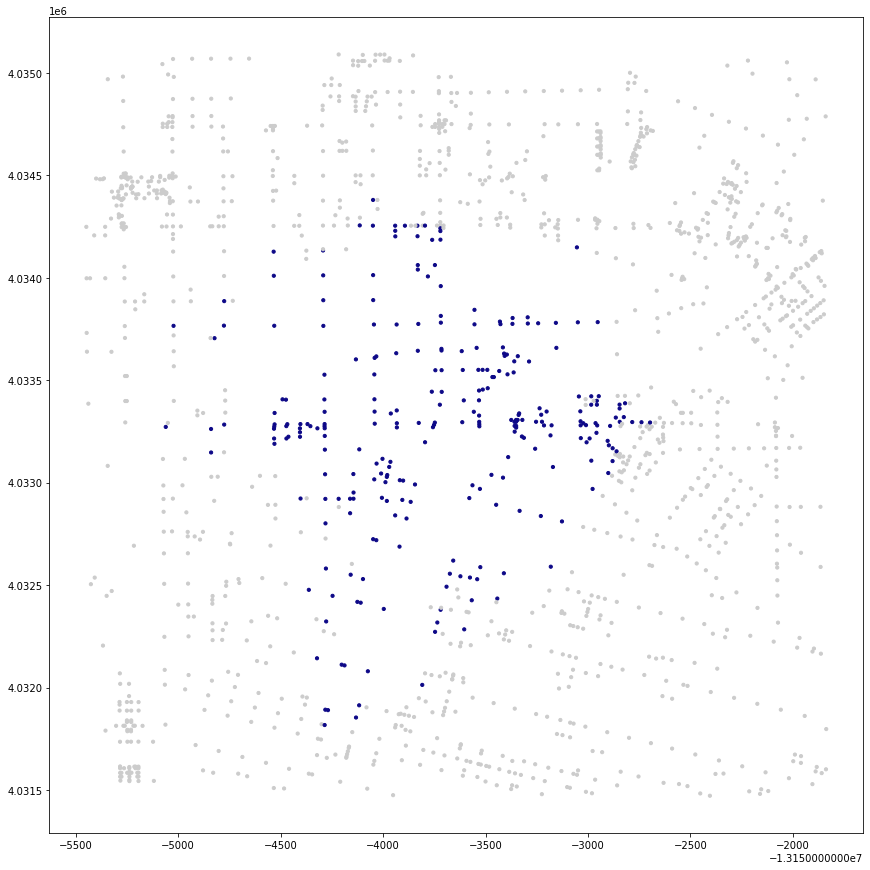

In [686]:
#plotting and taking a look at my nodes within the walkshed
gdf_nodes.plot(figsize=(15,15),
               color=gdf_nodes['color'],
               markersize=10)

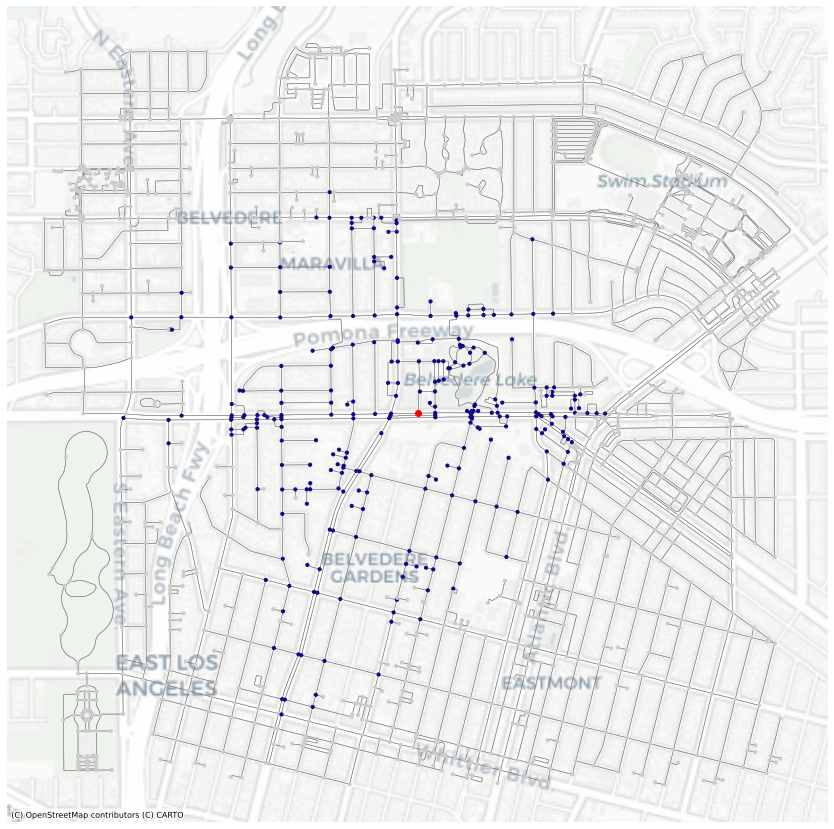

In [687]:
# a "full" map
# set up the subplot (single plot = ax)
fig, ax = plt.subplots(figsize=(15,15))

# add the edges to ax
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               edgecolor='gray', 
               zorder=10)

# add all nodes to ax
gdf_nodes.plot(ax=ax,
               color=gdf_nodes['color'],
               markersize=10, 
               zorder=20)

# marking the station site with a red dot. Grabbed the station's node from OpenStreet Maps
gdf_nodes.loc[[269612210]].plot(ax=ax,
                                  color='r', 
                                  zorder=30)

# no axis
ax.axis('off')

# add a basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Positron,zoom=14)

In [688]:
gdf_nodes[gdf_nodes['time']=='10 mins']

,y,x,highway,street_count,lon,lat,geometry,time,color
osmid,,,,,,,,,
6816488222,4.034241e+06,-1.315372e+07,NaN,4,-118.161882,34.040497,POINT (-13153720.558 4034241.067),10 mins,#0d0887
74673066,4.034127e+06,-1.315453e+07,traffic_signals,3,-118.169191,34.039649,POINT (-13154534.158 4034127.121),10 mins,#0d0887
6735157126,4.031892e+06,-1.315428e+07,NaN,3,-118.166926,34.023007,POINT (-13154282.009 4031891.776),10 mins,#0d0887
1742549940,4.031817e+06,-1.315429e+07,traffic_signals,4,-118.166954,34.022450,POINT (-13154285.181 4031816.938),10 mins,#0d0887
122584279,4.034009e+06,-1.315453e+07,NaN,3,-118.169183,34.038773,POINT (-13154533.324 4034009.495),10 mins,#0d0887
...,...,...,...,...,...,...,...,...,...
8361650777,4.033306e+06,-1.315332e+07,NaN,1,-118.158287,34.033536,POINT (-13153320.320 4033305.954),10 mins,#0d0887
8361650775,4.033306e+06,-1.315337e+07,NaN,1,-118.158774,34.033535,POINT (-13153374.566 4033305.806),10 mins,#0d0887
8361650779,4.033268e+06,-1.315335e+07,NaN,1,-118.158558,34.033256,POINT (-13153350.543 4033268.382),10 mins,#0d0887


In [689]:
#creating a new variable for 10 mins nodes
gdf_10 = gdf_nodes[gdf_nodes['time']=='10 mins']

<AxesSubplot:>

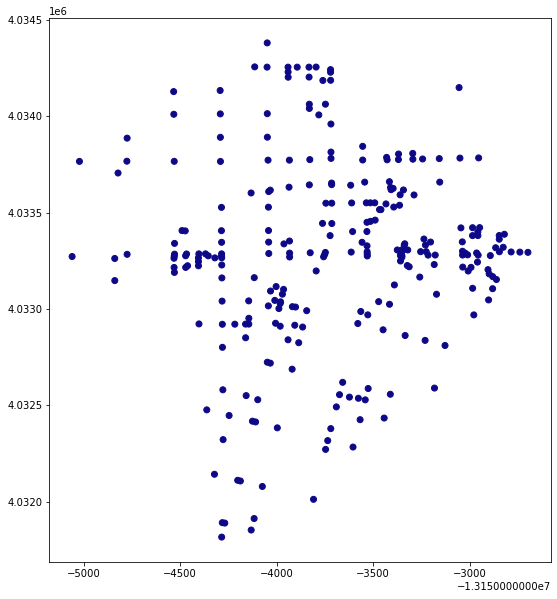

In [690]:
gdf_10.plot(figsize=(10,10),color=gdf_10.color)

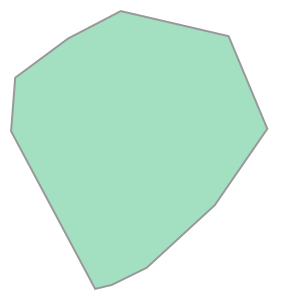

In [691]:
#creating our convex hull
gdf_10.unary_union.convex_hull

In [692]:
isochrones_civic = gdf_nodes.dissolve("time")
isochrones_civic

,geometry,y,x,highway,street_count,lon,lat,color
time,,,,,,,,
10 mins,"MULTIPOINT (-13155060.722 4033271.808, -131550...",4.034241e+06,-1.315372e+07,traffic_signals,4,-118.161882,34.040497,#0d0887


In [693]:
isochrones_civic = isochrones_civic.convex_hull.reset_index()
isochrones_civic

,time,0
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


In [694]:
isochrones_civic.columns=['time','geometry']
isochrones_civic

,time,geometry
0,10 mins,"POLYGON ((-13154285.181 4031816.938, -13155060..."


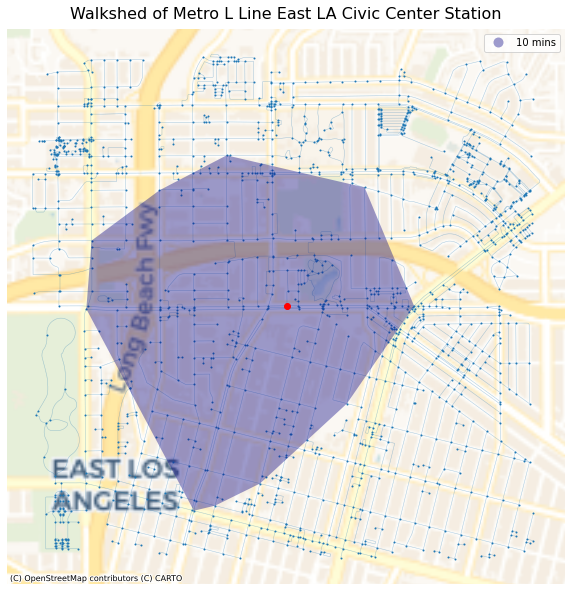

In [695]:
#plotting the convex hull on to the basemap

# set up the subplots
fig, ax = plt.subplots(figsize=(10,20))

# add the isochrones
isochrones_civic.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node1]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

# hide the axis
ax.axis('off')

# give it a title
ax.set_title('Walkshed of Metro L Line East LA Civic Center Station',fontsize=16,pad=10)

# add the basemap
ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=13)

In [696]:
civic = gdf[gdf["FIPS"].isin(['06037530400', 
                              '06037530301', 
                              '06037531603',
                              '06037531604',
                              '06037531504',
                              '06037531503',
                              '06037531000',
                              '06037530500']
                                    )
                     ]

In [697]:
civic.head()

,FIPS,Census Tract,11 Total Population,11 Total Foreign Born,11 Total Entered 2000 or later,11 Europe,11 Europe Entered 2000 or later,11 Asia,11 Asia Entered 2000 or later,11 Latin America,...,19 Other Central America,19 Other Central America Entered 2010 or later,19 South America,19 South America Entered 2010 or later,19 Other Areas,19 Other Areas Entered 2010 or later,% Change Foreign Born,region,station,geometry
180,06037530301,"Census Tract 5303.01, Los Angeles, CA",2389.0,1190.0,181.0,4.0,0.0,36.0,0.0,1150.0,...,54.0,0.0,9.0,0.0,0.0,0.0,-10.689068,East LA,East LA Civic Center,"MULTIPOLYGON (((-118.15978 34.02568, -118.1595..."
182,06037530400,"Census Tract 5304, Los Angeles, CA",3427.0,1015.0,85.0,0.0,0.0,274.0,16.0,715.0,...,161.0,0.0,14.0,0.0,0.0,0.0,4.837387,East LA,East LA Civic Center,"MULTIPOLYGON (((-118.16186 34.03384, -118.1617..."
183,06037530500,"Census Tract 5305, Los Angeles, CA",4555.0,1560.0,327.0,1.0,0.0,0.0,0.0,1557.0,...,181.0,18.0,0.0,0.0,12.0,0.0,6.515567,East LA,East LA Civic Center,"MULTIPOLYGON (((-118.16991 34.03369, -118.1698..."
191,06037531000,"Census Tract 5310, Los Angeles, CA",5219.0,2134.0,434.0,9.0,0.0,0.0,0.0,2124.0,...,135.0,0.0,9.0,0.0,0.0,0.0,-6.016665,East LA,East LA Civic Center,"MULTIPOLYGON (((-118.17866 34.03421, -118.1786..."
198,06037531503,"Census Tract 5315.03, Los Angeles, CA",3651.0,1826.0,600.0,0.0,0.0,0.0,0.0,1826.0,...,109.0,0.0,0.0,0.0,0.0,0.0,-15.651181,East LA,East LA Civic Center,"MULTIPOLYGON (((-118.18047 34.03340, -118.1804..."


<AxesSubplot:>

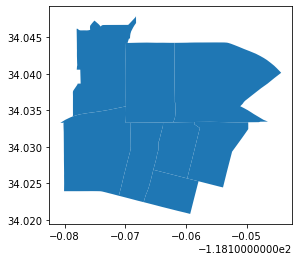

In [698]:
civic.plot()

There's our census tracts. Let's add some statistics to these census tracts. 

<AxesSubplot:>

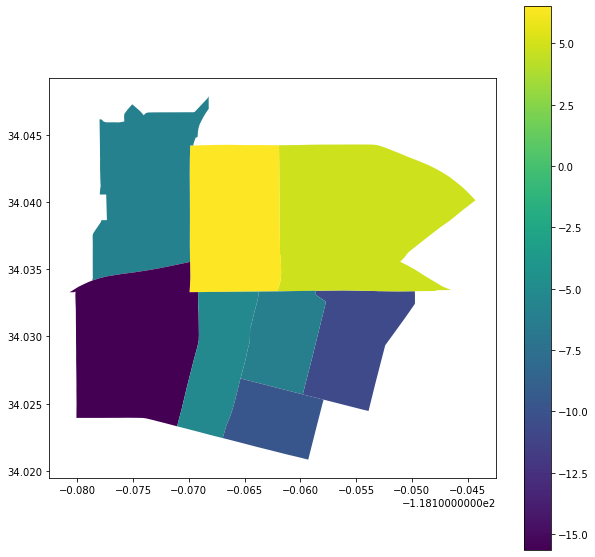

In [699]:
civic.plot(figsize=(10,10),
        column='% Change Foreign Born',
        legend=True)

In [700]:
civic_web_mercator = civic.to_crs(epsg=3857)

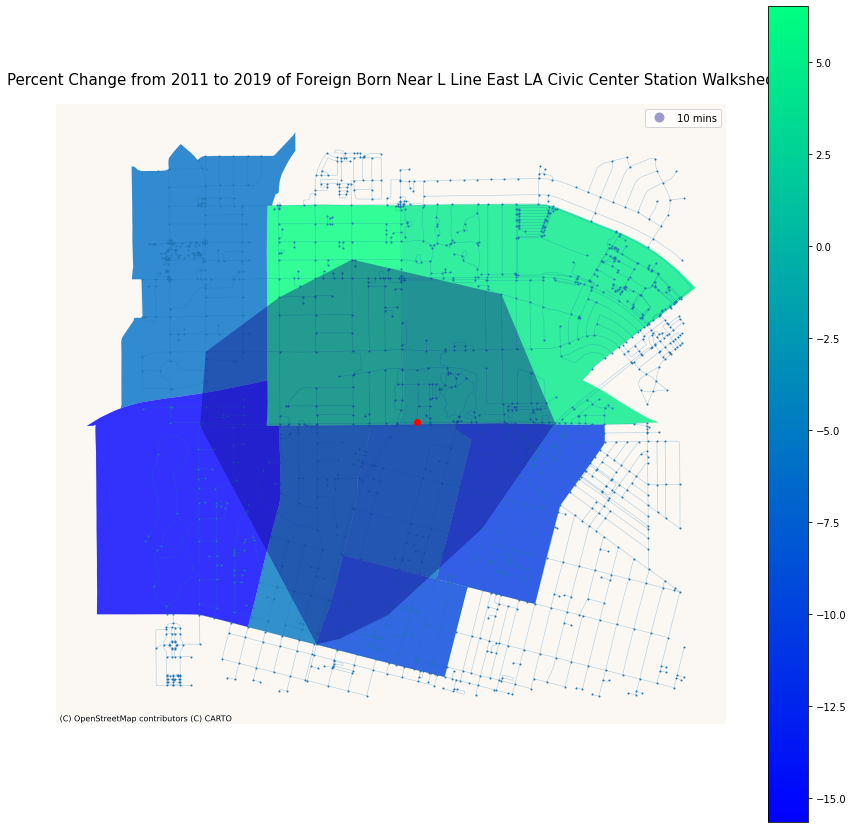

In [701]:
fig, ax = plt.subplots(figsize=(15, 15))
 
civic_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, legend=True,
                    alpha=0.8,
                    cmap="winter")

# add the isochrones
isochrones_civic.plot(alpha=0.4, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node1]].plot(ax=ax,color='r', zorder=30)

# add all nodes
gdf_nodes.plot(ax=ax, 
               markersize=1, 
               zorder=10)

# add the edges
gdf_edges.plot(ax=ax,
               linewidth=0.5,
               alpha=0.2,
               zorder=10)

ax.axis('off')

ax.set_title('Percent Change from 2011 to 2019 of Foreign Born Near L Line East LA Civic Center Station Walkshed',fontsize=15, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager, zoom=3)

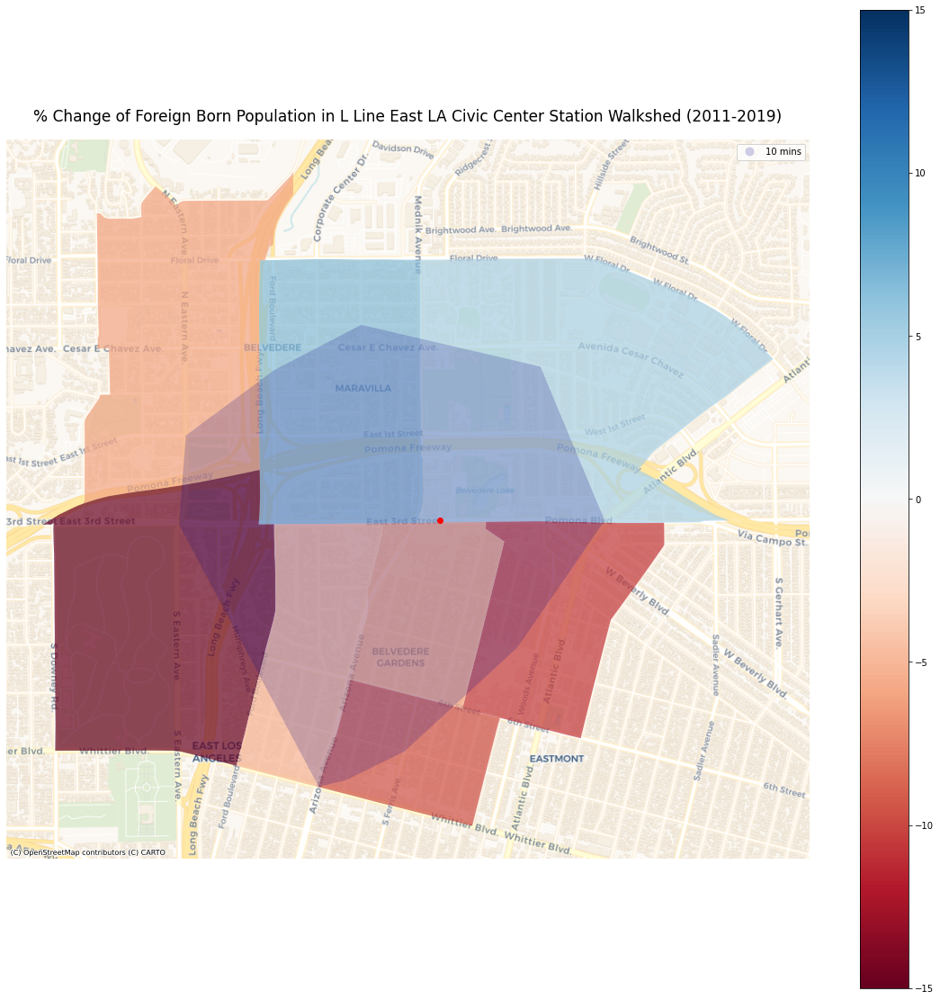

In [702]:
# adding a new max, min, color and deleting nodes and edges

fig, ax = plt.subplots(figsize=(20, 20))
 
civic_web_mercator.plot(
                    column='% Change Foreign Born',
                    ax=ax, 
                    legend=True,
                    vmin=-15,
                    vmax=15,
                    alpha=0.7,
                    cmap="RdBu")


# add the isochrones
isochrones_civic.plot(alpha=0.2, 
                ax=ax, 
                column='time', 
                cmap='plasma', 
                legend=True,
                zorder=20)

# add the center node in red
gdf_nodes.loc[[center_node1]].plot(ax=ax,color='r', zorder=30)

ax.axis('off')

ax.set_title('% Change of Foreign Born Population in L Line East LA Civic Center Station Walkshed (2011-2019)',fontsize=17, pad=20)

ctx.add_basemap(ax,source=ctx.providers.CartoDB.Voyager)

plt.savefig("CivicStation_ForeignBorn.jpg")